In [1]:
import anndata as ad
import numpy as np
import pandas as pd
import scanpy as sc
import scrublet as scr
import matplotlib.pylab as plt
from matplotlib.pyplot import rc_context
import seaborn as sns
import gseapy as gp

sc.settings.verbosity = 3             # verbosity: errors (0), warnings (1), info (2), hints (3)
sc.logging.print_header()
sc.settings.set_figure_params(dpi=120, facecolor='white')

scanpy==1.8.2 anndata==0.7.8 umap==0.5.2 numpy==1.20.3 scipy==1.7.3 pandas==1.4.1 scikit-learn==1.0.2 statsmodels==0.12.2 python-igraph==0.9.9 pynndescent==0.5.6


In [2]:
AN26 = sc.read_h5ad('/store/Projects/pantovski/IL10/Old_naive/data/Ambient_RNA_Cleaned/AN26_cleaned.h5ad')
AN27 = sc.read_h5ad('/store/Projects/pantovski/IL10/Old_naive/data/Ambient_RNA_Cleaned/AN27_cleaned.h5ad')
AN27b = sc.read_h5ad('/store/Projects/pantovski/IL10/Old_naive/data/Ambient_RNA_Cleaned/AN27b_cleaned.h5ad')
AN28 = sc.read_h5ad('/store/Projects/pantovski/IL10/Old_naive/data/Ambient_RNA_Cleaned/AN28_cleaned.h5ad')
O1 = sc.read_h5ad('/store/Projects/pantovski/IL10/Old_naive/data/Ambient_RNA_Cleaned/O1_cleaned.h5ad')
O2 = sc.read_h5ad('/store/Projects/pantovski/IL10/Old_naive/data/Ambient_RNA_Cleaned/O2_cleaned.h5ad')
O3 = sc.read_h5ad('/store/Projects/pantovski/IL10/Old_naive/data/Ambient_RNA_Cleaned/O3_cleaned.h5ad')

AN26.var_names_make_unique()
AN27.var_names_make_unique()
AN27b.var_names_make_unique()
AN28.var_names_make_unique()
O1.var_names_make_unique()
O2.var_names_make_unique()
O3.var_names_make_unique()

AN26.obs.index = AN26.obs.index.map(lambda x: x.split('-')[0]+'-1')
AN27.obs.index = AN27.obs.index.map(lambda x: x.split('-')[0]+'-2')
AN27b.obs.index = AN27b.obs.index.map(lambda x: x.split('-')[0]+'-3')
AN28.obs.index = AN28.obs.index.map(lambda x: x.split('-')[0]+'-4')
O1.obs.index = O1.obs.index.map(lambda x: x.split('-')[0]+'-5')
O2.obs.index = O2.obs.index.map(lambda x: x.split('-')[0]+'-6')
O3.obs.index = O3.obs.index.map(lambda x: x.split('-')[0]+'-7')

AN20 = sc.read_h5ad('/store/Projects/pantovski/IL10/Old_transplanted/data/Ambient_RNA_Cleaned/AN20_cleaned.h5ad')
AN21 = sc.read_h5ad('/store/Projects/pantovski/IL10/Old_transplanted/data/Ambient_RNA_Cleaned/AN21_cleaned.h5ad')
AN22 = sc.read_h5ad('/store/Projects/pantovski/IL10/Old_transplanted/data/Ambient_RNA_Cleaned/AN22_cleaned.h5ad')

AN20.var_names_make_unique()
AN21.var_names_make_unique()
AN22.var_names_make_unique()

AN20.obs.index = AN20.obs.index.map(lambda x: x.split('-')[0]+'-10')
AN21.obs.index = AN21.obs.index.map(lambda x: x.split('-')[0]+'-11')
AN22.obs.index = AN22.obs.index.map(lambda x: x.split('-')[0]+'-12')

Old_combined = ad.concat([AN26, AN27, AN27b, AN28, O1, O2, O3, AN20, AN21, AN22], label="Sample", keys=["AN26", "AN27", "AN27b", "AN28", "O1", "O2", "O3", "AN20", "AN21", "AN22"], join="inner")

In [3]:
Old_combined.obs.loc[Old_combined.obs.Sample.isin(['AN26', 'AN27', 'AN27b', 'AN28', 'O1', 'O2', 'O3']), 'Type'] = 'Old_naive'
Old_combined.obs.loc[Old_combined.obs.Sample.isin(['AN20', 'AN21', 'AN22']), 'Type'] = 'Old_transplanted'

In [4]:
Old_combined.obs.loc[Old_combined.obs.Sample.isin(['AN26', 'AN27', 'AN28']), 'batch'] = 'AN26-28'
Old_combined.obs.loc[Old_combined.obs.Sample.isin(['AN27b']), 'batch'] = 'AN27b'
Old_combined.obs.loc[Old_combined.obs.Sample.isin(['O1']), 'batch'] = 'O1'
Old_combined.obs.loc[Old_combined.obs.Sample.isin(['O2']), 'batch'] = 'O2'
Old_combined.obs.loc[Old_combined.obs.Sample.isin(['O3']), 'batch'] = 'O3'
Old_combined.obs.loc[Old_combined.obs.Sample.isin(['AN20']), 'batch'] = 'AN20'
Old_combined.obs.loc[Old_combined.obs.Sample.isin(['AN21', 'AN22']), 'batch'] = 'AN21-22'

In [5]:
adata_Il10RN = Old_combined[(Old_combined.to_df()['Il10ra'] == 0), :]
adata_Il10 = adata_Il10RN[(adata_Il10RN.to_df()['Il10'] > 0), :]
adata_Il10N = Old_combined[(Old_combined.to_df()['Il10'] == 0), :]
adata_Il10ra = adata_Il10N[(adata_Il10N.to_df()['Il10ra'] > 0), :]
adata_DN = adata_Il10N[(adata_Il10N.to_df()['Il10ra'] == 0), :]
Old_combined = ad.concat([adata_Il10, adata_Il10ra, adata_DN], label="IL10", keys=["IL10_Old", "IL10ra_Old", "DN_Old"])

In [6]:
Old_combined.obs

,orig.ident,nCount_RNA,nFeature_RNA,Sample,Type,batch,IL10
AGAACCTGTTGCCGCA-1,0,20726.745348,5175,AN26,Old_naive,AN26-28,IL10_Old
CATTCATCATGAATCC-1,0,15015.149445,4614,AN26,Old_naive,AN26-28,IL10_Old
CGCAGGTCAAATCGGG-1,0,4980.186045,2187,AN26,Old_naive,AN26-28,IL10_Old
CGCCATTTCAGGAGAC-1,0,5624.356475,2228,AN26,Old_naive,AN26-28,IL10_Old
CTCCCAAGTCTCCTGT-1,0,23771.465459,5845,AN26,Old_naive,AN26-28,IL10_Old
...,...,...,...,...,...,...,...
TTTGGTTGTGGAACCA-12,0,23838.578896,5577,AN22,Old_transplanted,AN21-22,DN_Old
TTTGGTTTCGATGCAT-12,0,11900.146842,3421,AN22,Old_transplanted,AN21-22,DN_Old
TTTGGTTTCGGAGTGA-12,0,4779.173256,1535,AN22,Old_transplanted,AN21-22,DN_Old
TTTGTTGAGGTTGTTC-12,0,9013.997249,2933,AN22,Old_transplanted,AN21-22,DN_Old


normalizing counts per cell
    finished (0:00:01)


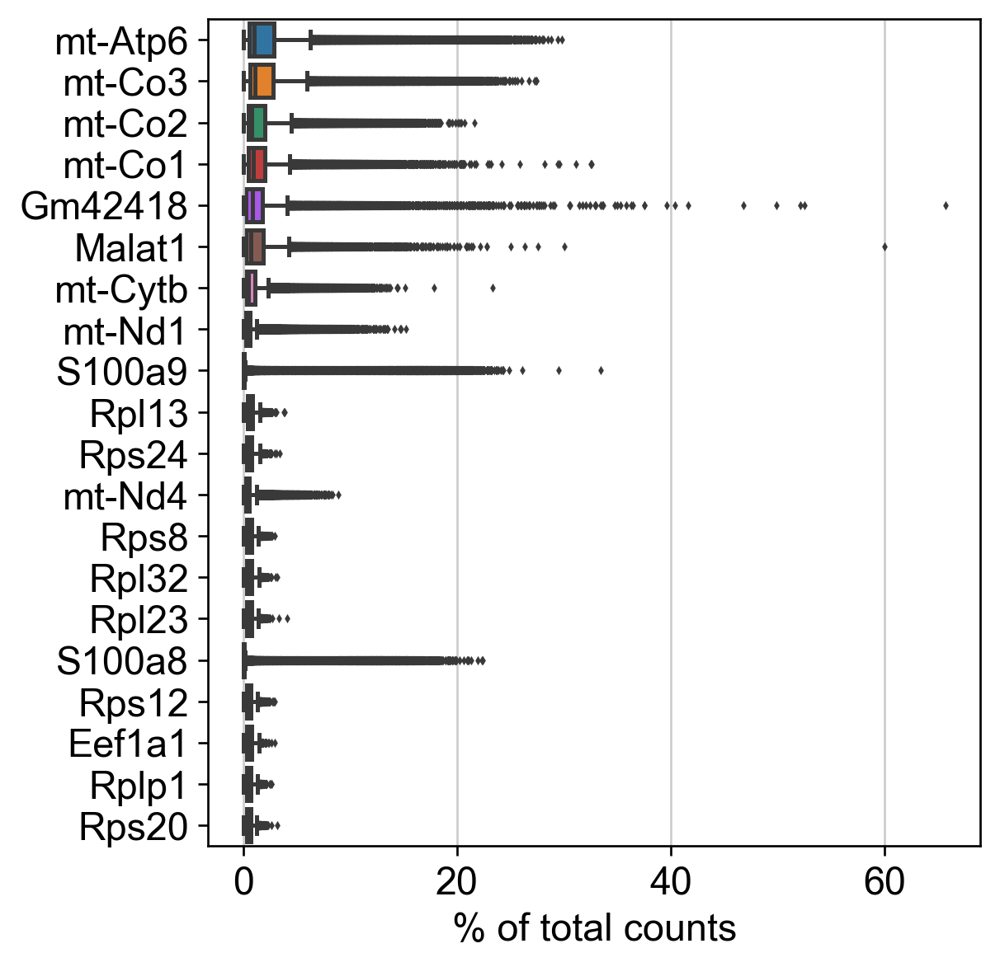

In [7]:
sc.pl.highest_expr_genes(Old_combined, n_top=20)

/home/LULAB/pantovski/.conda/envs/general/lib/python3.8/site-packages/anndata/_core/anndata.py:1228: FutureWarning: The `inplace` parameter in pandas.Categorical.reorder_categories is deprecated and will be removed in a future version. Reordering categories will always return a new Categorical object.
  c.reorder_categories(natsorted(c.categories), inplace=True)
... storing 'Type' as categorical
/home/LULAB/pantovski/.conda/envs/general/lib/python3.8/site-packages/anndata/_core/anndata.py:1228: FutureWarning: The `inplace` parameter in pandas.Categorical.reorder_categories is deprecated and will be removed in a future version. Reordering categories will always return a new Categorical object.
  c.reorder_categories(natsorted(c.categories), inplace=True)
... storing 'batch' as categorical


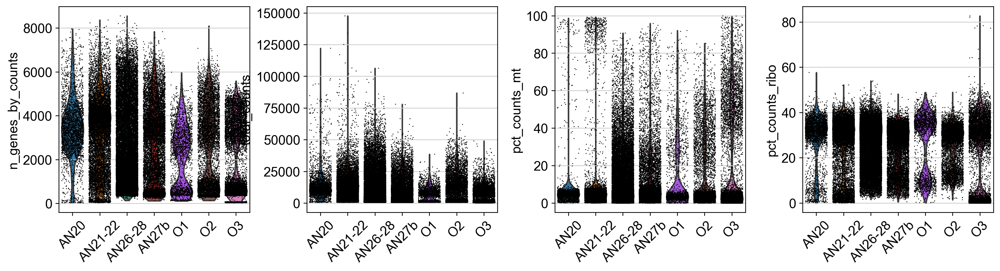

In [8]:
# mitochondrial genes
Old_combined.var['mt'] = Old_combined.var_names.str.startswith('mt-') 
# ribosomal genes
Old_combined.var['ribo'] = Old_combined.var_names.str.startswith(("Rps","Rpl"))

sc.pp.calculate_qc_metrics(Old_combined, qc_vars=['mt','ribo'], percent_top=None, log1p=False, inplace=True)

# A violin plot of some of the computed quality measures:
#     the number of genes expressed in the count matrix
#     the total counts per cell
#     the percentage of counts in mitochondrial genes
#     the percentage of counts in ribosomal genes
sc.pl.violin(Old_combined, ['n_genes_by_counts', 'total_counts', 'pct_counts_mt','pct_counts_ribo'], jitter=0.4, groupby = 'batch', rotation= 45)

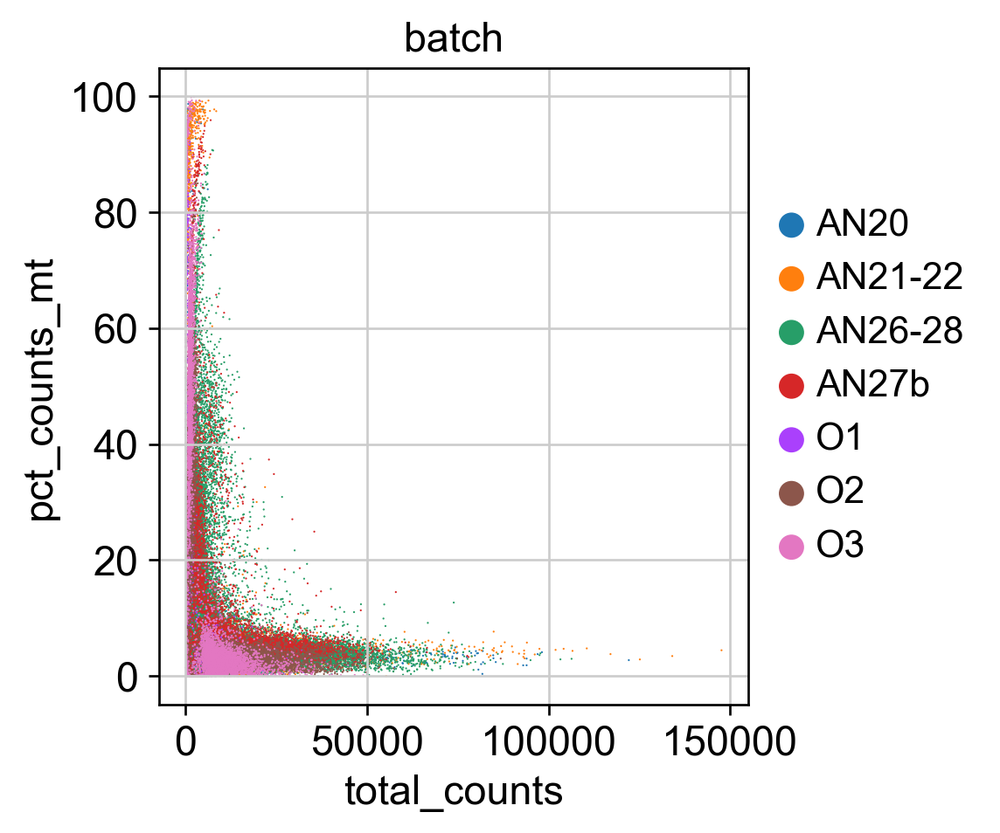

In [9]:
sc.pl.scatter(Old_combined, x='total_counts', y='pct_counts_mt', color='batch')

In [10]:
#Basic filtering:
sc.pp.filter_cells(Old_combined, min_genes=200)
sc.pp.filter_genes(Old_combined, min_cells=3)

filtered out 1054 cells that have less than 200 genes expressed
filtered out 10105 genes that are detected in less than 3 cells


In [11]:
Old_combined.shape

(66828, 22180)

In [12]:
# Remove cells that have too many mitochondrial genes expressed or too little ribosomal genes expressed:
Old_combined = Old_combined[Old_combined.obs.pct_counts_mt < 10, :]
Old_combined = Old_combined[Old_combined.obs.pct_counts_ribo > 5, :]

In [13]:
Old_combined.shape

(47654, 22180)

Trying to set attribute `.var` of view, copying.


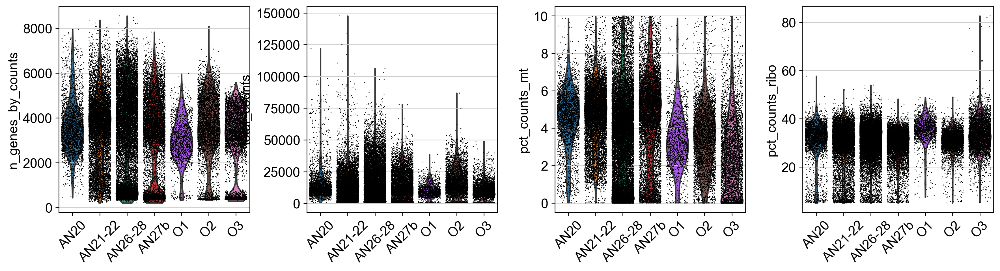

In [14]:
# mitochondrial genes
Old_combined.var['mt'] = Old_combined.var_names.str.startswith('mt-') 
# ribosomal genes
Old_combined.var['ribo'] = Old_combined.var_names.str.startswith(("Rps","Rpl"))

sc.pp.calculate_qc_metrics(Old_combined, qc_vars=['mt','ribo'], percent_top=None, log1p=False, inplace=True)

sc.pl.violin(Old_combined, ['n_genes_by_counts', 'total_counts', 'pct_counts_mt','pct_counts_ribo'], jitter=0.4, groupby = 'batch', rotation= 45)

In [15]:
np.median(Old_combined.obs.n_genes_by_counts)

3416.5

In [16]:
from statsmodels import robust
robust.mad(Old_combined.obs.n_genes_by_counts)

1855.476676459761

In [17]:
# Old_combined = Old_combined[Old_combined.obs.n_genes_by_counts > 1000, :]

In [18]:
# As the level of expression of mitochondrial genes and Malat1 are judged as mainly technical, it can be wise to remove them from the dataset bofore any further analysis.
malat1 = Old_combined.var_names.str.startswith('Malat1')
Gm42418 = Old_combined.var_names.str.startswith('Gm42418')
mito_genes = Old_combined.var_names.str.startswith('mt-')

remove = np.add(mito_genes, malat1)
remove = np.add(remove, Gm42418)

keep = np.invert(remove)

Old_combined = Old_combined[:,keep]

In [19]:
Old_combined.shape

(47654, 22165)

Preprocessing...
Simulating doublets...
Embedding transcriptomes using PCA...
Calculating doublet scores...


Trying to set attribute `.obs` of view, copying.


Automatically set threshold at doublet score = 0.89
Detected doublet rate = 0.0%
Estimated detectable doublet fraction = 0.5%
Overall doublet rate:
	Expected   = 10.0%
	Estimated  = 0.8%
Elapsed time: 89.7 seconds


(<Figure size 960x360 with 2 Axes>,
 array([<AxesSubplot:title={'center':'Observed transcriptomes'}, xlabel='Doublet score', ylabel='Prob. density'>,
        <AxesSubplot:title={'center':'Simulated doublets'}, xlabel='Doublet score', ylabel='Prob. density'>],
       dtype=object))

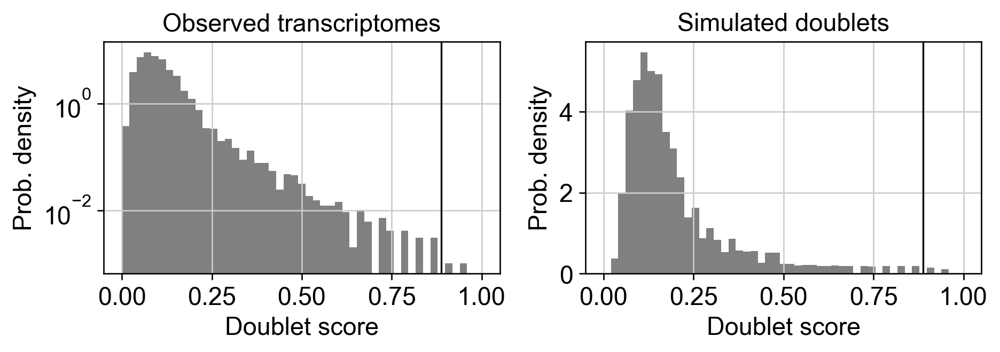

In [20]:
# Predict doublets
scrub = scr.Scrublet(Old_combined.X)
Old_combined.obs['doublet_scores'], Old_combined.obs['predicted_doublets'] = scrub.scrub_doublets()
scrub.plot_histogram()

In [21]:
sum(Old_combined.obs['predicted_doublets'])

2

In [22]:
# add in column with singlet/doublet instead of True/False
Old_combined.obs['doublet_info'] = Old_combined.obs["predicted_doublets"].astype(str)
Old_combined = Old_combined[Old_combined.obs['doublet_info'] == 'False',:]

In [23]:
Old_combined.shape

(47652, 22165)

In [24]:
Old_combined.obs.pop('doublet_info')
Old_combined.obs.pop('doublet_scores')
Old_combined.obs.pop('predicted_doublets')

AGAACCTGTTGCCGCA-1     False
CATTCATCATGAATCC-1     False
CTCCCAAGTCTCCTGT-1     False
GCAGCTGCAACCGTGC-1     False
TAGGTTGCAATGGGTG-1     False
                       ...  
TTTGGTTGTGGAACCA-12    False
TTTGGTTTCGATGCAT-12    False
TTTGGTTTCGGAGTGA-12    False
TTTGTTGAGGTTGTTC-12    False
TTTGTTGTCACTCGAA-12    False
Name: predicted_doublets, Length: 47652, dtype: bool

In [25]:
# Save the result.
Old_combined.write('/store/Projects/pantovski/IL10/Combined/write/Ambient_RNA_Cleaned/Old_2_UMI_5_percent_nonlognorm.h5ad')

In [26]:
import anndata as ad
import numpy as np
import pandas as pd
import scanpy as sc
import scrublet as scr
import matplotlib.pylab as plt
from matplotlib.pyplot import rc_context
import seaborn as sns
import gseapy as gp

sc.settings.verbosity = 3             # verbosity: errors (0), warnings (1), info (2), hints (3)
sc.logging.print_header()
sc.settings.set_figure_params(dpi=120, facecolor='white')

scanpy==1.8.2 anndata==0.7.8 umap==0.5.2 numpy==1.20.3 scipy==1.7.3 pandas==1.4.1 scikit-learn==1.0.2 statsmodels==0.12.2 python-igraph==0.9.9 pynndescent==0.5.6


In [27]:
Old_combined = sc.read_h5ad('/store/Projects/pantovski/IL10/Combined/write/Ambient_RNA_Cleaned/Old_2_UMI_5_percent_nonlognorm.h5ad')

In [28]:
Old_combined_2_UMI_5_percent = Old_combined[:, ((Old_combined.X > 2).sum(axis=0) / Old_combined.shape[0] ) > 0.05]

In [29]:
# Total-count normalize (library-size correct) the data matrix X to 10,000 reads per cell, so that counts become comparable among cells.
sc.pp.normalize_total(Old_combined, target_sum=1e4)

# Logarithmize the data:
sc.pp.log1p(Old_combined)

normalizing counts per cell
    finished (0:00:00)


extracting highly variable genes
    finished (0:00:03)
--> added
    'highly_variable', boolean vector (adata.var)
    'means', float vector (adata.var)
    'dispersions', float vector (adata.var)
    'dispersions_norm', float vector (adata.var)


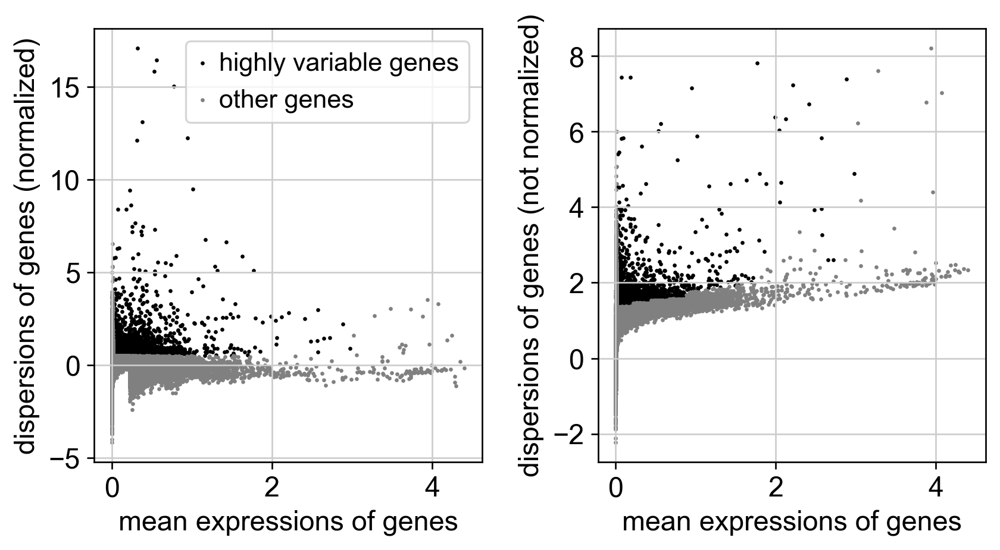

In [30]:
# Identify highly-variable genes.
sc.pp.highly_variable_genes(Old_combined, min_mean=0.0125, max_mean=3, min_disp=0.5)

sc.pl.highly_variable_genes(Old_combined)

In [31]:
# Actually do the filtering
Old_combined_2_UMI_5_percent_regress = Old_combined[:, Old_combined_2_UMI_5_percent.var.index]

Old_combined_2_UMI_5_percent_regress.raw = Old_combined

# Regress out effects of total counts per cell and the percentage of mitochondrial genes expressed. Scale the data to unit variance.
sc.pp.regress_out(Old_combined_2_UMI_5_percent_regress, ['total_counts', 'pct_counts_mt'])

regressing out ['total_counts', 'pct_counts_mt']
    sparse input is densified and may lead to high memory use


/home/LULAB/pantovski/.conda/envs/general/lib/python3.8/site-packages/statsmodels/tsa/base/tsa_model.py:7: FutureWarning: pandas.Int64Index is deprecated and will be removed from pandas in a future version. Use pandas.Index with the appropriate dtype instead.
  from pandas import (to_datetime, Int64Index, DatetimeIndex, Period,
/home/LULAB/pantovski/.conda/envs/general/lib/python3.8/site-packages/statsmodels/tsa/base/tsa_model.py:7: FutureWarning: pandas.Float64Index is deprecated and will be removed from pandas in a future version. Use pandas.Index with the appropriate dtype instead.
  from pandas import (to_datetime, Int64Index, DatetimeIndex, Period,


    finished (0:01:31)


In [32]:
Old_combined_2_UMI_5_percent_regress

AnnData object with n_obs × n_vars = 47652 × 3625
    obs: 'orig.ident', 'nCount_RNA', 'nFeature_RNA', 'Sample', 'Type', 'batch', 'IL10', 'n_genes_by_counts', 'total_counts', 'total_counts_mt', 'pct_counts_mt', 'total_counts_ribo', 'pct_counts_ribo', 'n_genes'
    var: 'mt', 'ribo', 'n_cells_by_counts', 'mean_counts', 'pct_dropout_by_counts', 'total_counts', 'n_cells', 'highly_variable', 'means', 'dispersions', 'dispersions_norm'
    uns: 'batch_colors', 'log1p', 'hvg'

In [33]:
Old_combined_2_UMI_5_percent_regress_combat = Old_combined_2_UMI_5_percent_regress

# BATCH CORRECTION USING ComBat
# run combat
sc.pp.combat(Old_combined_2_UMI_5_percent_regress_combat, key='batch')

Standardizing Data across genes.

Found 7 batches

Found 0 numerical variables:
	

Fitting L/S model and finding priors

Finding parametric adjustments

Adjusting data



In [34]:
# Save the result.
Old_combined_2_UMI_5_percent_regress_combat.write('/store/Projects/pantovski/IL10/Combined/write/Ambient_RNA_Cleaned/Old_2_UMI_5_percent_Combat_raw_SingleR_lognorm_raw_SingleR.h5ad')

In [35]:
# PCA, TSNE, UMAP and Clustering

In [37]:
Old_combined_2_UMI_5_percent_regress_combat = sc.read_h5ad('/store/Projects/pantovski/IL10/Combined/write/Ambient_RNA_Cleaned/Old_2_UMI_5_percent_Combat_raw_SingleR_lognorm_raw_SingleR.h5ad')
Old_combined_2_UMI_5_percent_regress_combat.raw = Old_combined_2_UMI_5_percent_regress_combat

df = pd.read_csv("/store/Projects/pantovski/IL10/Combined/write/Ambient_RNA_Cleaned/Old_2_UMI_5_percent_Combat_raw_SingleR_cell_types.csv", index_col=0)
labels = df['labels']
Old_combined_2_UMI_5_percent_regress_combat.obs['cell_type'] = labels
pd.crosstab(index=Old_combined_2_UMI_5_percent_regress_combat.obs.Sample, columns=Old_combined_2_UMI_5_percent_regress_combat.obs.cell_type)

cell_type,CLP,CMP,Flk2n,Flk2p,GMP,HSC,MEP
Sample,,,,,,,
AN26,95,2800,916,243,2062,698,577
AN27,120,154,240,82,446,609,37
AN27b,541,1535,784,427,2254,2281,244
AN28,440,2664,623,563,2489,1040,198
O1,42,327,221,55,85,601,30
O2,79,1159,498,198,1517,301,298
O3,326,1127,855,249,264,1309,486
AN20,76,26,84,3,347,2064,152
AN21,325,428,210,35,756,3603,255


In [38]:
Old_HSC = Old_combined_2_UMI_5_percent_regress_combat[Old_combined_2_UMI_5_percent_regress_combat.obs.cell_type == 'HSC']
pd.crosstab(index=Old_HSC.obs.Sample, columns=Old_HSC.obs.IL10)

IL10,IL10_Old,IL10ra_Old,DN_Old
Sample,,,
AN26,1,89,608
AN27,1,22,586
AN27b,3,83,2195
AN28,1,36,1003
O1,0,24,577
O2,1,25,275
O3,2,35,1272
AN20,7,305,1752
AN21,8,367,3228


In [39]:
# Scale each gene to unit variance. Clip values exceeding standard deviation 10.
sc.pp.scale(Old_combined_2_UMI_5_percent_regress_combat, max_value=10)

computing PCA
    on highly variable genes
    with n_comps=50
    finished (0:00:03)


/home/LULAB/pantovski/.conda/envs/general/lib/python3.8/site-packages/anndata/_core/anndata.py:1228: FutureWarning: The `inplace` parameter in pandas.Categorical.reorder_categories is deprecated and will be removed in a future version. Reordering categories will always return a new Categorical object.
  c.reorder_categories(natsorted(c.categories), inplace=True)
... storing 'cell_type' as categorical


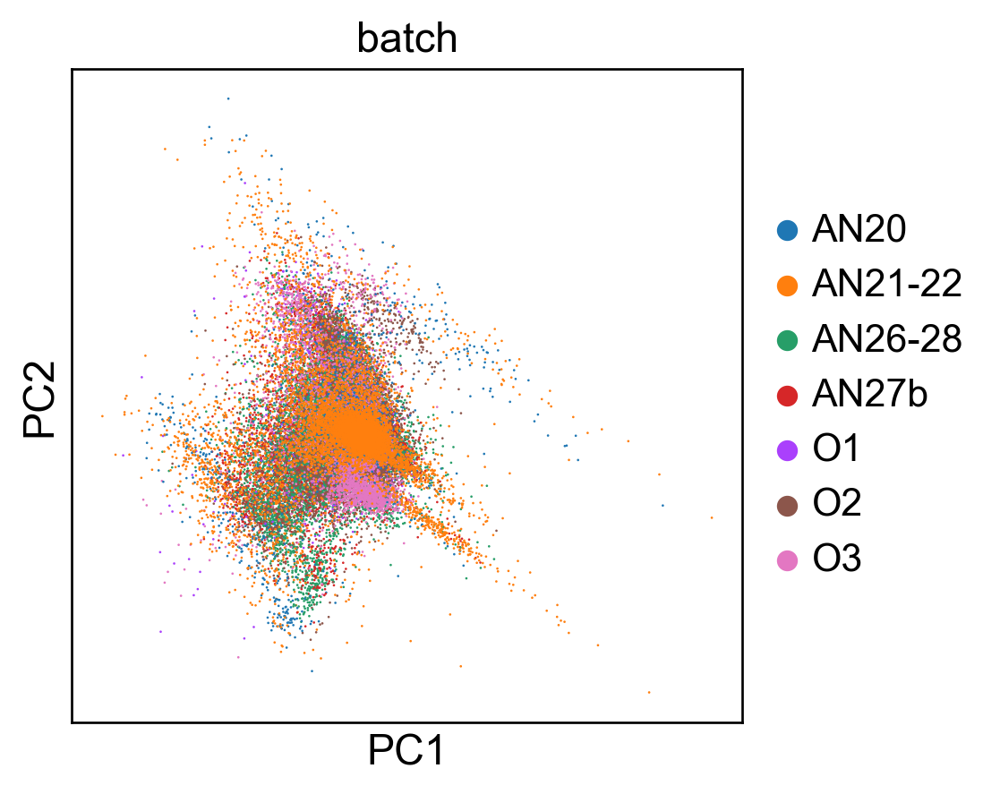

In [40]:
# Principal component analysis

# Reduce the dimensionality of the data by running principal component analysis (PCA), which reveals the main axes of variation and denoises the data.
sc.tl.pca(Old_combined_2_UMI_5_percent_regress_combat, svd_solver='arpack')

# We can make a scatter plot in the PCA coordinates, but we will not use that later on.
sc.pl.pca(Old_combined_2_UMI_5_percent_regress_combat, color='batch')

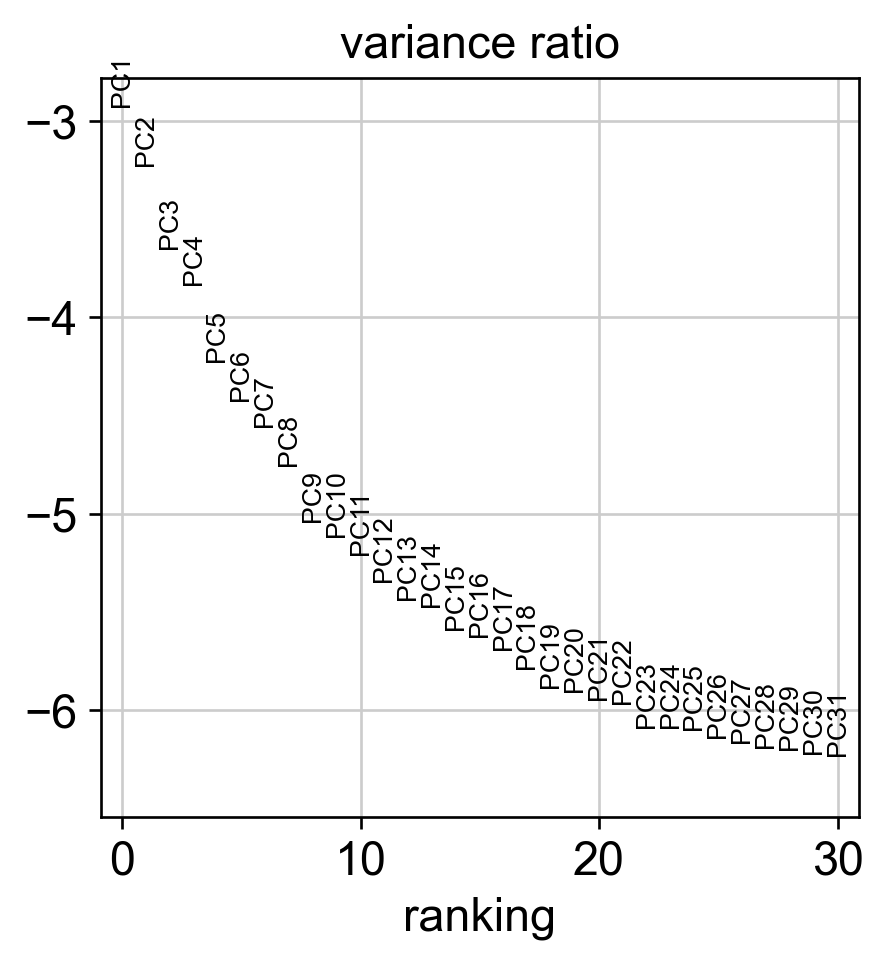

In [41]:
# Let us inspect the contribution of single PCs to the total variance in the data. This gives us information about how many PCs we should consider in order to compute the neighborhood relations of cells, e.g. used in the clustering function sc.tl.louvain() or tSNE sc.tl.tsne(). In our experience, often a rough estimate of the number of PCs does fine.
sc.pl.pca_variance_ratio(Old_combined_2_UMI_5_percent_regress_combat, log=True)

In [42]:
# Computing the neighborhood graph

#Let us compute the neighborhood graph of cells using the PCA representation of the data matrix. You might simply use default values here. For the sake of reproducing Seurat’s results, let’s take the following values.
sc.pp.neighbors(Old_combined_2_UMI_5_percent_regress_combat, n_neighbors=15, n_pcs=45)

computing neighbors
    using 'X_pca' with n_pcs = 45
    finished: added to `.uns['neighbors']`
    `.obsp['distances']`, distances for each pair of neighbors
    `.obsp['connectivities']`, weighted adjacency matrix (0:00:23)


computing tSNE
    using 'X_pca' with n_pcs = 30
    using sklearn.manifold.TSNE


/home/LULAB/pantovski/.conda/envs/general/lib/python3.8/site-packages/sklearn/manifold/_t_sne.py:780: FutureWarning: The default initialization in TSNE will change from 'random' to 'pca' in 1.2.
  warnings.warn(


    finished: added
    'X_tsne', tSNE coordinates (adata.obsm) (0:02:07)


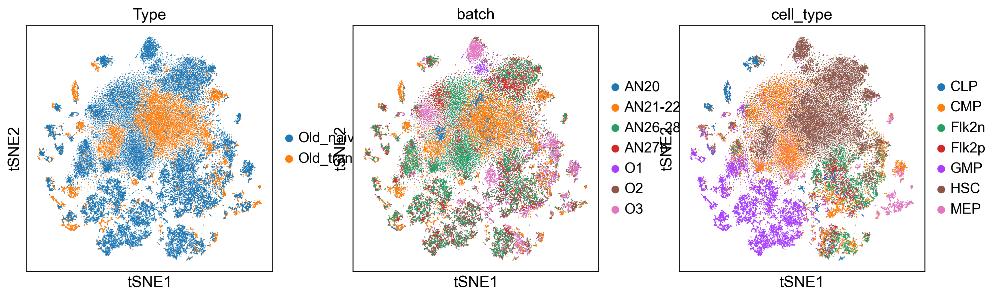

In [43]:
sc.tl.tsne(Old_combined_2_UMI_5_percent_regress_combat, n_pcs = 30)

sc.pl.tsne(Old_combined_2_UMI_5_percent_regress_combat, color=['Type', 'batch', 'cell_type'])

In [44]:
# Embedding the neighborhood graph

# We suggest embedding the graph in two dimensions using UMAP (McInnes et al., 2018), see below. It is potentially more faithful to the global connectivity of the manifold than tSNE, i.e., it better preserves trajectories. In some ocassions, you might still observe disconnected clusters and similar connectivity violations. They can usually be remedied by running:

# tl.paga(adata)
# pl.paga(adata, plot=False)  # remove `plot=False` if you want to see the coarse-grained graph
# tl.umap(adata, init_pos='paga')

sc.tl.umap(Old_combined_2_UMI_5_percent_regress_combat)

computing UMAP
    finished: added
    'X_umap', UMAP coordinates (adata.obsm) (0:00:26)


running Leiden clustering
    finished: found 11 clusters and added
    'leiden_0.2', the cluster labels (adata.obs, categorical) (0:00:08)


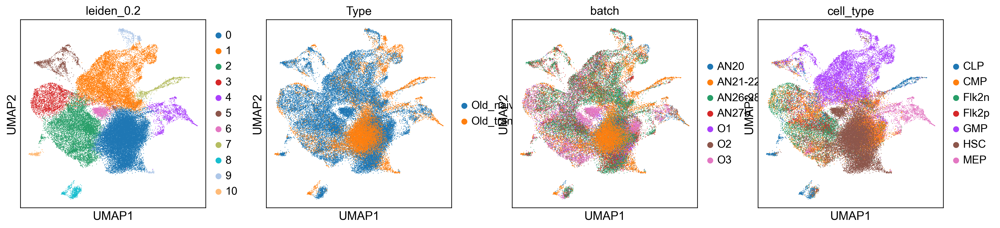

In [45]:
# Clustering the neighborhood graph

# As with Seurat and many other frameworks, we recommend the Leiden graph-clustering method (community detection based on optimizing modularity) by Traag *et al.* (2018). Note that Leiden clustering directly clusters the neighborhood graph of cells, which we already computed in the previous section.
sc.tl.leiden(Old_combined_2_UMI_5_percent_regress_combat, resolution = 0.2, key_added = "leiden_0.2")

# Plot the clusters:
sc.pl.umap(Old_combined_2_UMI_5_percent_regress_combat, color=['leiden_0.2', 'Type', 'batch', 'cell_type'])

In [46]:
#Save the clusters.
Old_combined_2_UMI_5_percent_regress_combat.obs.to_csv("/store/Projects/pantovski/IL10/Combined/write/Ambient_RNA_Cleaned/Old_clusters_2_UMI_5_percent_Combat_raw_SingleR.csv")

In [47]:
# Save the result.
Old_combined_2_UMI_5_percent_regress_combat.write('/store/Projects/pantovski/IL10/Combined/write/Ambient_RNA_Cleaned/Old_2_UMI_5_percent_Combat_raw_SingleR.h5ad')

In [1]:
# DGE

import numpy as np
import pandas as pd
import scanpy as sc

In [2]:
Old_combined_2_UMI_5_percent_regress_combat = sc.read_h5ad('/store/Projects/pantovski/IL10/Combined/write/Ambient_RNA_Cleaned/Old_2_UMI_5_percent_Combat_raw_SingleR.h5ad')

In [3]:
Old_HSC = Old_combined_2_UMI_5_percent_regress_combat[Old_combined_2_UMI_5_percent_regress_combat.obs.cell_type == 'HSC']
Old_HSC.obs

,orig.ident,nCount_RNA,nFeature_RNA,Sample,Type,batch,IL10,n_genes_by_counts,total_counts,total_counts_mt,pct_counts_mt,total_counts_ribo,pct_counts_ribo,n_genes,cell_type,leiden_0.2
CATTCATCATGAATCC-1,0,15015.149445,4614,AN26,Old_naive,AN26-28,IL10_Old,4614,15015.150391,623.732544,4.154021,4818.916992,32.093697,4614,HSC,0
AGGTCTATCTAGGAAA-2,0,15616.779875,4030,AN27,Old_naive,AN26-28,IL10_Old,4030,15616.779297,1012.363159,6.482535,6368.344727,40.778862,4030,HSC,0
AACCATGGTGGCTTAT-3,0,10192.907663,3444,AN27b,Old_naive,AN27b,IL10_Old,3444,10192.908203,662.185242,6.496529,3208.021973,31.473080,3444,HSC,0
AGGTAGGTCACTCGAA-3,0,13683.105258,4401,AN27b,Old_naive,AN27b,IL10_Old,4401,13683.105469,1167.519531,8.532563,2970.684082,21.710598,4401,HSC,3
TGTTCCGAGGACTATA-3,0,7839.619335,2966,AN27b,Old_naive,AN27b,IL10_Old,2966,7839.619629,563.830872,7.192069,2343.271240,29.890114,2966,HSC,0
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
TTTGGTTAGATGGTCG-12,0,15610.136877,4153,AN22,Old_transplanted,AN21-22,DN_Old,4153,15610.136719,973.094849,6.233737,5658.976074,36.251934,4153,HSC,0
TTTGGTTAGCATATGA-12,0,18787.831523,4878,AN22,Old_transplanted,AN21-22,DN_Old,4878,18787.832031,961.273865,5.116470,6175.106934,32.867588,4878,HSC,0
TTTGGTTTCGATGCAT-12,0,11900.146842,3421,AN22,Old_transplanted,AN21-22,DN_Old,3421,11900.147461,577.182129,4.850210,4608.429688,38.725819,3421,HSC,0
TTTGTTGAGGTTGTTC-12,0,9013.997249,2933,AN22,Old_transplanted,AN21-22,DN_Old,2933,9013.998047,465.857269,5.168154,3273.643311,36.317329,2933,HSC,0


In [4]:
pd.crosstab(index=Old_HSC.obs.Sample, columns=Old_HSC.obs.IL10)

IL10,IL10_Old,IL10ra_Old,DN_Old
Sample,,,
AN26,1,89,608
AN27,1,22,586
AN27b,3,83,2195
AN28,1,36,1003
O1,0,24,577
O2,1,25,275
O3,2,35,1272
AN20,7,305,1752
AN21,8,367,3228


In [5]:
Old_naive_HSC = Old_HSC[Old_HSC.obs.Type == 'Old_naive']

sc.tl.rank_genes_groups(Old_naive_HSC, 'IL10', groups = ['IL10ra_Old'], reference = 'DN_Old', method='wilcoxon', corr_method='bonferroni', key_added = 'wilcoxon_bonferroni_Old_naive_IL10ra_vs_DN_Old')
Old_naive_HSC_IL10ra_DEGs = sc.get.rank_genes_groups_df(Old_naive_HSC, group=None, key='wilcoxon_bonferroni_Old_naive_IL10ra_vs_DN_Old')
Old_naive_HSC_IL10ra_DEGs['log_pvals_adj'] = -np.log10(Old_naive_HSC_IL10ra_DEGs['pvals_adj'])
Old_naive_HSC_IL10ra_DEGs.to_csv("/store/Projects/pantovski/IL10/Combined/write/Ambient_RNA_Cleaned/Old_naive_IL10ra_vs_DN_DGE_2_UMI_5_percent_Combat_raw_SingleR.csv")

Trying to set attribute `._uns` of view, copying.
/home/LULAB/pantovski/.conda/envs/general/lib/python3.8/site-packages/scanpy/tools/_rank_genes_groups.py:420: RuntimeWarning: invalid value encountered in log2
  self.stats[group_name, 'logfoldchanges'] = np.log2(


In [6]:
Old_transplanted_HSC = Old_HSC[Old_HSC.obs.Type == 'Old_transplanted']

sc.tl.rank_genes_groups(Old_transplanted_HSC, 'IL10', groups = ['IL10ra_Old'], reference = 'DN_Old', method='wilcoxon', corr_method='bonferroni', key_added = 'wilcoxon_bonferroni_Old_transplanted_IL10ra_vs_DN_Old')
Old_transplanted_HSC_IL10ra_DEGs = sc.get.rank_genes_groups_df(Old_transplanted_HSC, group=None, key='wilcoxon_bonferroni_Old_transplanted_IL10ra_vs_DN_Old')
Old_transplanted_HSC_IL10ra_DEGs['log_pvals_adj'] = -np.log10(Old_transplanted_HSC_IL10ra_DEGs['pvals_adj'])
Old_transplanted_HSC_IL10ra_DEGs.to_csv("/store/Projects/pantovski/IL10/Combined/write/Ambient_RNA_Cleaned/Old_transplanted_IL10ra_vs_DN_DGE_2_UMI_5_percent_Combat_raw_SingleR.csv")

Trying to set attribute `._uns` of view, copying.
/home/LULAB/pantovski/.conda/envs/general/lib/python3.8/site-packages/scanpy/tools/_rank_genes_groups.py:420: RuntimeWarning: invalid value encountered in log2
  self.stats[group_name, 'logfoldchanges'] = np.log2(


In [7]:
expression_matrix = pd.DataFrame(Old_HSC.X)
expression_matrix.columns = Old_HSC.var.index
expression_matrix = expression_matrix.T
gene_list = list(Old_HSC.var.index)
column_values = pd.Series(gene_list)
expression_matrix.insert(loc=0, column='Description', value=column_values)
expression_matrix.insert(loc=0, column='NAME', value=gene_list)
expression_matrix['NAME'] = expression_matrix['NAME'].str.upper()
expression_matrix.index = range(len(expression_matrix.index))

expression_matrix.to_csv('/store/Projects/pantovski/IL10/Combined/write/Ambient_RNA_Cleaned/Old_HSC_expression_matrix_2_UMI_5_percent_Combat_raw_SingleR.txt', index=None, sep='\t', mode='a')

In [8]:
phenotype_list = list(Old_HSC.obs.IL10)
first_row = [Old_HSC.shape[0], '3', '1']
second_row = ['#', 'IL10_Old', 'IL10ra_Old', 'DN_Old']

import csv

with open('/store/Projects/pantovski/IL10/Combined/write/Ambient_RNA_Cleaned/Old_HSC_phenotype_list_2_UMI_5_percent_Combat_raw_SingleR.cls', 'w') as f:
      
    # using csv.writer method from CSV package
    write = csv.writer(f, delimiter=' ')
      
    write.writerow(first_row)
    write.writerow(second_row)
    write.writerow(phenotype_list)

In [9]:
import gseapy as gp
gene_set_names = gp.get_library_name(organism='Mouse')

In [10]:
groups = ['IL10ra_Old', 'DN_Old']
IL10ra_vs_DN_GSEA = Old_HSC[Old_HSC.obs.IL10.isin(groups)]

In [11]:
expression_matrix_IL10ra_vs_DN = pd.DataFrame(IL10ra_vs_DN_GSEA.X)
expression_matrix_IL10ra_vs_DN.columns = IL10ra_vs_DN_GSEA.var.index
expression_matrix_IL10ra_vs_DN = expression_matrix_IL10ra_vs_DN.T
gene_list = list(IL10ra_vs_DN_GSEA.var.index)
column_values = pd.Series(gene_list)
expression_matrix_IL10ra_vs_DN.insert(loc=0, column='Description', value=column_values)
expression_matrix_IL10ra_vs_DN.insert(loc=0, column='NAME', value=gene_list)
expression_matrix_IL10ra_vs_DN['NAME'] = expression_matrix_IL10ra_vs_DN['NAME'].str.upper()
expression_matrix_IL10ra_vs_DN.index = range(len(expression_matrix_IL10ra_vs_DN.index))

In [12]:
phenotype_list_IL10ra_vs_DN = list(IL10ra_vs_DN_GSEA.obs.IL10)

In [13]:
gs_res_IL10ra_vs_DN = gp.gsea(data=expression_matrix_IL10ra_vs_DN, # or data='./P53_resampling_data.txt'
                 gene_sets='GO_Biological_Process_2021', # enrichr library names
                 cls= phenotype_list_IL10ra_vs_DN, # cls=class_vector
                 # set permutation_type to phenotype if samples >=15
                 permutation_type='phenotype',
                 permutation_num=100, # reduce number to speed up test
                 outdir=None,  # do not write output to disk
                 no_plot=True, # Skip plotting
                 method='signal_to_noise',
                 processes=4, seed= 7,
                 min_size = 15,
                 max_size = 500,
                 format='png',)

#access the dataframe results throught res2d attribute
gs_res_IL10ra_vs_DN.res2d.to_csv('/store/Projects/pantovski/IL10/Combined/write/Ambient_RNA_Cleaned/Old_IL10ra_vs_DN_GSEA_GO_BP_2_UMI_5_percent_Combat_raw_SingleR.csv', index=None)

significant_terms = gs_res_IL10ra_vs_DN.res2d
significant_terms = significant_terms[significant_terms.pval < 0.05]
significant_terms = significant_terms[significant_terms.fdr < 0.25]
significant_terms.reset_index(inplace=True)
significant_terms

2022-05-05 13:01:39,322 Warning: Input data contains NA, filled NA with 0


,Term,es,nes,pval,fdr,geneset_size,matched_size,genes,ledge_genes
0,negative regulation of viral genome replicatio...,0.695974,2.241442,0.000000,0.000000,54,16,IFITM1;PLSCR1;IFITM2;IFITM3;RESF1;TASOR;SRPK2;...,IFITM1;PLSCR1;IFITM2;IFITM3;RESF1
1,defense response to symbiont (GO:0140546),0.643170,2.165164,0.000000,0.004642,124,27,IFITM1;PLSCR1;SERINC3;IFITM2;PTPRC;IFITM3;LYST...,IFITM1;PLSCR1;SERINC3;IFITM2;PTPRC;IFITM3;LYST...
2,regulation of transforming growth factor beta ...,0.588061,2.120814,0.000000,0.006963,100,25,SMAD7;FKBP1A;UBC;CITED2;SDCBP;CREBBP;ENG;EP300...,SMAD7;FKBP1A;UBC;CITED2;SDCBP;CREBBP;ENG;EP300...
3,cellular response to cytokine stimulus (GO:007...,0.477041,2.082698,0.000000,0.009283,482,108,PRTN3;PIM1;SBNO2;CEBPD;XBP1;ZFP36;IL2RG;LBP;JU...,PRTN3;PIM1;SBNO2;CEBPD;XBP1;ZFP36;IL2RG;LBP;JU...
4,cellular response to type I interferon (GO:007...,0.711930,2.003145,0.000000,0.009283,65,17,IFITM1;IFITM2;IFITM3;SAMHD1;JAK1;IRF8;EGR1;RNA...,IFITM1;IFITM2;IFITM3;SAMHD1;JAK1;IRF8
...,...,...,...,...,...,...,...,...,...
180,actin filament organization (GO:0007015),0.439296,1.439141,0.046512,0.238704,152,31,PPP1R9B;TMOD3;CD2AP;RAC1;CAPG;CORO7;ELMO1;FLII...,PPP1R9B;TMOD3;CD2AP;RAC1;CAPG;CORO7;ELMO1;FLII
181,cellular response to oxidative stress (GO:0034...,-0.392876,-1.450866,0.000000,0.238745,125,41,JUN;NCF2;FOS;SETX;NFE2L2;SOD1;GSR;GPX1;TXNRD1;...,SELENOS;PRDX1;ATF4;HTRA2;RPS3;CYBB;ATP13A2;CHC...
182,"DNA damage response, signal transduction by p5...",-0.440963,-1.441231,0.033898,0.239170,74,25,BTG2;MDM4;EP300;CNOT6;NDRG1;SP100;ATRX;CNOT4;B...,SOX4;PRMT1;E2F8;CDK1;RPS27L;RGCC
183,apoptotic process (GO:0006915),0.349703,1.432044,0.000000,0.242040,231,60,PLSCR1;PTK2B;HK2;IER3;RIPK1;JADE1;CASP1;BNIP2;...,PLSCR1;PTK2B;HK2;IER3;RIPK1;JADE1;CASP1;BNIP2;...


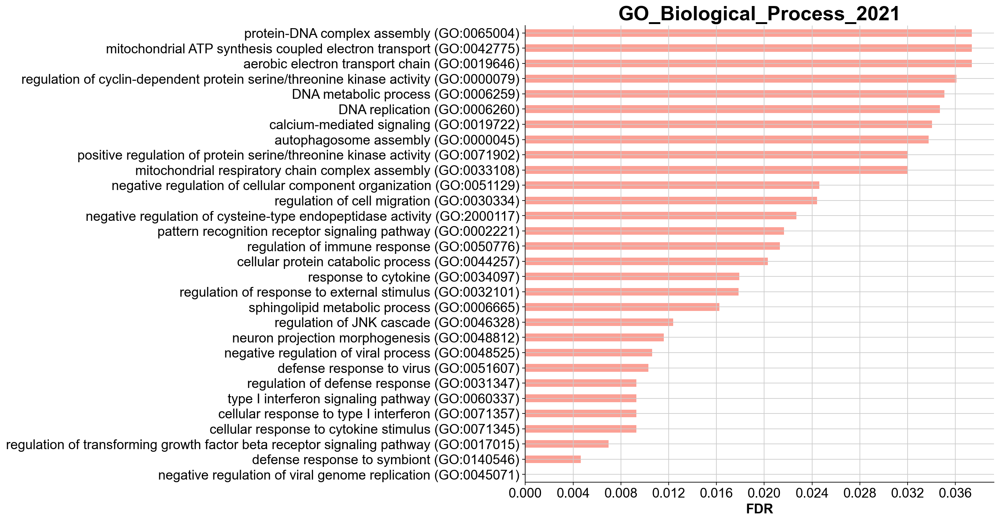

In [14]:
sc.settings.set_figure_params(dpi=80, facecolor='white')

top30 = significant_terms.sort_values('fdr', ascending=True).head(30)

top30.rename(columns={'fdr':'FDR'}, inplace=True)

gp.barplot(top30, column='FDR', top_term=30, title='GO_Biological_Process_2021', figsize=(10,10), ofname='/store/Projects/pantovski/IL10/GSEA_and_GO_figures/Ambient_RNA_Cleaned/Old IL10ra vs DN GSEA GO BP.png')

gp.barplot(top30, column='FDR', top_term=30, title='GO_Biological_Process_2021', figsize=(10,10))

In [15]:
gs_res_IL10ra_vs_DN = gp.gsea(data=expression_matrix_IL10ra_vs_DN, # or data='./P53_resampling_data.txt'
                 gene_sets='GO_Molecular_Function_2021', # enrichr library names
                 cls= phenotype_list_IL10ra_vs_DN, # cls=class_vector
                 # set permutation_type to phenotype if samples >=15
                 permutation_type='phenotype',
                 permutation_num=100, # reduce number to speed up test
                 outdir=None,  # do not write output to disk
                 no_plot=True, # Skip plotting
                 method='signal_to_noise',
                 processes=4, seed= 7,
                 min_size = 15,
                 max_size = 500,
                 format='png')

#access the dataframe results throught res2d attribute
gs_res_IL10ra_vs_DN.res2d.to_csv('/store/Projects/pantovski/IL10/Combined/write/Ambient_RNA_Cleaned/Old_IL10ra_vs_DN_GSEA_GO_MF_2_UMI_5_percent_Combat_raw_SingleR.csv')

significant_terms = gs_res_IL10ra_vs_DN.res2d
significant_terms = significant_terms[significant_terms.pval < 0.05]
significant_terms = significant_terms[significant_terms.fdr < 0.25]
significant_terms.reset_index(inplace=True)
significant_terms

2022-05-05 13:02:31,085 Warning: Input data contains NA, filled NA with 0


,Term,es,nes,pval,fdr,geneset_size,matched_size,genes,ledge_genes
0,RNA polymerase II cis-regulatory region sequen...,0.500146,2.069175,0.000000,0.000000,1149,113,CEBPD;XBP1;NKX2-3;KLF2;KLF6;KLF9;JUNB;JUND;STA...,CEBPD;XBP1;NKX2-3;KLF2;KLF6;KLF9;JUNB;JUND;STA...
1,cysteine-type endopeptidase activity (GO:0004197),0.606147,2.056101,0.000000,0.000000,105,26,CTSB;CTSC;CTSH;CTSL;CTSS;CASP1;CFLAR;CASP8;USP...,CTSB;CTSC;CTSH;CTSL;CTSS;CASP1;CFLAR;CASP8;USP...
2,RNA polymerase II transcription regulatory reg...,0.474583,2.013310,0.000000,0.003997,1359,128,CEBPD;XBP1;NKX2-3;KLF2;KLF6;KLF9;JUNB;JUND;STA...,CEBPD;XBP1;NKX2-3;KLF2;KLF6;KLF9;JUNB;JUND;STA...
3,cis-regulatory region sequence-specific DNA bi...,0.488757,2.005552,0.000000,0.008993,1149,114,CEBPD;XBP1;NKX2-3;KLF2;KLF6;KLF9;JUNB;JUND;STA...,CEBPD;XBP1;NKX2-3;KLF2;KLF6;KLF9;JUNB;JUND;STA...
4,calcium ion binding (GO:0005509),0.488826,1.891894,0.000000,0.021583,348,54,SELP;S100A4;PLSCR1;TPT1;S100A6;TGM2;IQGAP1;ASP...,SELP;S100A4;PLSCR1;TPT1;S100A6;TGM2;IQGAP1;ASP...
5,"oxidoreductase activity, acting on the CH-OH g...",-0.594411,-1.848861,0.000000,0.022350,87,21,HADHA;HIBADH;GLYR1;HADHB;LDHB;AKR1A1;HMGCR;IMP...,MDH2;ADH5;HADH;SORD;DHRS4;MDH1;ME2;HSD17B10;PT...
6,cysteine-type peptidase activity (GO:0008234),0.558446,1.829257,0.000000,0.027979,98,25,CTSB;CTSC;CTSH;CTSL;CTSS;CASP1;CASP8;USP7;USP4...,CTSB;CTSC;CTSH;CTSL;CTSS;CASP1;CASP8;USP7;USP4...
7,proton transmembrane transporter activity (GO:...,-0.653634,-1.799018,0.000000,0.029259,40,17,COX7A2L;ATP6V1B2;CYB5A;ATP6V1F;COX6A1;UQCRFS1;...,COX8A;COX4I1;COX5B;COX6B1;UQCR10;UQCRQ;UQCRC1;...
8,magnesium ion binding (GO:0000287),-0.496265,-1.763553,0.000000,0.029800,146,37,PLSCR1;PDCD6;SRPK2;MARK2;STK11;PRKACB;DHX36;ST...,MSH2;MSH6;FEN1;TDG;IMPA1;NUDT5;PSPH;PGP;YDJC;D...
9,NADH dehydrogenase (quinone) activity (GO:0050...,-0.582983,-1.862385,0.020833,0.029800,35,34,NDUFA6;NDUFV1;NDUFS3;NDUFS1;NDUFS7;NDUFA8;NDUF...,NDUFB10;NDUFA7;NDUFA5;NDUFS2;NDUFA10;NDUFS5;ND...


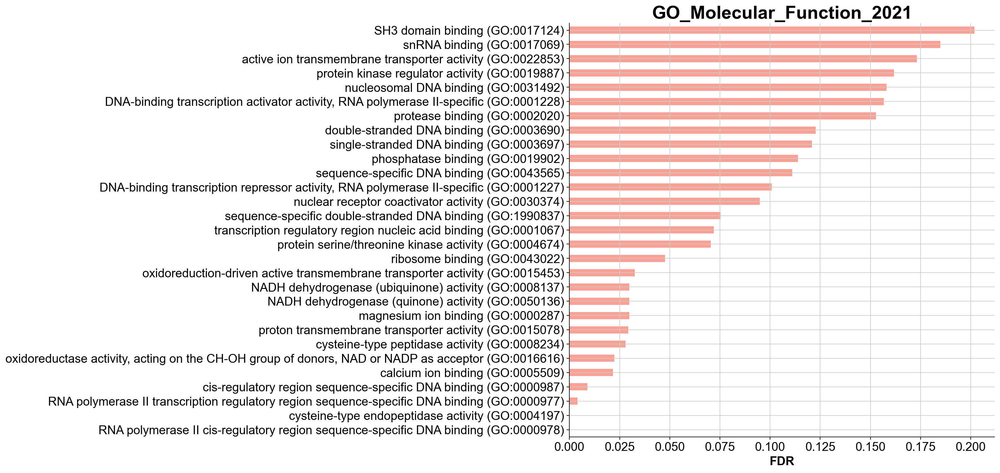

In [16]:
sc.settings.set_figure_params(dpi=80, facecolor='white')

top30 = significant_terms.sort_values('fdr', ascending=True).head(30)

top30.rename(columns={'fdr':'FDR'}, inplace=True)

gp.barplot(top30, column='FDR', top_term=30, title='GO_Molecular_Function_2021', figsize=(10,10), ofname='/store/Projects/pantovski/IL10/GSEA_and_GO_figures/Ambient_RNA_Cleaned/Old IL10ra vs DN GSEA GO MF.png')

gp.barplot(top30, column='FDR', top_term=30, title='GO_Molecular_Function_2021', figsize=(10,10))

In [17]:
gs_res_IL10ra_vs_DN = gp.gsea(data=expression_matrix_IL10ra_vs_DN, # or data='./P53_resampling_data.txt'
                 gene_sets='GO_Cellular_Component_2021', # enrichr library names
                 cls= phenotype_list_IL10ra_vs_DN, # cls=class_vector
                 # set permutation_type to phenotype if samples >=15
                 permutation_type='phenotype',
                 permutation_num=100, # reduce number to speed up test
                 outdir=None,  # do not write output to disk
                 no_plot=True, # Skip plotting
                 method='signal_to_noise',
                 processes=4, seed= 7,
                 min_size = 15,
                 max_size = 500,
                 format='png')


#access the dataframe results throught res2d attribute
gs_res_IL10ra_vs_DN.res2d.to_csv('/store/Projects/pantovski/IL10/Combined/write/Ambient_RNA_Cleaned/Old_IL10ra_vs_DN_GSEA_GO_CC_2_UMI_5_percent_Combat_raw_SingleR.csv')

significant_terms = gs_res_IL10ra_vs_DN.res2d
significant_terms = significant_terms[significant_terms.pval < 0.05]
significant_terms = significant_terms[significant_terms.fdr < 0.25]
significant_terms.reset_index(inplace=True)
significant_terms

2022-05-05 13:03:07,904 Warning: Input data contains NA, filled NA with 0


,Term,es,nes,pval,fdr,geneset_size,matched_size,genes,ledge_genes
0,integral component of plasma membrane (GO:0005...,0.524580,2.358940,0.000000,0.000000,1454,103,CD53;ALCAM;SELP;PLSCR1;ADGRL4;IL2RG;PROCR;IFNG...,CD53;ALCAM;SELP;PLSCR1;ADGRL4;IL2RG;PROCR;IFNG...
1,lysosomal lumen (GO:0043202),0.679534,2.301256,0.000000,0.000000,86,21,CTSB;GM2A;PSAP;CTSL;LAMP2;CTSS;ASAH1;IFI30;CTS...,CTSB;GM2A;PSAP;CTSL;LAMP2;CTSS;ASAH1;IFI30;CTSA
2,lysosome (GO:0005764),0.550309,2.386377,0.000000,0.000000,477,102,IFITM1;IFITM2;CTSB;FLOT1;GM2A;IFITM3;SLC44A2;C...,IFITM1;IFITM2;CTSB;FLOT1;GM2A;IFITM3;SLC44A2;C...
3,lytic vacuole (GO:0000323),0.606613,2.408703,0.000000,0.000000,219,52,CTSB;CTSC;PSAP;CTSH;CTSL;LAMP2;RAB38;NAPSA;CTS...,CTSB;CTSC;PSAP;CTSH;CTSL;LAMP2;RAB38;NAPSA;CTS...
4,membrane raft (GO:0045121),0.616178,2.274818,0.000000,0.000000,163,34,PRTN3;PLSCR1;FLOT1;PTPRC;ORAI1;TNFRSF1A;SELPLG...,PRTN3;PLSCR1;FLOT1;PTPRC;ORAI1;TNFRSF1A;SELPLG...
5,mitochondrial inner membrane (GO:0005743),-0.479852,-2.061531,0.000000,0.000000,328,179,UCP2;MRPL52;COX7A2L;LGALS3;MRPL17;MRPL23;TIMM1...,MRPL4;MRPS36;TIMM23;MRPL30;MRPS18C;MRPS24;NDUF...
6,serine/threonine protein kinase complex (GO:19...,-0.815920,-2.246122,0.000000,0.000000,37,15,CCND3;CDK12;CDK13;CAB39;CCNI;CCNB1;CKS1B;CDK6;...,CKS1B;CDK6;CCNA2;CDK1;CDK4;CCNB2;CKS2;CCND1;CCND2
7,mitochondrial matrix (GO:0005759),-0.481105,-2.024344,0.000000,0.003227,348,118,OAT;SUCLA2;OGDH;NR3C1;RNASEL;SOD1;GSR;GPX1;SMD...,IDH3B;MRPL13;IDH3A;NDUFA7;MRPL20;TIMM44;IDH3G;...
8,lytic vacuole membrane (GO:0098852),0.525134,2.041389,0.000000,0.003449,267,58,IFITM1;IFITM2;FLOT1;IFITM3;SLC44A2;PSAP;RAB5C;...,IFITM1;IFITM2;FLOT1;IFITM3;SLC44A2;PSAP;RAB5C;...
9,multivesicular body (GO:0005771),0.636961,1.882210,0.000000,0.006897,47,16,TPT1;CTSH;CTSL;NAPSA;CHMP4B;CD63;CHMP5;VTA1;RA...,TPT1;CTSH;CTSL;NAPSA;CHMP4B;CD63


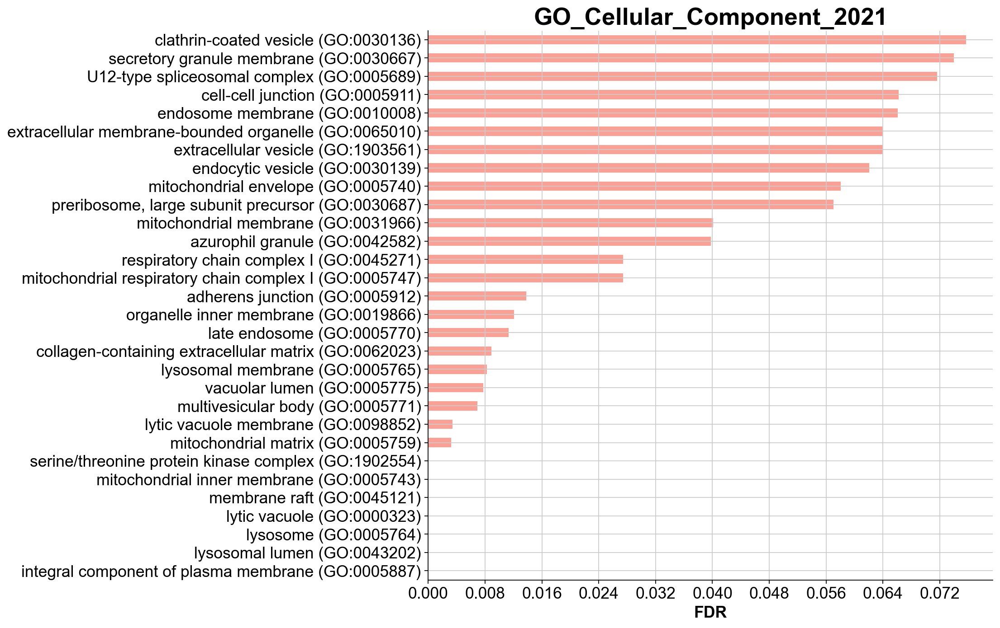

In [18]:
sc.settings.set_figure_params(dpi=80, facecolor='white')

top30 = significant_terms.sort_values('fdr', ascending=True).head(30)

top30.rename(columns={'fdr':'FDR'}, inplace=True)

gp.barplot(top30, column='FDR', top_term=30, title='GO_Cellular_Component_2021', figsize=(10,10), ofname='/store/Projects/pantovski/IL10/GSEA_and_GO_figures/Ambient_RNA_Cleaned/Old IL10ra vs DN GSEA GO CC.png')

gp.barplot(top30, column='FDR', top_term=30, title='GO_Cellular_Component_2021', figsize=(10,10))

In [19]:
gs_res_IL10ra_vs_DN = gp.gsea(data=expression_matrix_IL10ra_vs_DN, # or data='./P53_resampling_data.txt'
                 gene_sets='KEGG_2019_Mouse', # enrichr library names
                 cls= phenotype_list_IL10ra_vs_DN, # cls=class_vector
                 # set permutation_type to phenotype if samples >=15
                 permutation_type='phenotype',
                 permutation_num=100, # reduce number to speed up test
                 outdir=None,  # do not write output to disk
                 no_plot=True, # Skip plotting
                 method='signal_to_noise',
                 processes=4, seed= 7,
                 min_size = 15,
                 max_size = 500,
                 format='png')


#access the dataframe results throught res2d attribute
gs_res_IL10ra_vs_DN.res2d.to_csv('/store/Projects/pantovski/IL10/Combined/write/Ambient_RNA_Cleaned/Old_IL10ra_vs_DN_GSEA_KEGG_2_UMI_5_percent_Combat_raw_SingleR.csv')

significant_terms = gs_res_IL10ra_vs_DN.res2d
significant_terms = significant_terms[significant_terms.pval < 0.05]
significant_terms = significant_terms[significant_terms.fdr < 0.25]
significant_terms.reset_index(inplace=True)
significant_terms

2022-05-05 13:03:45,939 Warning: Input data contains NA, filled NA with 0


,Term,es,nes,pval,fdr,geneset_size,matched_size,genes,ledge_genes
0,Autophagy,0.573215,2.182806,0.000000,0.000000,130,42,VMP1;CTSB;PIK3R1;GABARAPL1;CTSL;LAMP2;RAB7;GAB...,VMP1;CTSB;PIK3R1;GABARAPL1;CTSL;LAMP2;RAB7;GAB...
1,DNA replication,-0.640689,-2.086116,0.000000,0.000000,35,30,POLD4;POLD3;RNASEH2A;POLA2;SSBP1;RFC3;MCM4;POL...,PCNA;RFC1;POLD1;POLD2;RPA2;FEN1;POLE3;PRIM1;RF...
2,Lysosome,0.643369,2.347559,0.000000,0.000000,124,36,CTSB;GM2A;CTSC;PSAP;CTSH;CTSL;LAMP2;NAPSA;CTSS...,CTSB;GM2A;CTSC;PSAP;CTSH;CTSL;LAMP2;NAPSA;CTSS...
3,Mismatch repair,-0.643344,-2.005273,0.000000,0.000000,22,17,POLD4;POLD3;SSBP1;RFC3;RFC4;RPA1;PCNA;RFC1;POL...,PCNA;RFC1;POLD1;POLD2;RPA2;MSH2;MSH6;RFC5;RPA3...
4,Oxidative phosphorylation,-0.552181,-2.032859,0.000000,0.000000,134,91,COX7A2L;ATP6AP1;ATP6V1A;ATP6V1D;ATP6V0D1;SDHA;...,NDUFA5;NDUFS2;NDUFA10;NDUFS5;NDUFA2;SDHD;NDUFB...
5,Parkinson disease,-0.564085,-2.137658,0.000000,0.000000,144,93,COX7A2L;SLC18A2;GNAI2;SDHA;SDHC;PRKACB;NDUFA6;...,VDAC3;VDAC2;NDUFB10;NDUFA7;NDUFA5;NDUFS2;NDUFA...
6,TNF signaling pathway,0.653312,2.078930,0.000000,0.000000,110,25,JUNB;CEBPB;TNFRSF1A;PIK3R1;JUN;RIPK1;FOS;CFLAR...,JUNB;CEBPB;TNFRSF1A;PIK3R1;JUN;RIPK1;FOS;CFLAR...
7,Thermogenesis,-0.502560,-2.024136,0.000000,0.000000,231,117,RPS6KA3;PNPLA2;COX7A2L;NRAS;RPS6KB1;CREB1;SDHA...,NDUFA5;COX19;NDUFS2;NDUFA10;NDUFS5;NDUFA2;SDHD...
8,Osteoclast differentiation,0.542314,1.966056,0.000000,0.008930,128,37,JUNB;JUND;IFNGR1;TNFRSF1A;PIK3R1;JUN;SPI1;JAK1...,JUNB;JUND;IFNGR1;TNFRSF1A;PIK3R1;JUN;SPI1;JAK1...
9,Pyruvate metabolism,-0.659432,-1.935818,0.000000,0.009680,38,16,PKM;PDHB;LDHB;PDHA1;GLO1;LDHA;MDH2;DLD;ACAT1;M...,MDH2;DLD;ACAT1;MDH1;PCK2;ACYP1;ALDH9A1;ME2;FH1...


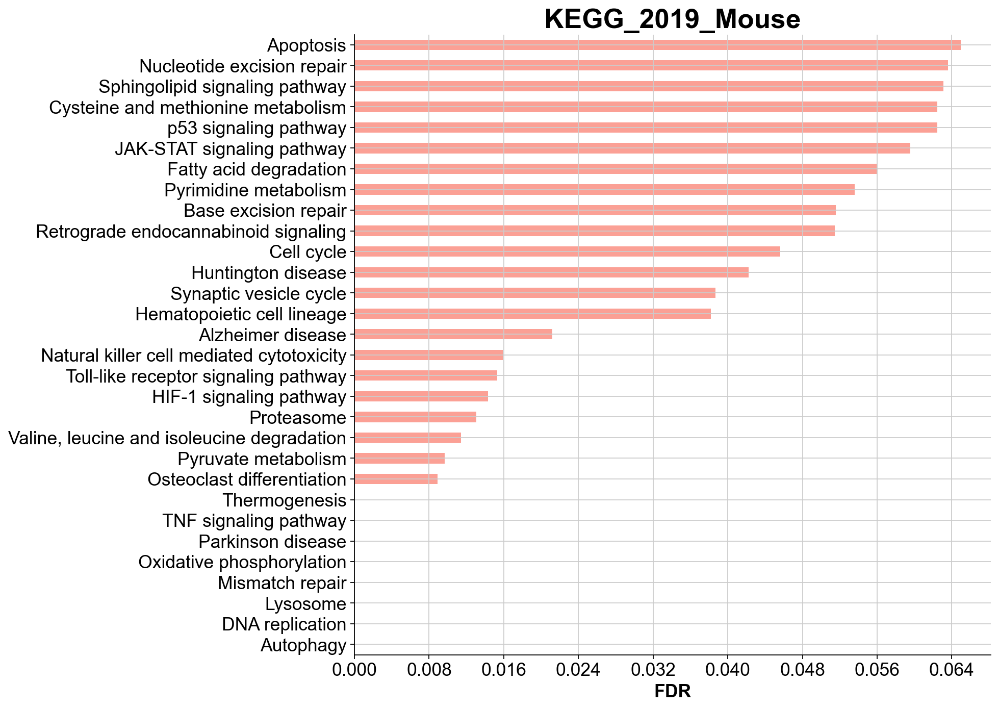

In [20]:
sc.settings.set_figure_params(dpi=80, facecolor='white')

top30 = significant_terms.sort_values('fdr', ascending=True).head(30)

top30.rename(columns={'fdr':'FDR'}, inplace=True)

gp.barplot(top30, column='FDR', top_term=30, title='KEGG_2019_Mouse', figsize=(10,10), ofname='/store/Projects/pantovski/IL10/GSEA_and_GO_figures/Ambient_RNA_Cleaned/Old IL10ra vs DN GSEA KEGG.png')

gp.barplot(top30, column='FDR', top_term=30, title='KEGG_2019_Mouse', figsize=(10,10))

In [21]:
gs_res_IL10ra_vs_DN = gp.gsea(data=expression_matrix_IL10ra_vs_DN, # or data='./P53_resampling_data.txt'
                 gene_sets='WikiPathways_2019_Mouse', # enrichr library names
                 cls= phenotype_list_IL10ra_vs_DN, # cls=class_vector
                 # set permutation_type to phenotype if samples >=15
                 permutation_type='phenotype',
                 permutation_num=100, # reduce number to speed up test
                 outdir=None,  # do not write output to disk
                 no_plot=True, # Skip plotting
                 method='signal_to_noise',
                 processes=4, seed= 7,
                 min_size = 15,
                 max_size = 500,
                 format='png')

#access the dataframe results throught res2d attribute
gs_res_IL10ra_vs_DN.res2d.to_csv('/store/Projects/pantovski/IL10/Combined/write/Ambient_RNA_Cleaned/Old_IL10ra_vs_DN_GSEA_WIKI_2_UMI_5_percent_Combat_raw_SingleR.csv')

significant_terms = gs_res_IL10ra_vs_DN.res2d
significant_terms = significant_terms[significant_terms.pval < 0.05]
significant_terms = significant_terms[significant_terms.fdr < 0.25]
significant_terms.reset_index(inplace=True)
significant_terms

2022-05-05 13:04:21,443 Warning: Input data contains NA, filled NA with 0


,Term,es,nes,pval,fdr,geneset_size,matched_size,genes,ledge_genes
0,Insulin Signaling WP65,0.575908,2.212628,0.000000,0.000000,159,45,MAP4K4;XBP1;RPS6KA3;FLOT1;SNAP23;PIK3R1;JUN;RA...,MAP4K4;XBP1;RPS6KA3;FLOT1;SNAP23;PIK3R1;JUN;RA...
1,Electron Transport Chain WP295,-0.582122,-2.037829,0.000000,0.003846,103,74,UCP2;COX7A2L;SDHA;SDHC;NDUFA6;NDUFV1;SLC25A4;A...,NDUFA5;NDUFS2;NDUFA10;NDUFS5;NDUFA2;SDHD;NDUFA...
2,TGF Beta Signaling Pathway WP113,0.632214,1.979076,0.000000,0.004167,52,18,SMAD7;STAT3;FKBP1A;JUN;JAK1;CREBBP;FOS;ENG;EP3...,SMAD7;STAT3;FKBP1A;JUN;JAK1;CREBBP;FOS;ENG;EP300
3,EGFR1 Signaling Pathway WP572,0.522296,2.052576,0.000000,0.006250,178,64,PLSCR1;RPS6KA3;JUND;STAT3;CEBPB;PLEC;PTK2B;PIK...,PLSCR1;RPS6KA3;JUND;STAT3;CEBPB;PLEC;PTK2B;PIK...
4,G1 to S cell cycle control WP413,-0.631160,-2.050540,0.000000,0.007692,61,29,CDKN2D;CCND3;POLA2;ORC2;MCM4;TFDP2;RPA1;E2F4;O...,PRIM1;CDK6;MYC;CDC25A;RPA3;MCM7;CDK1;CDK4;MCM6...
5,ESC Pluripotency Pathways WP339,0.627152,1.880062,0.000000,0.009375,118,19,SMAD7;STAT3;JUN;JAK1;SELENOP;FOS;APC;ACTR2;CTN...,SMAD7;STAT3;JUN;JAK1;SELENOP;FOS
6,IL-6 signaling Pathway WP387,0.497050,1.843131,0.000000,0.012500,99,45,STAT3;CEBPB;PTK2B;PIK3R1;JUN;JAK1;CREBBP;RAC1;...,STAT3;CEBPB;PTK2B;PIK3R1;JUN;JAK1;CREBBP;RAC1;...
7,IL-5 Signaling Pathway WP151,0.494931,1.866906,0.000000,0.012500,69,42,PIM1;STAT3;PTK2B;PIK3R1;JUN;SDCBP;JAK1;ALOX5AP...,PIM1;STAT3;PTK2B;PIK3R1;JUN;SDCBP;JAK1;ALOX5AP...
8,Alpha6-Beta4 Integrin Signaling Pathway WP488,0.511113,1.770102,0.000000,0.021875,67,22,VIM;PLEC;PIK3R1;RAC1;DST;BAD;ITGA6;RHOA;ERBIN;...,VIM;PLEC;PIK3R1;RAC1;DST;BAD;ITGA6
9,IL-2 Signaling Pathway WP450,0.521026,1.775158,0.000000,0.023214,76,34,CD53;IL2RG;STAT3;PTK2B;PIK3R1;JAK1;PTPN6;RPS6K...,CD53;IL2RG;STAT3;PTK2B;PIK3R1;JAK1


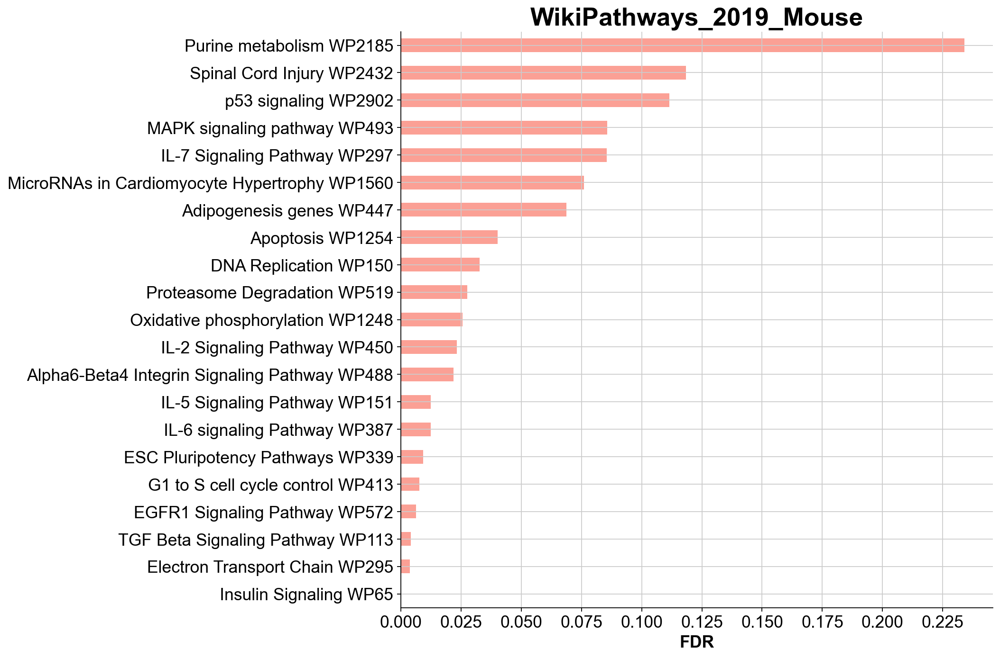

In [22]:
sc.settings.set_figure_params(dpi=80, facecolor='white')

top30 = significant_terms.sort_values('fdr', ascending=True).head(30)

top30.rename(columns={'fdr':'FDR'}, inplace=True)

gp.barplot(top30, column='FDR', top_term=30, title='WikiPathways_2019_Mouse', figsize=(10,10), ofname='/store/Projects/pantovski/IL10/GSEA_and_GO_figures/Ambient_RNA_Cleaned/Old IL10ra vs DN GSEA WIKI.png')

gp.barplot(top30, column='FDR', top_term=30, title='WikiPathways_2019_Mouse', figsize=(10,10))

In [23]:
groups = ['IL10_Old', 'DN_Old']
IL10_vs_DN_GSEA = Old_HSC[Old_HSC.obs.IL10.isin(groups)]

In [24]:
expression_matrix_IL10_vs_DN = pd.DataFrame(IL10_vs_DN_GSEA.X)
expression_matrix_IL10_vs_DN.columns = IL10_vs_DN_GSEA.var.index
expression_matrix_IL10_vs_DN = expression_matrix_IL10_vs_DN.T
gene_list = list(IL10_vs_DN_GSEA.var.index)
column_values = pd.Series(gene_list)
expression_matrix_IL10_vs_DN.insert(loc=0, column='Description', value=column_values)
expression_matrix_IL10_vs_DN.insert(loc=0, column='NAME', value=gene_list)
expression_matrix_IL10_vs_DN['NAME'] = expression_matrix_IL10_vs_DN['NAME'].str.upper()
expression_matrix_IL10_vs_DN.index = range(len(expression_matrix_IL10_vs_DN.index))

In [25]:
phenotype_list_IL10_vs_DN = list(IL10_vs_DN_GSEA.obs.IL10)

In [26]:
gs_res_IL10_vs_DN = gp.gsea(data=expression_matrix_IL10_vs_DN, # or data='./P53_resampling_data.txt'
                 gene_sets='GO_Biological_Process_2021', # enrichr library names
                 cls= phenotype_list_IL10_vs_DN, # cls=class_vector
                 # set permutation_type to phenotype if samples >=15
                 permutation_type='phenotype',
                 permutation_num=100, # reduce number to speed up test
                 outdir=None,  # do not write output to disk
                 no_plot=True, # Skip plotting
                 method='signal_to_noise',
                 processes=4, seed= 7,
                 min_size = 15,
                 max_size = 500,
                 format='png',)

#access the dataframe results throught res2d attribute
gs_res_IL10_vs_DN.res2d.to_csv('/store/Projects/pantovski/IL10/Combined/write/Ambient_RNA_Cleaned/Old_IL10_vs_DN_GSEA_GO_BP_2_UMI_5_percent_Combat_raw_SingleR.csv', index=None)

significant_terms = gs_res_IL10_vs_DN.res2d
significant_terms = significant_terms[significant_terms.pval < 0.05]
significant_terms = significant_terms[significant_terms.fdr < 0.25]
significant_terms.reset_index(inplace=True)
significant_terms

2022-05-05 13:04:56,932 Warning: Input data contains NA, filled NA with 0


,Term,es,nes,pval,fdr,geneset_size,matched_size,genes,ledge_genes
0,mitotic spindle assembly (GO:0090307),-0.652468,-1.921380,0.000000,0.099975,44,19,MZT1;KPNB1;STAG2;KIF2A;LSM14A;RAB11A;RHOA;FLNA...,KIF23;RACGAP1;TPX2;KIF11;PRC1;AURKB
1,aerobic electron transport chain (GO:0019646),-0.551774,-1.921478,0.000000,0.113793,70,61,NDUFS1;SDHC;NDUFS4;NDUFB11;NDUFA2;UQCRC1;UQCRQ...,NDUFB9;NDUFA7;UQCC3;COX5A;CYCS;COX7B;NDUFS6;ND...
2,mitochondrial ATP synthesis coupled electron t...,-0.551774,-1.921478,0.000000,0.113793,71,61,NDUFS1;SDHC;NDUFS4;NDUFB11;NDUFA2;UQCRC1;UQCRQ...,NDUFB9;NDUFA7;UQCC3;COX5A;CYCS;COX7B;NDUFS6;ND...
3,protein stabilization (GO:0050821),-0.468285,-1.891855,0.000000,0.121616,179,69,CREB1;TRIM44;USP19;RTN4;MORC3;TAF1;PTEN;CDC37L...,CCT2;RPL23;PRKCD;CCT7;HSP90AB1;CDC37;GTPBP4;GO...
4,peptide biosynthetic process (GO:0043043),-0.621446,-1.934216,0.040000,0.140819,162,120,EIF4EBP2;RSL24D1;MRPS7;MRPL41;PABPC4;EIF4G1;MR...,MRPL24;RPL3;RPL36;RPL32;RPS12;RPS13;RPS27;RPL1...
...,...,...,...,...,...,...,...,...,...
147,peptidyl-lysine modification (GO:0018205),-0.457267,-1.469667,0.033898,0.219212,106,30,SENP1;BCL11A;NUP98;TOPORS;TPR;NSMCE2;NUP210;SE...,NUP50;NUP214;NDUFAB1;TRIM28;NUP62;SIRT3;GCSH;P...
148,rRNA metabolic process (GO:0016072),-0.538124,-1.798962,0.040000,0.219621,162,125,PDCD11;KRR1;XRN1;RRP1;NVL;DDX54;NOL8;RCL1;SBDS...,ESF1;RPL3;RPL36;RPL32;EBNA1BP2;EMG1;RPS27;RPL1...
149,receptor internalization (GO:0031623),-0.512734,-1.470290,0.043478,0.219775,49,16,SYK;ITGB1;CD9;RAB5A;ARRB2;GRB2;NEDD4;CLTC;DNM2...,DNM2;SNX1;CD81;TFRC;AP2M1;GRK2;FCER1G;RAMP1
150,regulation of protein serine/threonine kinase ...,-0.430872,-1.463873,0.036364,0.220041,111,35,AKT1;DDX3X;CDK12;SNF8;CDKN2D;CCNT1;TSG101;CCND...,CALM2;CCNB2;CDC25A;PYCARD;INCENP;CALM3;EZH2;CC...


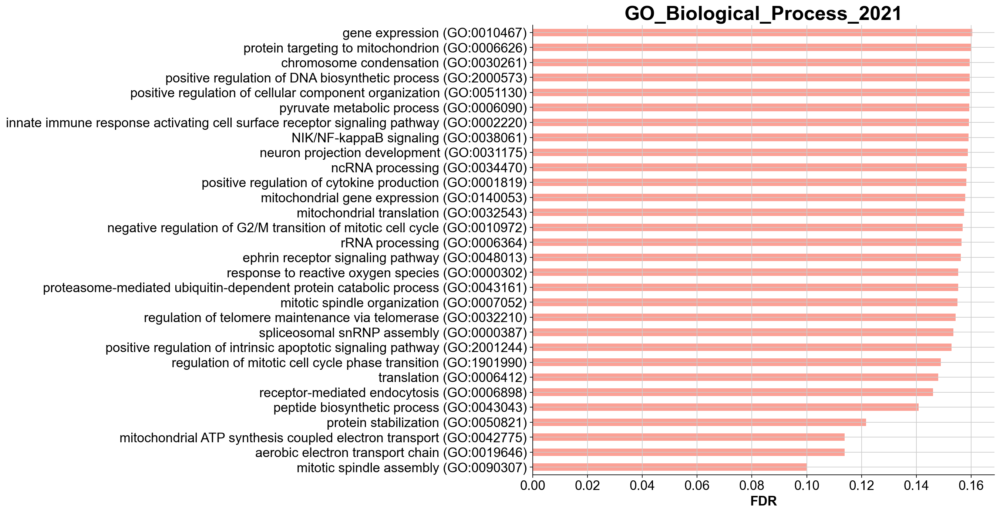

In [27]:
sc.settings.set_figure_params(dpi=80, facecolor='white')

top30 = significant_terms.sort_values('fdr', ascending=True).head(30)

top30.rename(columns={'fdr':'FDR'}, inplace=True)

gp.barplot(top30, column='FDR', top_term=30, title='GO_Biological_Process_2021', figsize=(10,10), ofname='/store/Projects/pantovski/IL10/GSEA_and_GO_figures/Ambient_RNA_Cleaned/Old IL10 vs DN GSEA GO BP.png')

gp.barplot(top30, column='FDR', top_term=30, title='GO_Biological_Process_2021', figsize=(10,10))

In [28]:
gs_res_IL10_vs_DN = gp.gsea(data=expression_matrix_IL10_vs_DN, # or data='./P53_resampling_data.txt'
                 gene_sets='GO_Molecular_Function_2021', # enrichr library names
                 cls= phenotype_list_IL10_vs_DN, # cls=class_vector
                 # set permutation_type to phenotype if samples >=15
                 permutation_type='phenotype',
                 permutation_num=100, # reduce number to speed up test
                 outdir=None,  # do not write output to disk
                 no_plot=True, # Skip plotting
                 method='signal_to_noise',
                 processes=4, seed= 7,
                 min_size = 15,
                 max_size = 500,
                 format='png')

#access the dataframe results throught res2d attribute
gs_res_IL10_vs_DN.res2d.to_csv('/store/Projects/pantovski/IL10/Combined/write/Ambient_RNA_Cleaned/Old_IL10_vs_DN_GSEA_GO_MF_2_UMI_5_percent_Combat_raw_SingleR.csv')

significant_terms = gs_res_IL10_vs_DN.res2d
significant_terms = significant_terms[significant_terms.pval < 0.05]
significant_terms = significant_terms[significant_terms.fdr < 0.25]
significant_terms.reset_index(inplace=True)
significant_terms

2022-05-05 13:05:42,520 Warning: Input data contains NA, filled NA with 0


,Term,es,nes,pval,fdr,geneset_size,matched_size,genes,ledge_genes
0,tubulin binding (GO:0015631),-0.467872,-1.896478,0.000000,0.040621,307,69,APC;B9D2;DST;NDRG1;DDX3X;HOOK3;TAOK1;MAP4K4;RC...,VAPA;PDCD5;CENPE;SVBP;KIF20B;ALDOA;UXT;STMN1;A...
1,ubiquitin-like protein ligase binding (GO:0044...,-0.423462,-1.843194,0.000000,0.051995,282,100,CUL5;APC;PATZ1;ARIH1;CCDC50;ITCH;RTN4;NFKBIA;J...,TMBIM6;JAK1;DNAJA1;SUMO3;ACTG1;UBE2K;EIF4E2;PS...
2,NADH dehydrogenase (quinone) activity (GO:0050...,-0.590644,-1.843946,0.000000,0.060931,35,34,NDUFS1;NDUFS4;NDUFA2;NDUFS5;NDUFS3;NDUFA1;NDUF...,NDUFS6;NDUFA5;NDUFA4;NDUFV2;NDUFS2;NDUFA9;NDUF...
3,NADH dehydrogenase (ubiquinone) activity (GO:0...,-0.590644,-1.843946,0.000000,0.060931,35,34,NDUFS1;NDUFS4;NDUFA2;NDUFS5;NDUFS3;NDUFA1;NDUF...,NDUFS6;NDUFA5;NDUFA4;NDUFV2;NDUFS2;NDUFA9;NDUF...
4,oxidoreduction-driven active transmembrane tra...,-0.570816,-1.903289,0.000000,0.081242,58,48,NDUFS1;NDUFS4;NDUFA2;UQCRC1;CYB5A;UQCRQ;UQCR10...,NDUFS6;NDUFA5;NDUFA4;COX7A2L;NDUFV2;NDUFS2;NDU...
5,ubiquitin protein ligase binding (GO:0031625),-0.407063,-1.685675,0.000000,0.159776,265,93,CUL5;APC;PATZ1;ARIH1;CCDC50;RTN4;NFKBIA;JUN;TX...,TMBIM6;JAK1;DNAJA1;ACTG1;UBE2K;EIF4E2;PSMA3;SP...
6,protein tyrosine phosphatase activity (GO:0004...,-0.528603,-1.572027,0.032258,0.176233,74,18,PTEN;PTPRA;PTPRC;PTPN2;PTPRE;PTP4A3;PTPN1;PTP4...,PTPN11;PTPN7;TIMM50;PGP;CDC25A;ACP1;CDKN3
7,endopeptidase inhibitor activity (GO:0004866),-0.552433,-1.612810,0.033898,0.178732,115,16,SLPI;ROCK1;APP;CAST;BIRC6;USP14;ANXA2;BST2;CST...,SPINT2;CST3;GAPDH;SERPINF1;UCHL5;CST7
8,microtubule binding (GO:0008017),-0.439061,-1.626069,0.000000,0.182794,232,56,APC;DST;NDRG1;HOOK3;MACF1;STIM1;MAP4K4;RCC2;HA...,VAPA;KNSTRN;CENPE;SVBP;KIF20B;UXT;KIF23;GAPDH;...
9,kinase binding (GO:0019900),-0.370339,-1.636485,0.000000,0.185696,461,127,IFNAR2;IQGAP1;RICTOR;APC;STAT3;MYCN;ZFP36;CYLD...,PRDX3;ELAVL1;CNTLN;DNAJC3;NPM1;PRKCD;HNRNPA0;G...


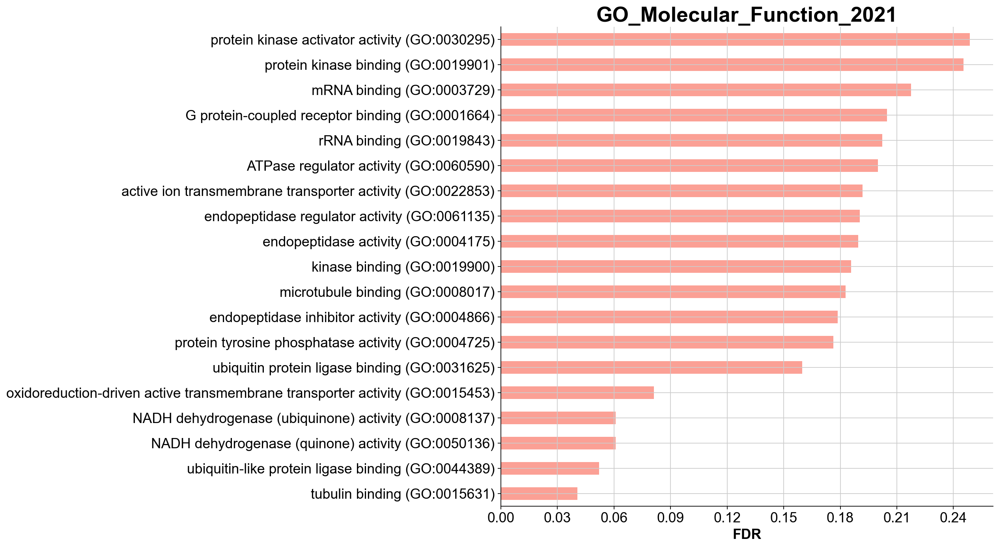

In [29]:
sc.settings.set_figure_params(dpi=80, facecolor='white')

top30 = significant_terms.sort_values('fdr', ascending=True).head(30)

top30.rename(columns={'fdr':'FDR'}, inplace=True)

gp.barplot(top30, column='FDR', top_term=30, title='GO_Molecular_Function_2021', figsize=(10,10), ofname='/store/Projects/pantovski/IL10/GSEA_and_GO_figures/Ambient_RNA_Cleaned/Old IL10 vs DN GSEA GO MF.png')

gp.barplot(top30, column='FDR', top_term=30, title='GO_Molecular_Function_2021', figsize=(10,10))

In [30]:
gs_res_IL10_vs_DN = gp.gsea(data=expression_matrix_IL10_vs_DN, # or data='./P53_resampling_data.txt'
                 gene_sets='GO_Cellular_Component_2021', # enrichr library names
                 cls= phenotype_list_IL10_vs_DN, # cls=class_vector
                 # set permutation_type to phenotype if samples >=15
                 permutation_type='phenotype',
                 permutation_num=100, # reduce number to speed up test
                 outdir=None,  # do not write output to disk
                 no_plot=True, # Skip plotting
                 method='signal_to_noise',
                 processes=4, seed= 7,
                 min_size = 15,
                 max_size = 500,
                 format='png')


#access the dataframe results throught res2d attribute
gs_res_IL10_vs_DN.res2d.to_csv('/store/Projects/pantovski/IL10/Combined/write/Ambient_RNA_Cleaned/Old_IL10_vs_DN_GSEA_GO_CC_2_UMI_5_percent_Combat_raw_SingleR.csv')

significant_terms = gs_res_IL10_vs_DN.res2d
significant_terms = significant_terms[significant_terms.pval < 0.05]
significant_terms = significant_terms[significant_terms.fdr < 0.25]
significant_terms.reset_index(inplace=True)
significant_terms

2022-05-05 13:06:16,379 Warning: Input data contains NA, filled NA with 0


,Term,es,nes,pval,fdr,geneset_size,matched_size,genes,ledge_genes
0,mitochondrial inner membrane (GO:0005743),-0.464584,-1.965487,0.000000,0.045500,328,179,SLC25A1;MRPS23;NDUFAF2;IMMT;TIMM9;PLA2G4A;MRPL...,SLC25A11;AIFM1;MRPS28;MRPS18C;MRPS10;NDUFA11;M...
1,mitochondrial membrane (GO:0031966),-0.435616,-1.915206,0.000000,0.048533,469,223,SLC25A1;KRAS;HK2;CYB5R3;MCL1;MRPS23;UBC;NDUFAF...,COX6B1;NDUFS3;OXA1L;NDUFA1;CYC1;MFF;TMEM14C;MR...
2,mitochondrial respiratory chain complex I (GO:...,-0.554882,-1.789299,0.000000,0.054600,42,37,NDUFS1;NDUFS4;NDUFB11;NDUFA2;NDUFS5;NDUFS3;NDU...,NDUFS6;NDUFA5;NDUFA4;NDUFV2;NDUFS2;NDUFA9;NDUF...
3,respiratory chain complex I (GO:0045271),-0.554882,-1.789299,0.000000,0.054600,42,37,NDUFS1;NDUFS4;NDUFB11;NDUFA2;NDUFS5;NDUFS3;NDU...,NDUFS6;NDUFA5;NDUFA4;NDUFV2;NDUFS2;NDUFA9;NDUF...
4,endocytic vesicle membrane (GO:0030666),-0.511417,-1.781664,0.022222,0.054600,158,34,TAPBP;CD74;UBC;APOE;WLS;CYBB;TAP1;B2M;SNAP23;C...,AP2S1;CYBA;VAMP8;CALR;ATP6V0C;TFRC;RAC2;AP2M1;...
5,spindle (GO:0005819),-0.492388,-1.804704,0.000000,0.056420,192,64,XIAP;TAF1D;CYLD;TFDP2;HAUS3;EPB41;TBL1XR1;MZT1...,NCOR1;CBX1;JTB;NUDCD2;DYNLL1;HNRNPU;NUP62;NUDC...
6,azurophil granule lumen (GO:0035578),-0.489767,-1.726224,0.000000,0.056622,90,44,TXNDC5;CYB5R3;TRAPPC1;DYNC1H1;FUCA1;ACLY;SDCBP...,PYCARD;GDI2;CREG1;FABP5;TUBB4B;PLAC8;PRDX6;CCT...
7,dendrite (GO:0030425),-0.466454,-1.703577,0.000000,0.057200,270,34,PTK2B;FXR1;MCRS1;SLC6A6;SOD1;PPP1R9B;DBNL;DHX3...,RACK1;ATXN10;ZWINT;RBM3;HSPA8;RIN3;RPL28;RPS6;...
8,lysosomal membrane (GO:0005765),-0.389429,-1.663398,0.000000,0.057200,330,82,DNAJC5;SPAG9;TMEM165;CD74;SPPL2A;TMEM179B;PRCP...,AP2S1;MGST1;ATP6V1G1;VAMP8;UBA1;GLIPR1;VAPA;TM...
9,polysomal ribosome (GO:0042788),-0.705937,-1.837294,0.021739,0.057200,30,29,DHX9;LARP4B;FMR1;LARP1;NUFIP2;RPS26;RPL31;RPL3...,RPL36;RPL32;RPL24;RPS23;RPL41;RPL39;RPS28;BTF3...


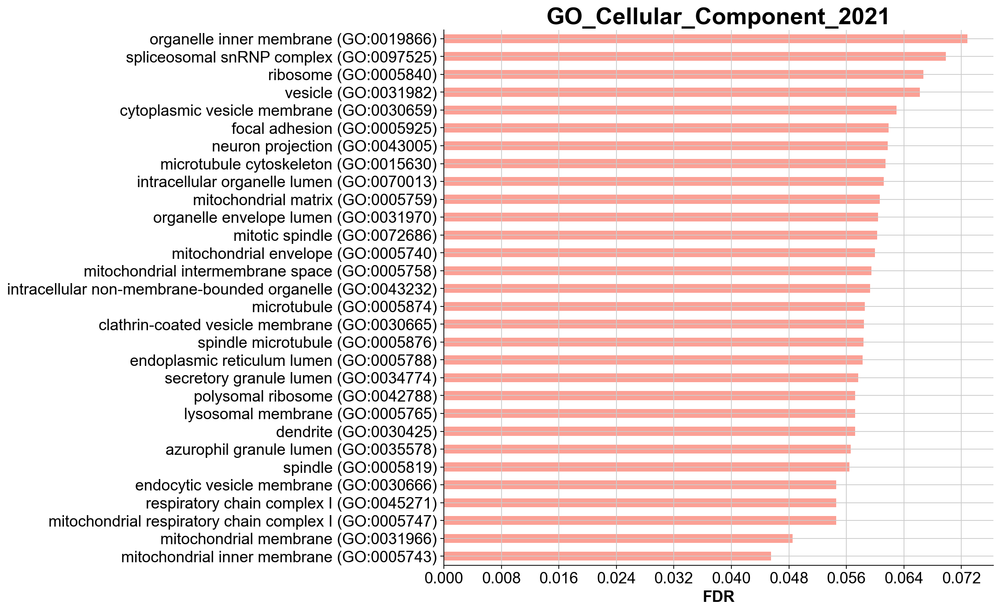

In [31]:
sc.settings.set_figure_params(dpi=80, facecolor='white')

top30 = significant_terms.sort_values('fdr', ascending=True).head(30)

top30.rename(columns={'fdr':'FDR'}, inplace=True)

gp.barplot(top30, column='FDR', top_term=30, title='GO_Cellular_Component_2021', figsize=(10,10), ofname='/store/Projects/pantovski/IL10/GSEA_and_GO_figures/Ambient_RNA_Cleaned/Old IL10 vs DN GSEA GO CC.png')

gp.barplot(top30, column='FDR', top_term=30, title='GO_Cellular_Component_2021', figsize=(10,10))

In [32]:
gs_res_IL10_vs_DN = gp.gsea(data=expression_matrix_IL10_vs_DN, # or data='./P53_resampling_data.txt'
                 gene_sets='KEGG_2019_Mouse', # enrichr library names
                 cls= phenotype_list_IL10_vs_DN, # cls=class_vector
                 # set permutation_type to phenotype if samples >=15
                 permutation_type='phenotype',
                 permutation_num=100, # reduce number to speed up test
                 outdir=None,  # do not write output to disk
                 no_plot=True, # Skip plotting
                 method='signal_to_noise',
                 processes=4, seed= 7,
                 min_size = 15,
                 max_size = 500,
                 format='png')


#access the dataframe results throught res2d attribute
gs_res_IL10_vs_DN.res2d.to_csv('/store/Projects/pantovski/IL10/Combined/write/Ambient_RNA_Cleaned/Old_IL10_vs_DN_GSEA_KEGG_2_UMI_5_percent_Combat_raw_SingleR.csv')

significant_terms = gs_res_IL10_vs_DN.res2d
significant_terms = significant_terms[significant_terms.pval < 0.05]
significant_terms = significant_terms[significant_terms.fdr < 0.25]
significant_terms.reset_index(inplace=True)
significant_terms

2022-05-05 13:06:50,842 Warning: Input data contains NA, filled NA with 0


,Term,es,nes,pval,fdr,geneset_size,matched_size,genes,ledge_genes
0,Huntington disease,-0.522558,-2.093212,0.000000,0.000000,192,115,CREB1;TGM2;DCTN4;SOD1;POLR2B;CASP8;POLR2C;HDAC...,NDUFB9;NDUFA7;ATP5G3;SDHB;POLR2D;SOD2;COX5A;TF...
1,Oxidative phosphorylation,-0.551578,-2.016949,0.000000,0.003921,134,91,PPA2;NDUFS1;COX17;SDHC;ATP6V1E1;NDUFS4;NDUFB11...,COX7B;NDUFS6;ATP6V1G1;NDUFA5;ATP5B;ATP5H;ATP6V...
2,Alzheimer disease,-0.525860,-2.043430,0.000000,0.005227,175,99,RTN4;PPP3CA;TNFRSF1A;PPP3CB;APOE;RTN3;CASP8;MA...,NDUFB9;NDUFA7;ATP5G3;SDHB;ATP2A2;COX5A;ATP5O;C...
3,Parkinson disease,-0.551779,-2.066520,0.000000,0.007841,144,93,PRKACB;UBE2J2;NDUFS1;SDHC;UBA7;NDUFS4;SLC18A2;...,NDUFB9;NDUFA7;ATP5G3;SDHB;COX5A;ATP5O;CYCS;COX...
4,Cardiac muscle contraction,-0.606985,-1.946433,0.000000,0.012546,78,26,ATP1A1;TPM1;UQCRC1;UQCRQ;UQCR10;COX6B1;CYC1;UQ...,ATP2A2;COX5A;ATP1B3;COX7B;TPM3;COX7A2L;UQCRC2;...
5,Ribosome,-0.619555,-1.909900,0.040000,0.023524,170,123,MRPL4;RSL24D1;MRPS7;UBA52;MRPL28;MRPL3;MRPL34;...,MRPL19;MRPL21;MRPL24;MRPL22;RPL3;RPL36;RPL32;M...
6,Thermogenesis,-0.468343,-1.889051,0.000000,0.029125,231,117,CREB1;KRAS;SMARCC2;NRAS;RPS6KA3;SMARCA4;PNPLA2...,NDUFB9;NDUFA7;ATP5G3;SDHB;COX5A;ATP5O;ACTG1;CO...
7,Non-alcoholic fatty liver disease (NAFLD),-0.502590,-1.864052,0.000000,0.031365,151,84,XBP1;ITCH;AKT1;JUN;TNFRSF1A;ADIPOR2;PIK3R1;ADI...,NDUFB9;NDUFA7;SDHB;CDC42;COX5A;CYCS;COX7B;NDUF...
8,Legionellosis,-0.618885,-1.866118,0.000000,0.035286,58,20,CLK1;NFKBIA;RAB1A;CASP8;SAR1A;NFKB1;RAB1B;CASP...,CYCS;EEF1G;HSPD1;SAR1B;CASP1;PYCARD;HSPA8;ARF1...
9,Retrograde endocannabinoid signaling,-0.499487,-1.774043,0.000000,0.084115,150,50,GNG2;PRKACB;GNG11;MAPK1;NDUFS1;NDUFS4;NDUFB11;...,GNG5;NDUFB9;NDUFA7;GNG10;NDUFS6;NDUFA5;NDUFA4;...


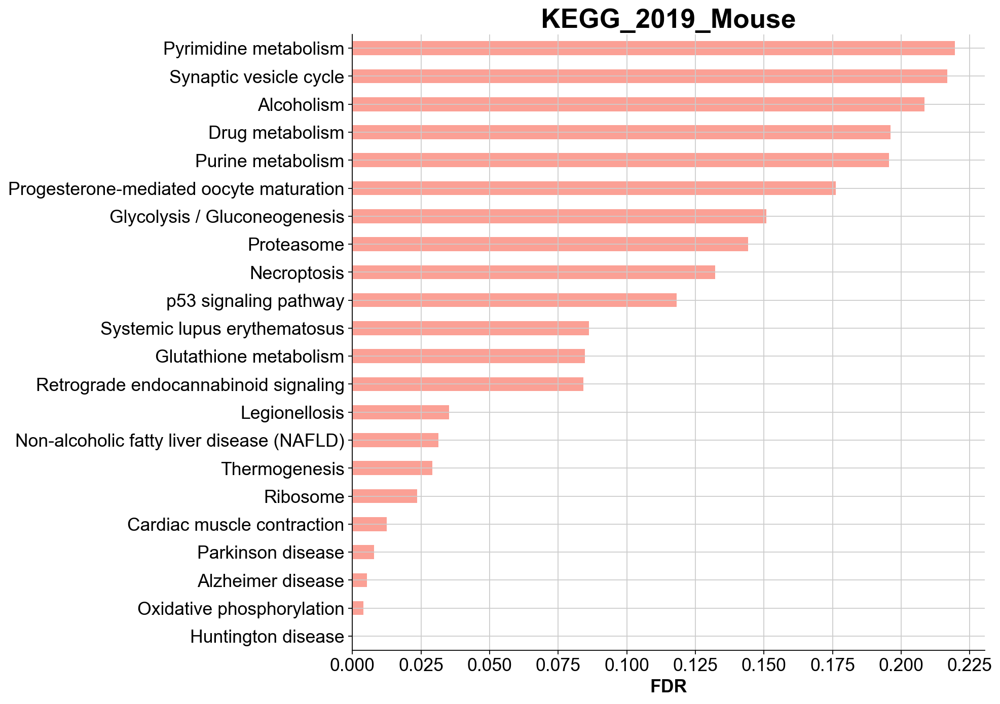

In [33]:
sc.settings.set_figure_params(dpi=80, facecolor='white')

top30 = significant_terms.sort_values('fdr', ascending=True).head(30)

top30.rename(columns={'fdr':'FDR'}, inplace=True)

gp.barplot(top30, column='FDR', top_term=30, title='KEGG_2019_Mouse', figsize=(10,10), ofname='/store/Projects/pantovski/IL10/GSEA_and_GO_figures/Ambient_RNA_Cleaned/Old IL10 vs DN GSEA KEGG.png')

gp.barplot(top30, column='FDR', top_term=30, title='KEGG_2019_Mouse', figsize=(10,10))

In [34]:
gs_res_IL10_vs_DN = gp.gsea(data=expression_matrix_IL10_vs_DN, # or data='./P53_resampling_data.txt'
                 gene_sets='WikiPathways_2019_Mouse', # enrichr library names
                 cls= phenotype_list_IL10_vs_DN, # cls=class_vector
                 # set permutation_type to phenotype if samples >=15
                 permutation_type='phenotype',
                 permutation_num=100, # reduce number to speed up test
                 outdir=None,  # do not write output to disk
                 no_plot=True, # Skip plotting
                 method='signal_to_noise',
                 processes=4, seed= 7,
                 min_size = 15,
                 max_size = 500,
                 format='png')

#access the dataframe results throught res2d attribute
gs_res_IL10_vs_DN.res2d.to_csv('/store/Projects/pantovski/IL10/Combined/write/Ambient_RNA_Cleaned/Old_IL10_vs_DN_GSEA_WIKI_2_UMI_5_percent_Combat_raw_SingleR.csv')

significant_terms = gs_res_IL10_vs_DN.res2d
significant_terms = significant_terms[significant_terms.pval < 0.05]
significant_terms = significant_terms[significant_terms.fdr < 0.25]
significant_terms.reset_index(inplace=True)
significant_terms

2022-05-05 13:07:25,382 Warning: Input data contains NA, filled NA with 0


,Term,es,nes,pval,fdr,geneset_size,matched_size,genes,ledge_genes
0,Electron Transport Chain WP295,-0.555883,-1.973111,0.000000,0.014192,103,74,NDUFS1;COX17;SDHC;NDUFS4;NDUFA2;UQCRC1;ATP5L;U...,NDUFB9;NDUFA7;ATP5G3;SDHB;COX5A;ATP5O;COX7B;ND...
1,Microglia Pathogen Phagocytosis Pathway WP3626,-0.628342,-1.880802,0.000000,0.014192,41,20,SYK;NCKAP1L;LYN;CYBB;PIK3R1;VAV1;PLCG2;VAV3;PI...,RAC2;ARPC1B;NCF1;FCER1G;NCF4;TYROBP;TREM3
2,Oxidative phosphorylation WP1248,-0.551455,-1.845675,0.000000,0.028384,62,46,ATP6AP2;NDUFS1;NDUFS4;NDUFA2;ATP5L;NDUFS5;ATP5...,NDUFB9;NDUFA7;ATP5G3;ATP5O;NDUFS6;NDUFA5;ATP5B...
3,Purine metabolism WP2185,-0.467700,-1.603575,0.035714,0.121644,171,55,POLR3H;GUK1;NT5C3;POLE4;DGUOK;POLR2B;POLD1;PRP...,POLD2;PPAT;GMPS;ADK;POLR1C;POLR2D;NME2;NME1;AD...
4,TYROBP Causal Network WP3625,-0.459086,-1.577923,0.018868,0.134822,58,25,SAMSN1;STAT5A;NCKAP1L;ZFP36L2;CD84;CAPG;PLEK;N...,LYL1;PYCARD;GPX1;C3;TYROBP;IGSF6
5,Proteasome Degradation WP519,-0.487652,-1.606217,0.022727,0.139552,52,45,RPN2;UBE2B;PSMB6;UBA7;PSMB7;NEDD4;RPN1;PSMD12;...,PSMA4;PSMD2;PSMB4;UBE2D2A;PSMA2;PSMC6;PSMC4;PS...
6,mRNA processing WP310,-0.331134,-1.507714,0.017241,0.143208,457,255,FXR1;DICER1;CLK1;SF3A1;RBM6;RBM43;HNRNPH1;CELF...,ACIN1;ILF3;SRSF1;SMC1A;SRP68;ILKAP;NIFK;TRA2B;...
7,p53 signaling WP2902,-0.538548,-1.628978,0.000000,0.147594,67,19,PTEN;MDM4;RCHY1;CASP8;CDK6;CCND1;CASP3;SHISA5;...,CDK4;COP1;CYCS;TRP53;CCNB2;RRM2;BAX;CCNB1;CDK1
8,Glycolysis and Gluconeogenesis WP157,-0.490575,-1.541834,0.030769,0.152956,51,24,HK2;SLC2A3;PFKP;HK1;GOT2;PDHB;MDH1;DLD;MPC2;EN...,PFKL;LDHB;LDHA;PKM;PDHA1;ALDOA;HK3;GAPDH;MPC1;...
9,Calcium Regulation in the Cardiac Cell WP553,-0.413556,-1.510511,0.020408,0.157529,147,35,GNG2;PRKACB;ATP2B1;YWHAQ;RGS10;FKBP1A;PRKAR1A;...,GNG12;ATP2A3;RGS2;PRKCD;PKIG;YWHAG;GNG5;RGS1;A...


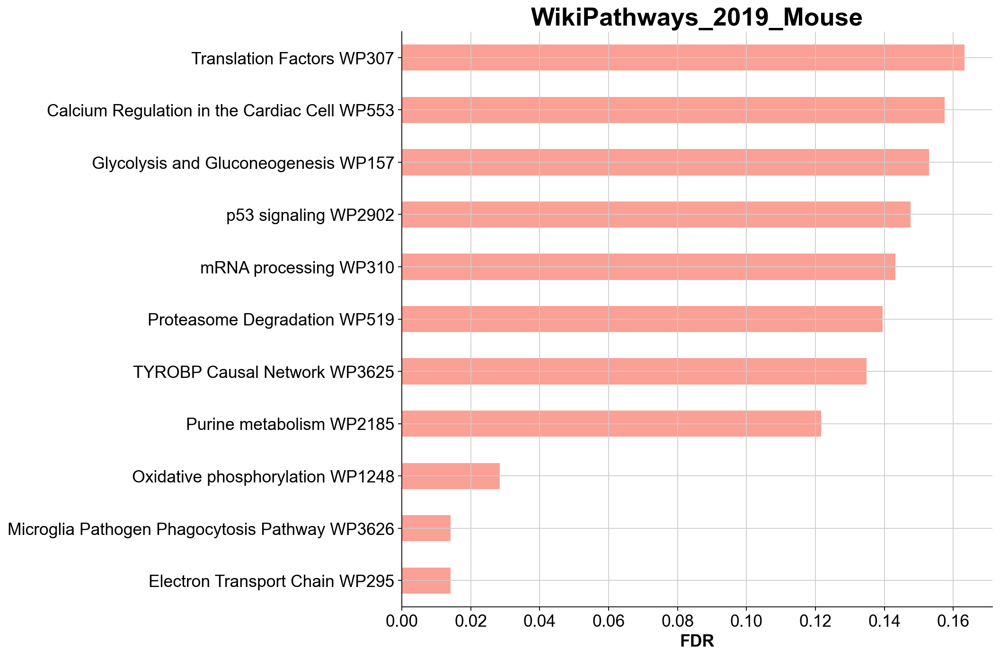

In [35]:
sc.settings.set_figure_params(dpi=80, facecolor='white')

top30 = significant_terms.sort_values('fdr', ascending=True).head(30)

top30.rename(columns={'fdr':'FDR'}, inplace=True)

gp.barplot(top30, column='FDR', top_term=30, title='WikiPathways_2019_Mouse', figsize=(10,10), ofname='/store/Projects/pantovski/IL10/GSEA_and_GO_figures/Ambient_RNA_Cleaned/Old IL10 vs DN GSEA WIKI.png')

gp.barplot(top30, column='FDR', top_term=30, title='WikiPathways_2019_Mouse', figsize=(10,10))

In [36]:
groups = ['IL10_Old', 'IL10ra_Old']
IL10_vs_IL10ra_GSEA = Old_HSC[Old_HSC.obs.IL10.isin(groups)]

In [37]:
expression_matrix_IL10_vs_IL10ra = pd.DataFrame(IL10_vs_IL10ra_GSEA.X)
expression_matrix_IL10_vs_IL10ra.columns = IL10_vs_IL10ra_GSEA.var.index
expression_matrix_IL10_vs_IL10ra = expression_matrix_IL10_vs_IL10ra.T
gene_list = list(IL10_vs_IL10ra_GSEA.var.index)
column_values = pd.Series(gene_list)
expression_matrix_IL10_vs_IL10ra.insert(loc=0, column='Description', value=column_values)
expression_matrix_IL10_vs_IL10ra.insert(loc=0, column='NAME', value=gene_list)
expression_matrix_IL10_vs_IL10ra['NAME'] = expression_matrix_IL10_vs_IL10ra['NAME'].str.upper()
expression_matrix_IL10_vs_IL10ra.index = range(len(expression_matrix_IL10_vs_IL10ra.index))

In [38]:
phenotype_list_IL10_vs_IL10ra = list(IL10_vs_IL10ra_GSEA.obs.IL10)

In [39]:
gs_res_IL10_vs_IL10ra = gp.gsea(data=expression_matrix_IL10_vs_IL10ra, # or data='./P53_resampling_data.txt'
                 gene_sets='GO_Biological_Process_2021', # enrichr library names
                 cls= phenotype_list_IL10_vs_IL10ra, # cls=class_vector
                 # set permutation_type to phenotype if samples >=15
                 permutation_type='phenotype',
                 permutation_num=100, # reduce number to speed up test
                 outdir=None,  # do not write output to disk
                 no_plot=True, # Skip plotting
                 method='signal_to_noise',
                 processes=4, seed= 7,
                 min_size = 15,
                 max_size = 500,
                 format='png',)

#access the dataframe results throught res2d attribute
gs_res_IL10_vs_IL10ra.res2d.to_csv('/store/Projects/pantovski/IL10/Combined/write/Ambient_RNA_Cleaned/Old_IL10_vs_IL10ra_GSEA_GO_BP_2_UMI_5_percent_Combat_raw_SingleR.csv', index=None)

significant_terms = gs_res_IL10_vs_IL10ra.res2d
significant_terms = significant_terms[significant_terms.pval < 0.05]
significant_terms = significant_terms[significant_terms.fdr < 0.25]
significant_terms.reset_index(inplace=True)
significant_terms

2022-05-05 13:07:58,000 Warning: Input data contains NA, filled NA with 0


,Term,es,nes,pval,fdr,geneset_size,matched_size,genes,ledge_genes
0,organic substance transport (GO:0071702),-0.600719,-1.987797,0.000000,0.094707,136,25,SPNS2;TAP1;PPT1;MYH9;CHMP2A;HSP90B1;SLC50A1;AT...,HIKESHI;NME4;SLC48A1;CHMP3;ARL6IP5;GM2A;RAB38;...
1,ribosomal large subunit assembly (GO:0000027),-0.713597,-1.822592,0.000000,0.098151,25,16,RSL24D1;MDN1;PPAN;NOP53;BRIX1;RRS1;RPLP0;RPL24...,RRS1;RPLP0;RPL24;RPL3;RPF2;RPL23A;MRPL20;RPL5;...
2,rRNA metabolic process (GO:0016072),-0.557892,-1.824166,0.000000,0.103317,162,125,PDCD11;KRR1;RRP1;C1D;XRN1;NOL8;RCL1;NVL;MDN1;D...,RPL26;POP5;RPL39;RPLP0;IMP4;RPL36;NOP58;RPS24;...
3,response to interferon-gamma (GO:0034341),-0.673612,-2.015767,0.000000,0.103317,80,15,CD74;STAT1;SP100;CD47;LGALS9;BST2;SYNCRIP;IFIT...,SYNCRIP;IFITM3;GBP7;RPL13A;IRF8;GAPDH;CASP1;IF...
4,rRNA processing (GO:0006364),-0.543421,-1.831048,0.000000,0.107143,173,134,PDCD11;KRR1;RRP1;C1D;RIOK1;NOL8;RCL1;NVL;MDN1;...,RPL26;POP5;RPL39;RPLP0;IMP4;RPL36;NOP58;RPS24;...
...,...,...,...,...,...,...,...,...,...
74,mitochondrion organization (GO:0007005),-0.418736,-1.569461,0.026316,0.235264,175,65,PARP1;ATAD3A;MTFR1L;PHB;DNM1L;TIMM9;TIMM44;HK2...,FIS1;AIFM1;MTX2;FMC1;OXA1L;PRDX3;TIMM17B;CHCHD...
75,regulation of cellular response to stress (GO:...,-0.408066,-1.558479,0.017544,0.241865,118,50,SMG1;USP19;ROCK2;RPA1;NUPR1;DNAJC7;NUP98;SEC13...,PTGES3;NUP50;NUP62;NUP214;HSP90AB1;RANBP2;IER3...
76,antigen processing and presentation of exogeno...,-0.457188,-1.556324,0.038462,0.242638,78,57,TAPBP;TAP1;CYBB;B2M;PSMB6;PSMB7;PSMC3;PSMD12;P...,PSMB2;VAMP3;PSMD2;PSMD6;IKBKB;PSMC4;PSME1;CYBA...
77,antigen processing and presentation of exogeno...,-0.458697,-1.559377,0.038462,0.243676,73,54,TAPBP;TAP1;CYBB;B2M;PSMB6;PSMB7;PSMC3;PSMD12;P...,PSMB2;VAMP3;PSMD2;PSMD6;IKBKB;PSMC4;PSME1;CYBA...


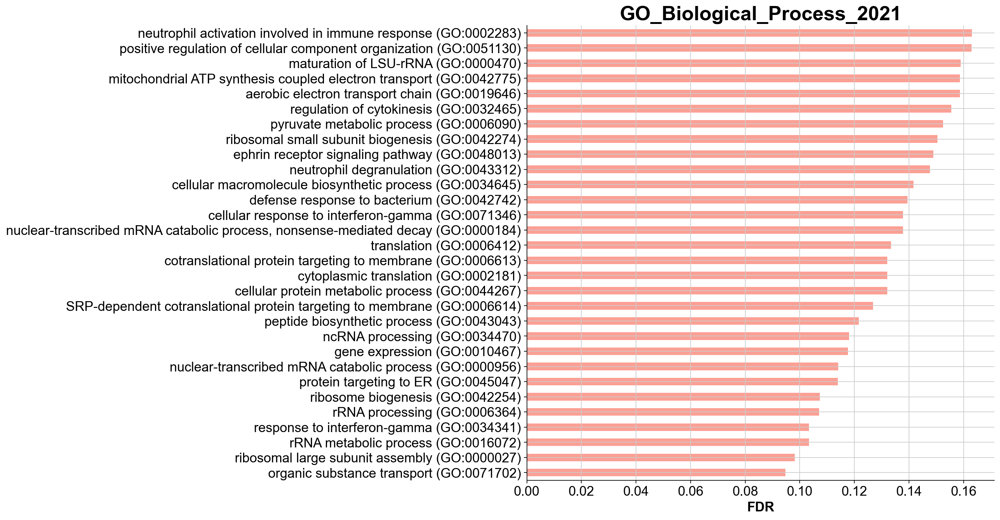

In [40]:
sc.settings.set_figure_params(dpi=80, facecolor='white')

top30 = significant_terms.sort_values('fdr', ascending=True).head(30)

top30.rename(columns={'fdr':'FDR'}, inplace=True)

gp.barplot(top30, column='FDR', top_term=30, title='GO_Biological_Process_2021', figsize=(10,10), ofname='/store/Projects/pantovski/IL10/GSEA_and_GO_figures/Ambient_RNA_Cleaned/Old IL10 vs IL10ra GSEA GO BP.png')

gp.barplot(top30, column='FDR', top_term=30, title='GO_Biological_Process_2021', figsize=(10,10))

In [41]:
gs_res_IL10_vs_IL10ra = gp.gsea(data=expression_matrix_IL10_vs_IL10ra, # or data='./P53_resampling_data.txt'
                 gene_sets='GO_Molecular_Function_2021', # enrichr library names
                 cls= phenotype_list_IL10_vs_IL10ra, # cls=class_vector
                 # set permutation_type to phenotype if samples >=15
                 permutation_type='phenotype',
                 permutation_num=100, # reduce number to speed up test
                 outdir=None,  # do not write output to disk
                 no_plot=True, # Skip plotting
                 method='signal_to_noise',
                 processes=4, seed= 7,
                 min_size = 15,
                 max_size = 500,
                 format='png')

#access the dataframe results throught res2d attribute
gs_res_IL10_vs_IL10ra.res2d.to_csv('/store/Projects/pantovski/IL10/Combined/write/Ambient_RNA_Cleaned/Old_IL10_vs_IL10ra_GSEA_GO_MF_2_UMI_5_percent_Combat_raw_SingleR.csv')

significant_terms = gs_res_IL10_vs_IL10ra.res2d
significant_terms = significant_terms[significant_terms.pval < 0.05]
significant_terms = significant_terms[significant_terms.fdr < 0.25]
significant_terms.reset_index(inplace=True)
significant_terms

2022-05-05 13:08:17,117 Warning: Input data contains NA, filled NA with 0


,Term,es,nes,pval,fdr,geneset_size,matched_size,genes,ledge_genes
0,tubulin binding (GO:0015631),-0.492330,-1.940446,0.000000,0.068403,307,69,RCC2;B9D2;APC;EZR;HOOK3;NDRG1;TBCA;S100A9;DST;...,KIF5B;MAP4K4;DRG1;CENPE;CEP57;GABARAPL1;DNM2;S...
1,NADH dehydrogenase (quinone) activity (GO:0050...,-0.538445,-1.765451,0.000000,0.126545,35,34,NDUFS4;NDUFS1;NDUFA2;NDUFV3;NDUFS8;NDUFS5;NDUF...,NDUFS6;NDUFA7;NDUFV1;NDUFB9;NDUFA5;NDUFA13;NDU...
2,NADH dehydrogenase (ubiquinone) activity (GO:0...,-0.538445,-1.765451,0.000000,0.126545,35,34,NDUFS4;NDUFS1;NDUFA2;NDUFV3;NDUFS8;NDUFS5;NDUF...,NDUFS6;NDUFA7;NDUFV1;NDUFB9;NDUFA5;NDUFA13;NDU...
3,ubiquitin-like protein ligase binding (GO:0044...,-0.408176,-1.729506,0.000000,0.128255,282,100,CUL5;ARIH1;NFKBIA;PATZ1;APC;BCL2;RTN4;ITCH;HSP...,SUMO3;CALR;PCBP2;DNAJA1;ACTG1;UBE2K;POLR2A;GSK...
4,ubiquitin protein ligase binding (GO:0031625),-0.401775,-1.680746,0.000000,0.162457,265,93,CUL5;ARIH1;NFKBIA;PATZ1;APC;BCL2;RTN4;HSPBP1;C...,UBE2K;POLR2A;GSK3B;TMBIM6;SLC25A5;EIF4E2;RPL23...
5,endopeptidase activity (GO:0004175),-0.468552,-1.688414,0.000000,0.166121,315,56,CTSS;USP48;SENP1;KLK8;PMPCB;USP24;PSMB6;USP34;...,CTSB;PSMB9;PSMB1;TPP2;PDIA3;PSMA5;CTSH;USP8;PA...
6,microtubule binding (GO:0008017),-0.477987,-1.772508,0.000000,0.205209,232,56,RCC2;MACF1;APC;EZR;HOOK3;NDRG1;S100A9;DST;STIM...,KIF5B;MAP4K4;MAPRE1;DRG1;CENPE;KNSTRN;CEP57;DN...
7,protein kinase activator activity (GO:0030295),-0.551166,-1.610135,0.034483,0.212049,63,22,RICTOR;IQGAP1;DDX3X;NCKAP1L;ABI1;MARK2;TAOK1;M...,STK4;CALM3;CALM2;RGCC;INCENP;RPLP1;TPX2
8,organic anion transmembrane transporter activi...,-0.565962,-1.615024,0.037736,0.214709,144,16,SLC25A1;SLC6A6;SLC38A1;SLC3A2;MFSD10;SLC38A2;S...,ABCG2;SLCO3A1;MPC1;SLC4A8
9,kinase binding (GO:0019900),-0.367819,-1.560854,0.000000,0.247960,461,127,IFNAR2;LIMS1;CCND1;RICTOR;PARP1;MSH2;RCC2;RHOB...,PIH1D1;NPM1;PPP1CC;CKS2;CDC37;JTB;PPP1R15A;CEP...


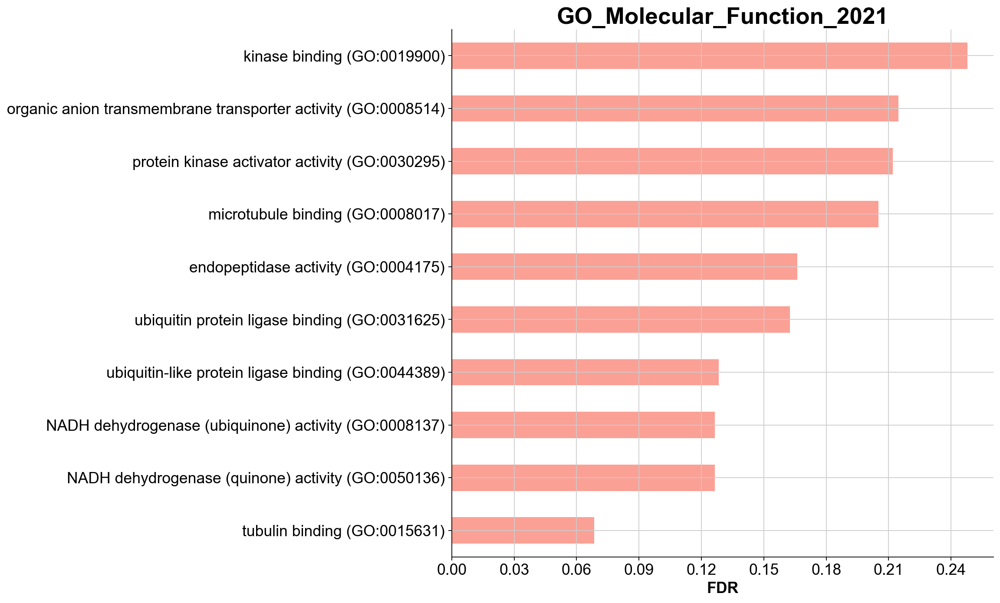

In [42]:
sc.settings.set_figure_params(dpi=80, facecolor='white')

top30 = significant_terms.sort_values('fdr', ascending=True).head(30)

top30.rename(columns={'fdr':'FDR'}, inplace=True)

gp.barplot(top30, column='FDR', top_term=30, title='GO_Molecular_Function_2021', figsize=(10,10), ofname='/store/Projects/pantovski/IL10/GSEA_and_GO_figures/Ambient_RNA_Cleaned/Old IL10 vs IL10ra GSEA GO MF.png')

gp.barplot(top30, column='FDR', top_term=30, title='GO_Molecular_Function_2021', figsize=(10,10))

In [43]:
gs_res_IL10_vs_IL10ra = gp.gsea(data=expression_matrix_IL10_vs_IL10ra, # or data='./P53_resampling_data.txt'
                 gene_sets='GO_Cellular_Component_2021', # enrichr library names
                 cls= phenotype_list_IL10_vs_IL10ra, # cls=class_vector
                 # set permutation_type to phenotype if samples >=15
                 permutation_type='phenotype',
                 permutation_num=100, # reduce number to speed up test
                 outdir=None,  # do not write output to disk
                 no_plot=True, # Skip plotting
                 method='signal_to_noise',
                 processes=4, seed= 7,
                 min_size = 15,
                 max_size = 500,
                 format='png')


#access the dataframe results throught res2d attribute
gs_res_IL10_vs_IL10ra.res2d.to_csv('/store/Projects/pantovski/IL10/Combined/write/Ambient_RNA_Cleaned/Old_IL10_vs_IL10ra_GSEA_GO_CC_2_UMI_5_percent_Combat_raw_SingleR.csv')

significant_terms = gs_res_IL10_vs_IL10ra.res2d
significant_terms = significant_terms[significant_terms.pval < 0.05]
significant_terms = significant_terms[significant_terms.fdr < 0.25]
significant_terms.reset_index(inplace=True)
significant_terms

2022-05-05 13:08:24,324 Warning: Input data contains NA, filled NA with 0


,Term,es,nes,pval,fdr,geneset_size,matched_size,genes,ledge_genes
0,cell-substrate junction (GO:0030055),-0.482040,-2.020176,0.000000,0.000000,394,168,KRAS;LIMS1;ITGA6;RAB10;PTK2B;IRF2;RHOB;EZR;ITG...,NPM1;VIM;CALR;PCBP2;RPLP2;PPP1CC;G3BP1;SNAP23;...
1,focal adhesion (GO:0005925),-0.483690,-1.988721,0.000000,0.009237,387,166,KRAS;LIMS1;ITGA6;RAB10;PTK2B;IRF2;RHOB;EZR;ITG...,NPM1;VIM;CALR;PCBP2;RPLP2;PPP1CC;G3BP1;SNAP23;...
2,polysomal ribosome (GO:0042788),-0.701042,-1.813097,0.022727,0.047209,30,29,DHX9;LARP4B;FMR1;LARP1;NUFIP2;RPS26;RPL41;RPL3...,RPL39;RPL36;RPL24;BTF3;RPL32;RPS23;EIF3H;RPL10...
3,postsynaptic density (GO:0014069),-0.620399,-1.836132,0.021277,0.047502,138,29,FXR1;PTK2B;DBNL;SIPA1L1;ADD3;DTNBP1;FMR1;ADD1;...,DNM2;RPLP0;RPS19;RPL14;FABP5;RPS13;RPL38;RPL12...
4,cytosolic small ribosomal subunit (GO:0022627),-0.760666,-1.821710,0.000000,0.048492,40,34,EIF2A;UBA52;RPS27L;RPS17;RPS26;MRPS11;RPS8;RPS...,RPS8;RPS24;RPS19;RPSA;RPS23;RPS13;RPS28;RPS29;...
5,azurophil granule (GO:0042582),-0.463668,-1.846241,0.000000,0.049262,155,75,TXNDC5;CYB5R3;DNAJC5;PRCP;TRAPPC1;ACLY;FUCA1;C...,PSMD1;GUSB;LAMP2;ANXA2;VAT1;SNAP23;CD63;BRI3;P...
6,lysosomal membrane (GO:0005765),-0.424463,-1.793562,0.000000,0.050381,330,82,CD74;ATP13A2;DNAJC5;TMEM165;PRCP;CKAP4;SPAG9;U...,IFITM3;SLC48A1;UBA1;VAPA;VAMP8;CTSA;MGST1;ATP6...
7,azurophil granule lumen (GO:0035578),-0.530635,-1.865787,0.000000,0.051725,90,44,TXNDC5;CYB5R3;TRAPPC1;ACLY;FUCA1;DYNC1H1;MAPK1...,GM2A;CTSA;PRDX6;CREG1;FABP5;ACTR2;GDI2;PYCARD;...
8,secretory granule lumen (GO:0034774),-0.420024,-1.798574,0.000000,0.053572,316,133,PF4;TXNDC5;SPTAN1;SLPI;CYB5R3;CDC37L1;PRDX4;CY...,PTPN6;PSMD1;GUSB;ANXA2;OLA1;GTPBP2;PSMD7;TMSB4...
9,mitochondrial matrix (GO:0005759),-0.416063,-1.735828,0.000000,0.056739,348,118,ME2;SOD1;CS;MRPL48;IARS2;IDH3B;TIMM44;OXCT1;DG...,SUCLG1;PRDX3;MDH2;NDUFS3;ARL2;FXN;MRPL11;SHMT2...


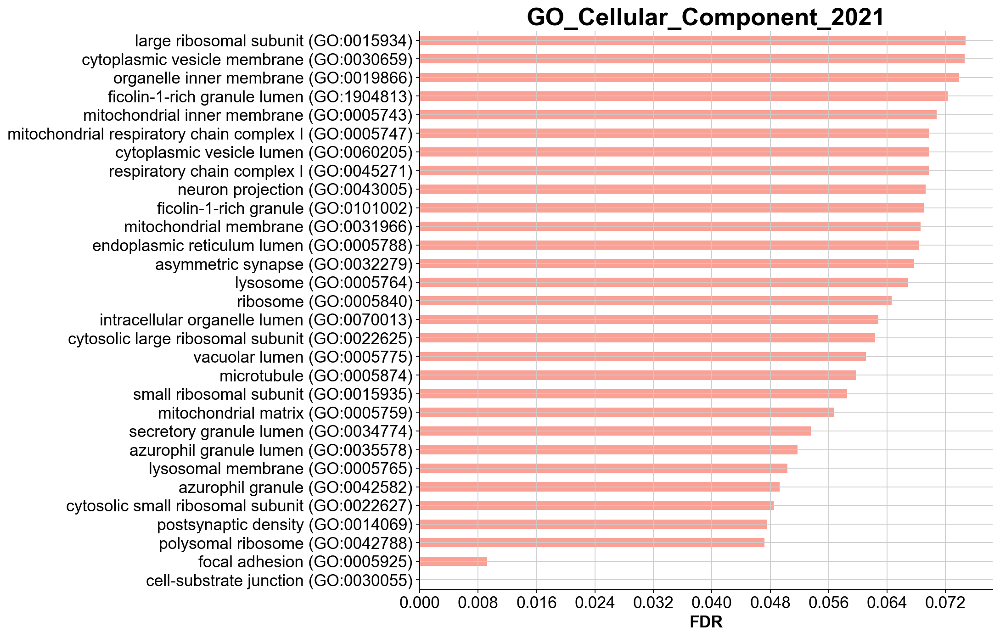

In [44]:
sc.settings.set_figure_params(dpi=80, facecolor='white')

top30 = significant_terms.sort_values('fdr', ascending=True).head(30)

top30.rename(columns={'fdr':'FDR'}, inplace=True)

gp.barplot(top30, column='FDR', top_term=30, title='GO_Cellular_Component_2021', figsize=(10,10), ofname='/store/Projects/pantovski/IL10/GSEA_and_GO_figures/Ambient_RNA_Cleaned/Old IL10 vs IL10ra GSEA GO CC.png')

gp.barplot(top30, column='FDR', top_term=30, title='GO_Cellular_Component_2021', figsize=(10,10))

In [45]:
gs_res_IL10_vs_IL10ra = gp.gsea(data=expression_matrix_IL10_vs_IL10ra, # or data='./P53_resampling_data.txt'
                 gene_sets='KEGG_2019_Mouse', # enrichr library names
                 cls= phenotype_list_IL10_vs_IL10ra, # cls=class_vector
                 # set permutation_type to phenotype if samples >=15
                 permutation_type='phenotype',
                 permutation_num=100, # reduce number to speed up test
                 outdir=None,  # do not write output to disk
                 no_plot=True, # Skip plotting
                 method='signal_to_noise',
                 processes=4, seed= 7,
                 min_size = 15,
                 max_size = 500,
                 format='png')


#access the dataframe results throught res2d attribute
gs_res_IL10_vs_IL10ra.res2d.to_csv('/store/Projects/pantovski/IL10/Combined/write/Ambient_RNA_Cleaned/Old_IL10_vs_IL10ra_GSEA_KEGG_2_UMI_5_percent_Combat_raw_SingleR.csv')

significant_terms = gs_res_IL10_vs_IL10ra.res2d
significant_terms = significant_terms[significant_terms.pval < 0.05]
significant_terms = significant_terms[significant_terms.fdr < 0.25]
significant_terms.reset_index(inplace=True)
significant_terms

2022-05-05 13:08:31,667 Warning: Input data contains NA, filled NA with 0


,Term,es,nes,pval,fdr,geneset_size,matched_size,genes,ledge_genes
0,Salmonella infection,-0.516904,-1.705245,0.018182,0.096563,78,33,PKN2;ROCK2;FOS;DYNC1H1;ACTB;ROCK1;MAPK1;JUN;WA...,ARPC1A;ACTG1;CDC42;DYNC1I2;RAC1;ARPC4;PFN1;RAB...
1,Tuberculosis,-0.446059,-1.710312,0.000000,0.102336,178,60,CTSS;CREB1;SYK;CD74;AKT1;CEBPG;EEA1;PPP3CB;BCL...,HSPA9;CALM3;RAB7;CALM2;RAB5C;ATP6V0C;CAMK2D;EP...
2,Non-alcoholic fatty liver disease (NAFLD),-0.469849,-1.726003,0.020408,0.102336,151,84,AKT1;ITCH;TGFB1;XBP1;ADIPOR2;UQCRC1;ATF4;NDUFS...,CYCS;NDUFV1;NDUFB9;CDC42;GSK3B;COX7C;SDHB;NDUF...
3,Glucagon signaling pathway,-0.513892,-1.718801,0.019231,0.102941,102,28,CREB1;AKT1;PPP3CB;PPP4R3B;PRKACB;PPP3CA;ATF4;C...,PRMT1;GNAS;CREBBP;LDHB;PFKL;LDHA;CALM3;G6PC3;P...
4,Systemic lupus erythematosus,-0.628844,-1.728711,0.000000,0.107345,143,27,H2-AA;H2-EB1;H2-AB1;SNRPD3;HIST1H2BC;SSB;H2-DM...,H2AFJ;H3F3A;HIST1H2AE;H3F3B;H2AFY;C3;H2AFX;HIS...
5,Alzheimer disease,-0.463418,-1.732697,0.021739,0.113356,175,99,PPP3CB;RTN4;PPP3CA;UQCRC1;MAPK1;APOE;RTN3;APP;...,ATP5O;CYCS;ATP5H;NDUFV1;NDUFB9;GSK3B;COX7C;ATP...
6,Legionellosis,-0.543633,-1.741832,0.020833,0.118954,58,20,NFKBIA;CLK1;SAR1A;RAB1A;VCP;CASP3;CASP8;NFKB1;...,SAR1B;PYCARD;HSPA8;C3;ARF1;CASP1;EEF1A1
7,Oxidative phosphorylation,-0.489143,-1.747407,0.020408,0.125951,134,91,COX17;PPA2;UQCRC1;NDUFS4;NDUFS1;UQCRQ;NDUFA2;N...,ATP5O;ATP5H;NDUFV1;NDUFB9;ATP5K;COX7C;ATP6V1B2...
8,Endocytosis,-0.401907,-1.663148,0.017241,0.130871,269,89,RAB10;H2-Q7;ACAP1;EEA1;ARF3;GIT2;ITCH;SNF8;CBL...,SPG21;CAPZA2;ARPC1A;ARF6;SNX1;VPS35;VPS29;CDC4...
9,Huntington disease,-0.483844,-1.820181,0.020408,0.136447,192,115,CREB1;DCTN4;PPIF;SOD1;POLR2C;UQCRC1;HDAC2;NDUF...,ATP5O;CYCS;ATP5H;NDUFV1;NDUFB9;SOD2;POLR2D;RES...


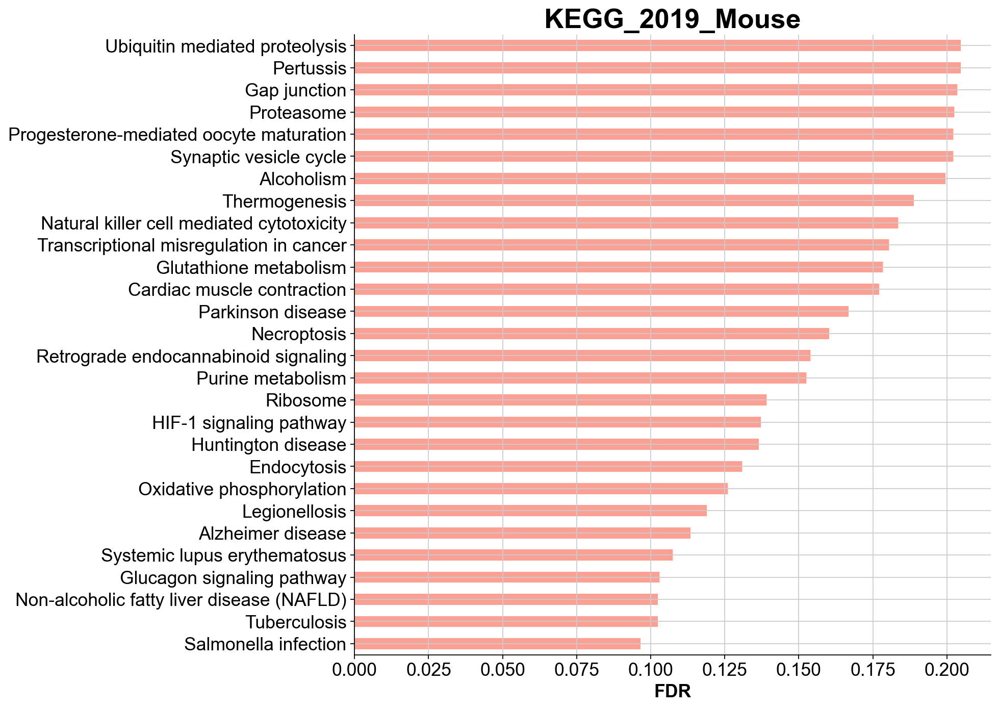

In [46]:
sc.settings.set_figure_params(dpi=80, facecolor='white')

top30 = significant_terms.sort_values('fdr', ascending=True).head(30)

top30.rename(columns={'fdr':'FDR'}, inplace=True)

gp.barplot(top30, column='FDR', top_term=30, title='KEGG_2019_Mouse', figsize=(10,10), ofname='/store/Projects/pantovski/IL10/GSEA_and_GO_figures/Ambient_RNA_Cleaned/Old IL10 vs IL10ra GSEA KEGG.png')

gp.barplot(top30, column='FDR', top_term=30, title='KEGG_2019_Mouse', figsize=(10,10))

In [47]:
gs_res_IL10_vs_IL10ra = gp.gsea(data=expression_matrix_IL10_vs_IL10ra, # or data='./P53_resampling_data.txt'
                 gene_sets='WikiPathways_2019_Mouse', # enrichr library names
                 cls= phenotype_list_IL10_vs_IL10ra, # cls=class_vector
                 # set permutation_type to phenotype if samples >=15
                 permutation_type='phenotype',
                 permutation_num=100, # reduce number to speed up test
                 outdir=None,  # do not write output to disk
                 no_plot=True, # Skip plotting
                 method='signal_to_noise',
                 processes=4, seed= 7,
                 min_size = 15,
                 max_size = 500,
                 format='png')

#access the dataframe results throught res2d attribute
gs_res_IL10_vs_IL10ra.res2d.to_csv('/store/Projects/pantovski/IL10/Combined/write/Ambient_RNA_Cleaned/Old_IL10_vs_IL10ra_GSEA_WIKI_2_UMI_5_percent_Combat_raw_SingleR.csv')

significant_terms = gs_res_IL10_vs_IL10ra.res2d
significant_terms = significant_terms[significant_terms.pval < 0.05]
significant_terms = significant_terms[significant_terms.fdr < 0.25]
significant_terms.reset_index(inplace=True)
significant_terms

2022-05-05 13:08:38,285 Warning: Input data contains NA, filled NA with 0


,Term,es,nes,pval,fdr,geneset_size,matched_size,genes,ledge_genes
0,Glycolysis and Gluconeogenesis WP157,-0.573316,-1.818175,0.000000,0.040080,51,24,PFKP;SLC2A3;GOT2;HK1;HK2;MDH1;DLD;MPC2;MDH2;PG...,LDHB;PFKL;LDHA;PDHA1;PKM;ALDOA;MPC1;GAPDH;GPI1...
1,Cytoplasmic Ribosomal Proteins WP163,-0.749258,-1.829043,0.000000,0.080160,92,76,RPS6KA1;RPS6KA3;RPS17;RPS26;RPL41;RPLP2;RPL4;R...,RPL26;RPL39;RPLP0;RPS8;RPL36;RPS24;RPL27;RPL24...
2,Electron Transport Chain WP295,-0.497741,-1.704970,0.020000,0.122912,103,74,COX17;UQCRC1;NDUFS4;NDUFS1;UQCRQ;NDUFA2;UQCR10...,COX7B;NDUFS6;NDUFA7;ATP5O;ATP5H;NDUFV1;NDUFB9;...
3,Translation Factors WP307,-0.443977,-1.629288,0.017857,0.144289,50,40,EIF2S3Y;EIF2B5;EIF4E;EEF2K;EIF4G2;EIF4G3;EIF3D...,EIF2S2;EIF1;EIF3C;EIF4A2;EIF3G;EIF4B;EEF1G;EIF...
4,Purine metabolism WP2185,-0.440863,-1.613858,0.000000,0.144289,171,55,POLR3H;GUK1;POLE4;POLD1;POLR2C;DGUOK;PRIM1;NT5...,POLR2I;PPAT;POLD2;ADSL;NME1;GMPS;PDE4D;POLR1C;...
5,Proteasome Degradation WP519,-0.470995,-1.637321,0.019608,0.164329,52,45,UBA7;PSMB6;RPN2;PSMB7;NEDD4;RPN1;UBE2B;PSMC3;P...,PSMB2;PSMD2;PSMD6;UBE2D3;PSMC4;PSME1;PSME2;PSM...
6,Microglia Pathogen Phagocytosis Pathway WP3626,-0.584191,-1.543780,0.048387,0.182365,41,20,SYK;CYBB;NCKAP1L;LYN;VAV3;VAV1;PIK3CG;PIK3R1;P...,RAC2;NCF1;FCER1G;ARPC1B;NCF4;TYROBP;TREM3
7,Oxidative phosphorylation WP1248,-0.486341,-1.557895,0.021739,0.190094,62,46,NDUFS4;NDUFS1;NDUFA2;ATP6AP2;NDUFV3;NDUFS8;NDU...,ATP5B;NDUFA4;NDUFS6;NDUFA7;ATP5O;ATP5H;NDUFV1;...
8,mRNA processing WP310,-0.322631,-1.478764,0.020408,0.249388,457,255,DICER1;HNRNPH1;RBM43;SNRPB2;FXR1;HNRNPR;SUGP2;...,PTBP3;PCBP2;SRSF5;RBM38;PHF5A;PAPOLA;G3BP1;TME...


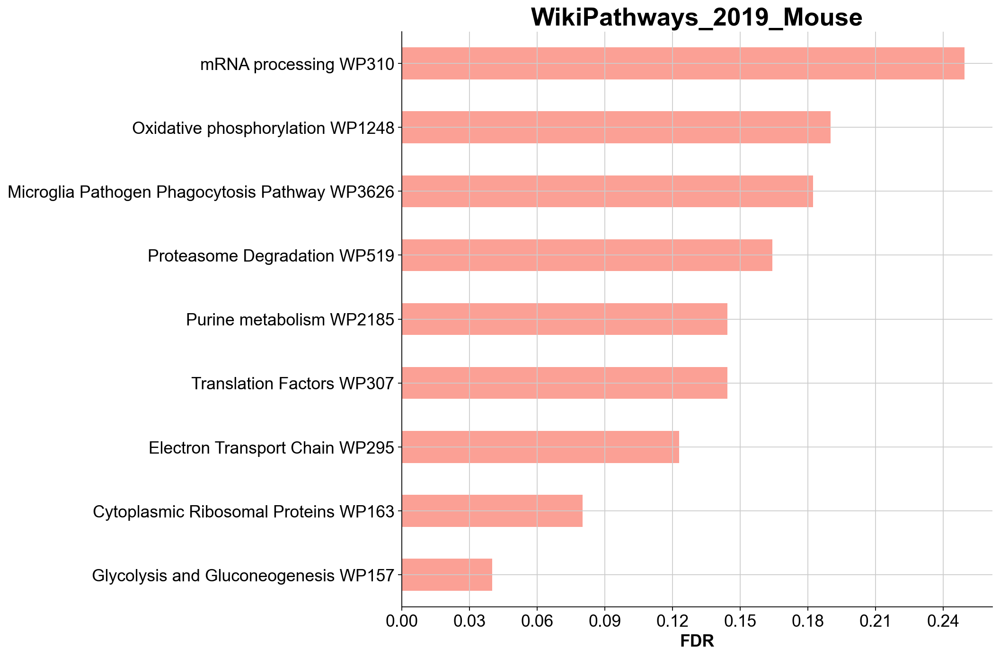

In [48]:
sc.settings.set_figure_params(dpi=80, facecolor='white')

top30 = significant_terms.sort_values('fdr', ascending=True).head(30)

top30.rename(columns={'fdr':'FDR'}, inplace=True)

gp.barplot(top30, column='FDR', top_term=30, title='WikiPathways_2019_Mouse', figsize=(10,10), ofname='/store/Projects/pantovski/IL10/GSEA_and_GO_figures/Ambient_RNA_Cleaned/Old IL10 vs IL10ra GSEA WIKI.png')

gp.barplot(top30, column='FDR', top_term=30, title='WikiPathways_2019_Mouse', figsize=(10,10))

In [4]:
sc.tl.rank_genes_groups(Old_HSC, 'IL10', groups = ['IL10ra_Old'], reference = 'DN_Old', method='wilcoxon', corr_method='bonferroni', key_added = 'wilcoxon_bonferroni_Old_IL10ra_vs_DN_Old')
result = Old_HSC.uns['wilcoxon_bonferroni_Old_IL10ra_vs_DN_Old']
groups = result['names'].dtype.names
pd.DataFrame(
    {group + '_' + key[:1]: result[key][group]
    for group in groups for key in ['names', 'pvals', 'pvals_adj']}).head(10)

Trying to set attribute `._uns` of view, copying.
/home/LULAB/pantovski/.conda/envs/general/lib/python3.8/site-packages/scanpy/tools/_rank_genes_groups.py:420: RuntimeWarning: invalid value encountered in log2
  self.stats[group_name, 'logfoldchanges'] = np.log2(


,IL10ra_Old_n,IL10ra_Old_p
0,Cd53,1.091738e-87
1,Ifitm1,1.256642e-70
2,Alcam,4.534313e-62
3,Samsn1,3.302025e-48
4,Prtn3,9.934102e-47
5,Pim1,3.688321e-41
6,Sult1a1,4.765740e-38
7,Gda,1.267642e-30
8,Selp,6.254193e-30
9,Glul,2.608744e-29


In [50]:
volcano_Old_HSC = sc.get.rank_genes_groups_df(Old_HSC, group=None, key='wilcoxon_bonferroni_Old_IL10ra_vs_DN_Old')
volcano_Old_HSC.to_csv("/store/Projects/pantovski/IL10/Combined/write/Ambient_RNA_Cleaned/Old_IL10ra_vs_DN_DGE_2_UMI_5_percent_Combat_raw_SingleR.csv")

In [51]:
volcano_Old_HSC_filtered = volcano_Old_HSC[volcano_Old_HSC['pvals_adj'] < 0.05]
volcano_Old_HSC_filtered['log_pvals_adj'] = -np.log10(volcano_Old_HSC_filtered['pvals_adj'])
volcano_Old_HSC_filtered.reset_index(inplace=True, drop=True)
volcano_Old_HSC_filtered.to_csv("/store/Projects/pantovski/IL10/Combined/write/Ambient_RNA_Cleaned/Old_IL10ra_vs_DN_005_DGE_2_UMI_5_percent_Combat_raw_SingleR.csv")
volcano_Old_HSC_filtered

/tmp/ipykernel_1223998/360082978.py:2: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  volcano_Old_HSC_filtered['log_pvals_adj'] = -np.log10(volcano_Old_HSC_filtered['pvals_adj'])


,names,scores,logfoldchanges,pvals,pvals_adj,log_pvals_adj
0,Cd53,20.258133,NaN,3.011691e-91,1.091738e-87,86.961882
1,Ifitm1,18.221785,1.245600,3.466598e-74,1.256642e-70,69.900788
2,Alcam,17.109961,2.034670,1.250845e-65,4.534313e-62,61.343489
3,Samsn1,15.137890,1.859349,9.109036e-52,3.302025e-48,47.481220
4,Prtn3,14.912324,2.562726,2.740442e-50,9.934102e-47,46.002871
...,...,...,...,...,...,...
420,Kit,-9.427930,-2.339299,4.182615e-21,1.516198e-17,16.819244
421,Cmtm7,-9.448994,3.732003,3.421037e-21,1.240126e-17,16.906534
422,Nrgn,-9.560301,-1.628480,1.174150e-21,4.256295e-18,17.370968
423,Aldh2,-10.522422,NaN,6.810056e-26,2.468645e-22,21.607541


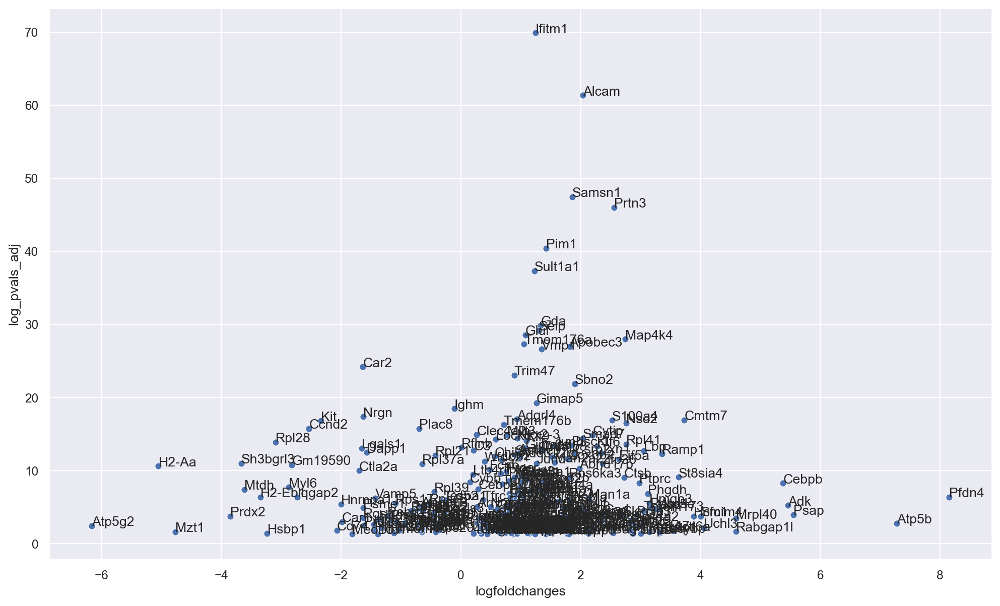

In [52]:
import matplotlib.pylab as plt
from matplotlib.pyplot import rc_context
import seaborn as sns
sc.settings.set_figure_params(dpi=80, facecolor='white')

sns.set(rc={"figure.figsize":(15, 9)})

sns.scatterplot(data=volcano_Old_HSC_filtered, x='logfoldchanges', y= 'log_pvals_adj')
for line in range(0,volcano_Old_HSC_filtered.shape[0]):
     plt.text(volcano_Old_HSC_filtered.logfoldchanges[line], volcano_Old_HSC_filtered.log_pvals_adj[line], volcano_Old_HSC_filtered.names[line])
plt.show()

In [53]:
import gseapy
gene_set_names = gseapy.get_library_name(organism='Mouse')

In [54]:
glist_Old = sc.get.rank_genes_groups_df(Old_HSC, group='IL10ra_Old', key='wilcoxon_bonferroni_Old_IL10ra_vs_DN_Old', pval_cutoff=0.05, log2fc_min=0.000000000001)['names'].squeeze().str.strip().tolist()

enr_res_Old_process = gseapy.enrichr(gene_list=glist_Old, organism='Mouse', gene_sets=['GO_Biological_Process_2021'], description='pathway', cutoff = 0.05)

significant_terms = enr_res_Old_process.res2d[enr_res_Old_process.res2d['Adjusted P-value'] < 0.05]
significant_terms.to_csv("/store/Projects/pantovski/IL10/Combined/write/Ambient_RNA_Cleaned/Old_IL10ra_vs_DN_significantly_upregulated_DGEs_GO_BP_005_terms_2_UMI_5_percent_Combat_raw_SingleR.csv")

/home/LULAB/pantovski/.conda/envs/general/lib/python3.8/site-packages/gseapy/enrichr.py:427: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  self.results = self.results.append(res, ignore_index=True)


In [5]:
sc.get.rank_genes_groups_df(Old_HSC, group='IL10ra_Old', key='wilcoxon_bonferroni_Old_IL10ra_vs_DN_Old', pval_cutoff=0.05, log2fc_min=0.000000000001).shape

(256, 5)

In [55]:
significant_terms.shape

(42, 10)

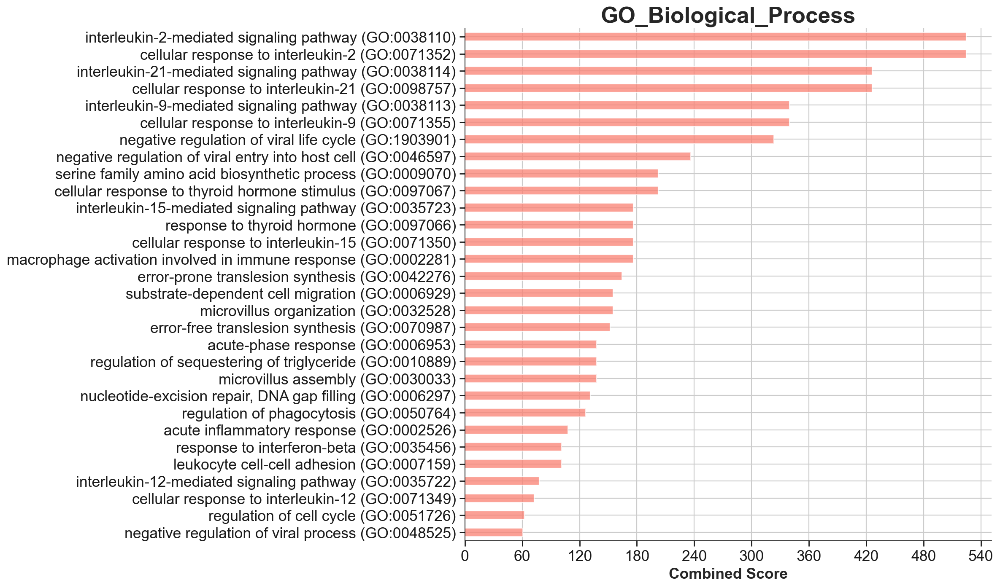

In [56]:
sc.settings.set_figure_params(dpi=80, facecolor='white')

gseapy.barplot(significant_terms, column='Combined Score', top_term=30, title='GO_Biological_Process', figsize=(10,10), ofname='/store/Projects/pantovski/IL10/GSEA_and_GO_figures/Ambient_RNA_Cleaned/Old IL10ra vs DN Upregulated DGEs GO BP.png')

gseapy.barplot(significant_terms, column='Combined Score', top_term=30, title='GO_Biological_Process', figsize=(10,10))

In [57]:
enr_res_Old_function = gseapy.enrichr(gene_list=glist_Old, organism='Mouse', gene_sets=['GO_Molecular_Function_2021'], description='pathway', cutoff = 0.05)

significant_terms = enr_res_Old_function.res2d[enr_res_Old_function.res2d['Adjusted P-value'] < 0.05]
significant_terms.to_csv("/store/Projects/pantovski/IL10/Combined/write/Ambient_RNA_Cleaned/Old_IL10ra_vs_DN_significantly_upregulated_DGEs_GO_MF_005_terms_2_UMI_5_percent_Combat_raw_SingleR.csv")

/home/LULAB/pantovski/.conda/envs/general/lib/python3.8/site-packages/gseapy/enrichr.py:427: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  self.results = self.results.append(res, ignore_index=True)


In [58]:
significant_terms.shape

(1, 10)

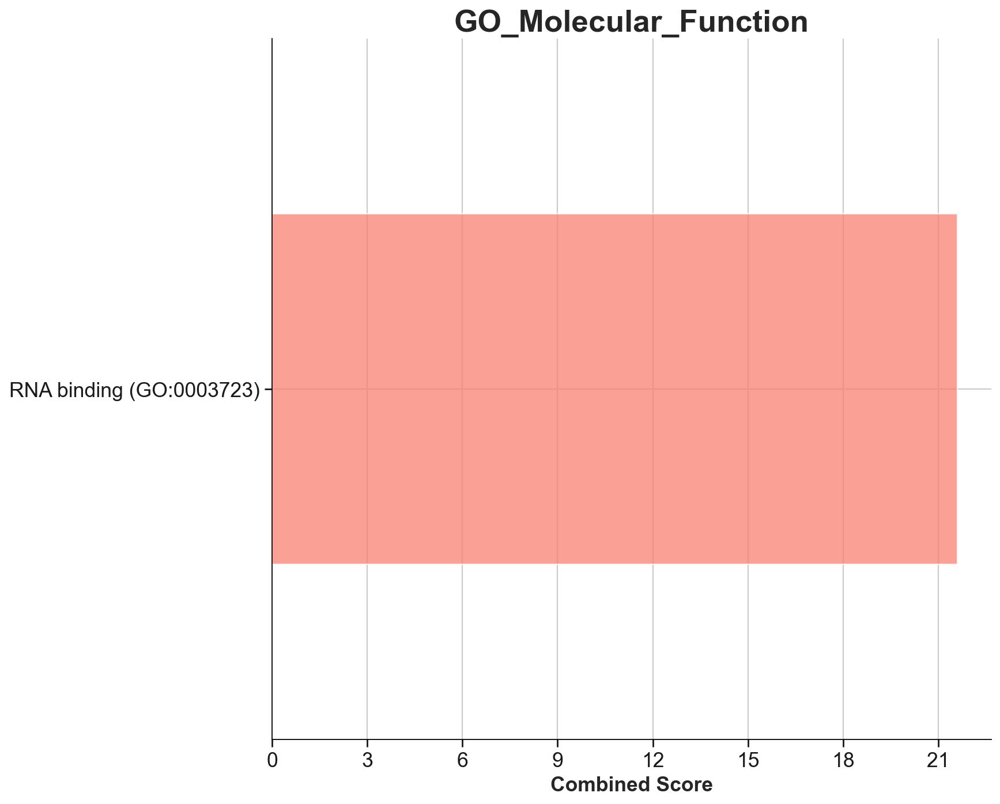

In [59]:
gseapy.barplot(significant_terms, column='Combined Score', top_term=30, title='GO_Molecular_Function', figsize=(10,10), ofname='/store/Projects/pantovski/IL10/GSEA_and_GO_figures/Ambient_RNA_Cleaned/Old IL10ra vs DN Upregulated DGEs GO MF.png')

gseapy.barplot(significant_terms, top_term=30, column='Combined Score', title='GO_Molecular_Function', figsize=(10,10))

In [60]:
enr_res_Old_cell_component = gseapy.enrichr(gene_list=glist_Old, organism='Mouse', gene_sets=['GO_Cellular_Component_2021'], description='pathway', cutoff = 0.05)

significant_terms = enr_res_Old_cell_component.res2d[enr_res_Old_cell_component.res2d['Adjusted P-value'] < 0.05]
significant_terms.to_csv("/store/Projects/pantovski/IL10/Combined/write/Ambient_RNA_Cleaned/Old_IL10ra_vs_DN_significantly_upregulated_DGEs_GO_CC_005_terms_2_UMI_5_percent_Combat_raw_SingleR.csv")

/home/LULAB/pantovski/.conda/envs/general/lib/python3.8/site-packages/gseapy/enrichr.py:427: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  self.results = self.results.append(res, ignore_index=True)


In [61]:
significant_terms.shape

(21, 10)

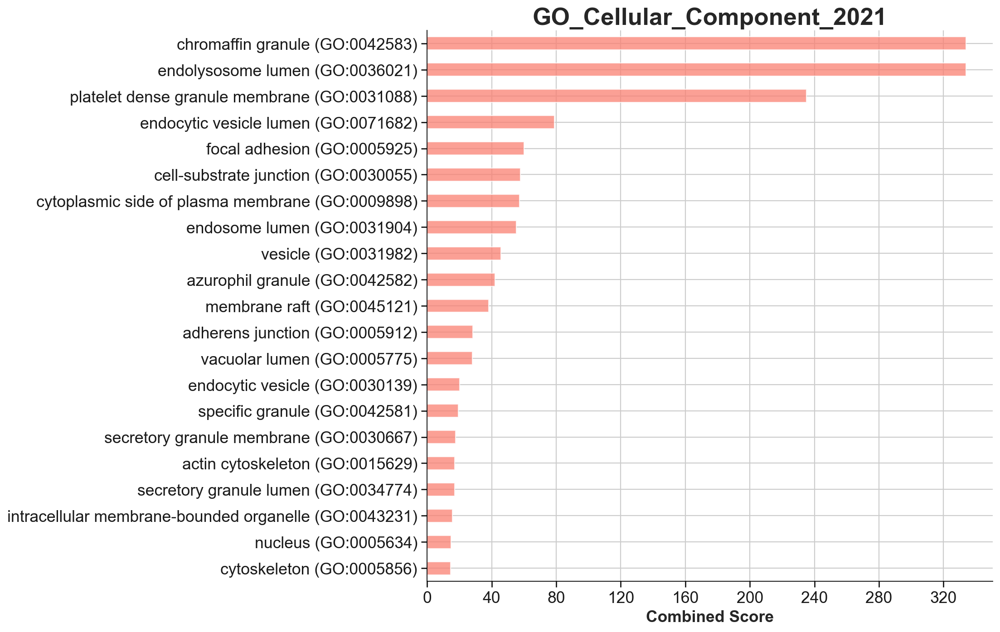

In [62]:
gseapy.barplot(significant_terms, column='Combined Score', top_term=30, title='GO_Cellular_Component_2021', figsize=(10,10), ofname='/store/Projects/pantovski/IL10/GSEA_and_GO_figures/Ambient_RNA_Cleaned/Old IL10ra vs DN Upregulated DGEs GO CC.png')

gseapy.barplot(significant_terms, top_term=30, column='Combined Score', title='GO_Cellular_Component_2021', figsize=(10,10))

In [63]:
enr_res_Old_KEGG = gseapy.enrichr(gene_list=glist_Old, organism='Mouse', gene_sets=['KEGG_2019_Mouse'], description='pathway', cutoff = 0.05)

significant_terms = enr_res_Old_KEGG.res2d[enr_res_Old_KEGG.res2d['Adjusted P-value'] < 0.05]
significant_terms.to_csv("/store/Projects/pantovski/IL10/Combined/write/Ambient_RNA_Cleaned/Old_IL10ra_vs_DN_significantly_upregulated_DGEs_KEGG_005_terms_2_UMI_5_percent_Combat_raw_SingleR.csv")

/home/LULAB/pantovski/.conda/envs/general/lib/python3.8/site-packages/gseapy/enrichr.py:427: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  self.results = self.results.append(res, ignore_index=True)


In [64]:
significant_terms.shape

(41, 10)

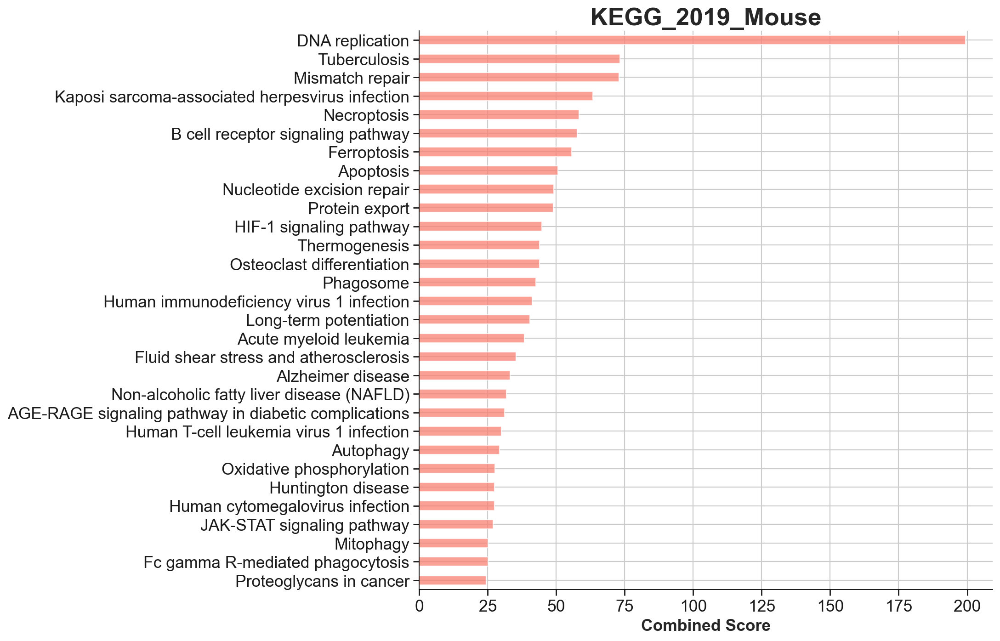

In [65]:
gseapy.barplot(significant_terms, column='Combined Score', top_term=30, title='KEGG_2019_Mouse', figsize=(10,10), ofname='/store/Projects/pantovski/IL10/GSEA_and_GO_figures/Ambient_RNA_Cleaned/Old IL10ra vs DN Upregulated DGEs KEGG.png')

gseapy.barplot(significant_terms, top_term=30, column='Combined Score', title='KEGG_2019_Mouse', figsize=(10,10))

In [66]:
enr_res_Old_WIKI = gseapy.enrichr(gene_list=glist_Old, organism='Mouse', gene_sets=['WikiPathways_2019_Mouse'], description='pathway', cutoff = 0.05)

significant_terms = enr_res_Old_WIKI.res2d[enr_res_Old_WIKI.res2d['Adjusted P-value'] < 0.05]
significant_terms.to_csv("/store/Projects/pantovski/IL10/Combined/write/Ambient_RNA_Cleaned/Old_IL10ra_vs_DN_significantly_upregulated_DGEs_WIKI_005_terms_2_UMI_5_percent_Combat_raw_SingleR.csv")

/home/LULAB/pantovski/.conda/envs/general/lib/python3.8/site-packages/gseapy/enrichr.py:427: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  self.results = self.results.append(res, ignore_index=True)


In [67]:
significant_terms.shape

(16, 10)

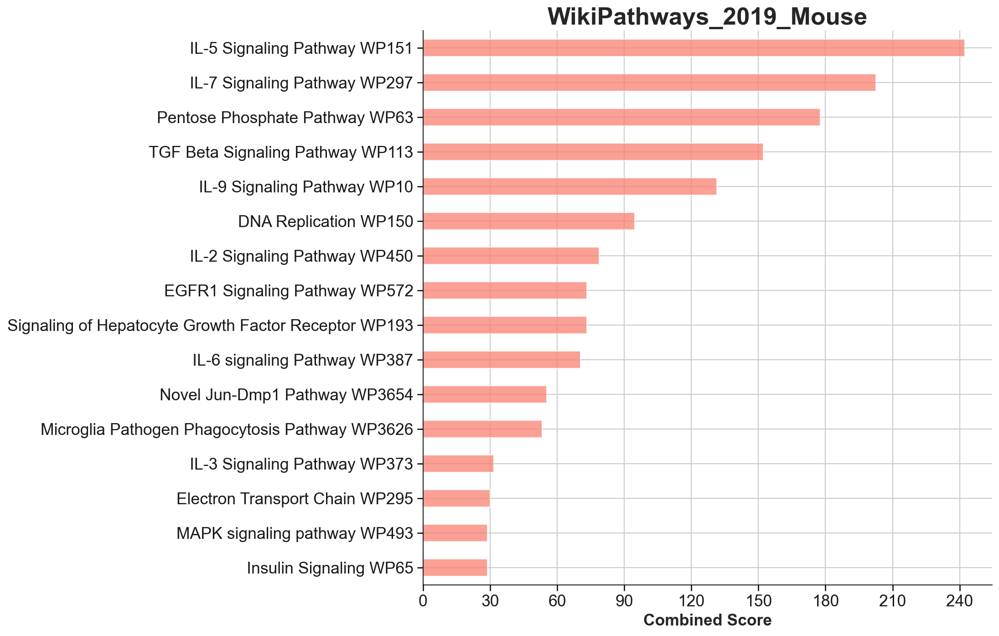

In [68]:
gseapy.barplot(significant_terms, column='Combined Score', top_term=30, title='WikiPathways_2019_Mouse', figsize=(10,10), ofname='/store/Projects/pantovski/IL10/GSEA_and_GO_figures/Ambient_RNA_Cleaned/Old IL10ra vs DN Upregulated DGEs WIKI.png')

gseapy.barplot(significant_terms, top_term=30, column='Combined Score', title='WikiPathways_2019_Mouse', figsize=(10,10))

In [69]:
glist_Old = sc.get.rank_genes_groups_df(Old_HSC, group='IL10ra_Old', key='wilcoxon_bonferroni_Old_IL10ra_vs_DN_Old', pval_cutoff=0.05, log2fc_max=-0.000000000001)['names'].squeeze().str.strip().tolist()

enr_res_Old_process = gseapy.enrichr(gene_list=glist_Old, organism='Mouse', gene_sets=['GO_Biological_Process_2021'], description='pathway', cutoff = 0.05)

significant_terms = enr_res_Old_process.res2d[enr_res_Old_process.res2d['Adjusted P-value'] < 0.05]
significant_terms.to_csv("/store/Projects/pantovski/IL10/Combined/write/Ambient_RNA_Cleaned/Old_IL10ra_vs_DN_significantly_downregulated_DGEs_GO_BP_005_terms_2_UMI_5_percent_Combat_raw_SingleR.csv")

/home/LULAB/pantovski/.conda/envs/general/lib/python3.8/site-packages/gseapy/enrichr.py:427: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  self.results = self.results.append(res, ignore_index=True)


In [6]:
sc.get.rank_genes_groups_df(Old_HSC, group='IL10ra_Old', key='wilcoxon_bonferroni_Old_IL10ra_vs_DN_Old', pval_cutoff=0.05, log2fc_max=-0.000000000001).shape

(71, 5)

In [70]:
significant_terms.shape

(29, 10)

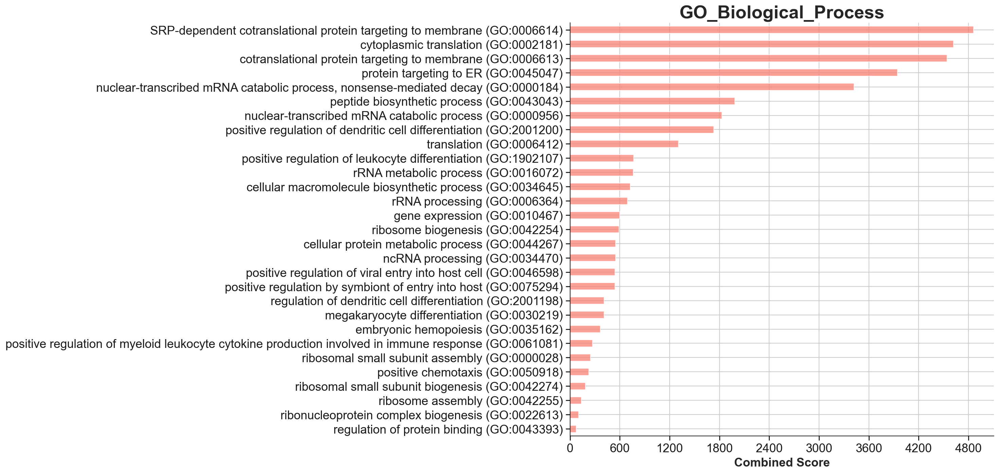

In [71]:
sc.settings.set_figure_params(dpi=80, facecolor='white')

gseapy.barplot(significant_terms, column='Combined Score', top_term=30, title='GO_Biological_Process', figsize=(10,10), ofname='/store/Projects/pantovski/IL10/GSEA_and_GO_figures/Ambient_RNA_Cleaned/Old IL10ra vs DN Downregulated DGEs GO BP.png')

gseapy.barplot(significant_terms, column='Combined Score', top_term=30, title='GO_Biological_Process', figsize=(10,10))

In [72]:
enr_res_Old_function = gseapy.enrichr(gene_list=glist_Old, organism='Mouse', gene_sets=['GO_Molecular_Function_2021'], description='pathway', cutoff = 0.05)

significant_terms = enr_res_Old_function.res2d[enr_res_Old_function.res2d['Adjusted P-value'] < 0.05]
significant_terms.to_csv("/store/Projects/pantovski/IL10/Combined/write/Ambient_RNA_Cleaned/Old_IL10ra_vs_DN_significantly_downregulated_DGEs_GO_MF_005_terms_2_UMI_5_percent_Combat_raw_SingleR.csv")

/home/LULAB/pantovski/.conda/envs/general/lib/python3.8/site-packages/gseapy/enrichr.py:427: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  self.results = self.results.append(res, ignore_index=True)


In [73]:
significant_terms.shape

(3, 10)

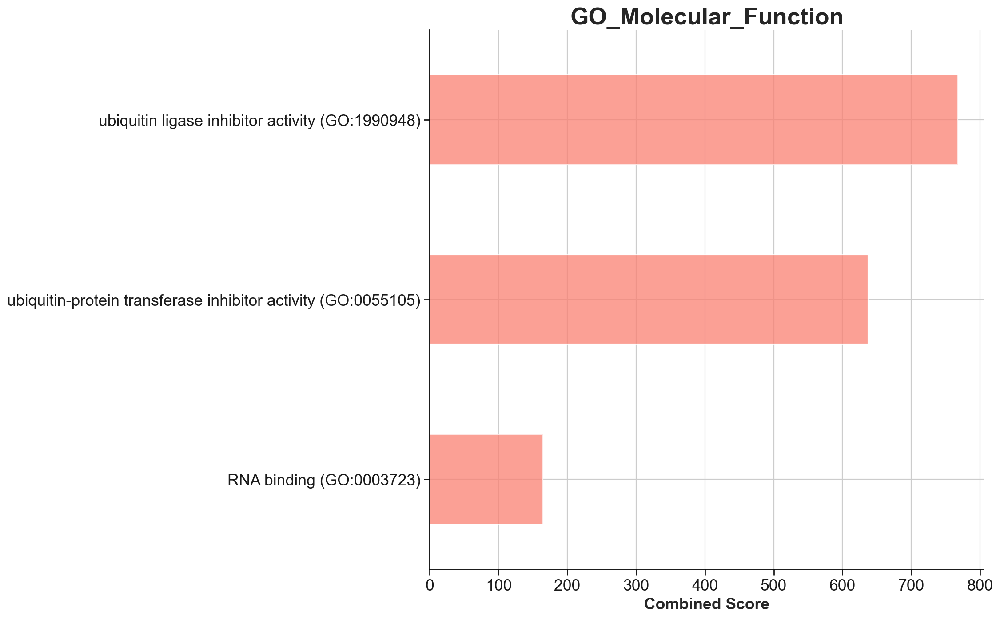

In [74]:
gseapy.barplot(significant_terms, column='Combined Score', top_term=30, title='GO_Molecular_Function', figsize=(10,10), ofname='/store/Projects/pantovski/IL10/GSEA_and_GO_figures/Ambient_RNA_Cleaned/Old IL10ra vs DN Downregulated DGEs GO MF.png')

gseapy.barplot(significant_terms, top_term=30, column='Combined Score', title='GO_Molecular_Function', figsize=(10,10))

In [75]:
enr_res_Old_cell_component = gseapy.enrichr(gene_list=glist_Old, organism='Mouse', gene_sets=['GO_Cellular_Component_2021'], description='pathway', cutoff = 0.05)

significant_terms = enr_res_Old_cell_component.res2d[enr_res_Old_cell_component.res2d['Adjusted P-value'] < 0.05]
significant_terms.to_csv("/store/Projects/pantovski/IL10/Combined/write/Ambient_RNA_Cleaned/Old_IL10ra_vs_DN_significantly_downregulated_DGEs_GO_CC_005_terms_2_UMI_5_percent_Combat_raw_SingleR.csv")

/home/LULAB/pantovski/.conda/envs/general/lib/python3.8/site-packages/gseapy/enrichr.py:427: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  self.results = self.results.append(res, ignore_index=True)


In [76]:
significant_terms.shape

(11, 10)

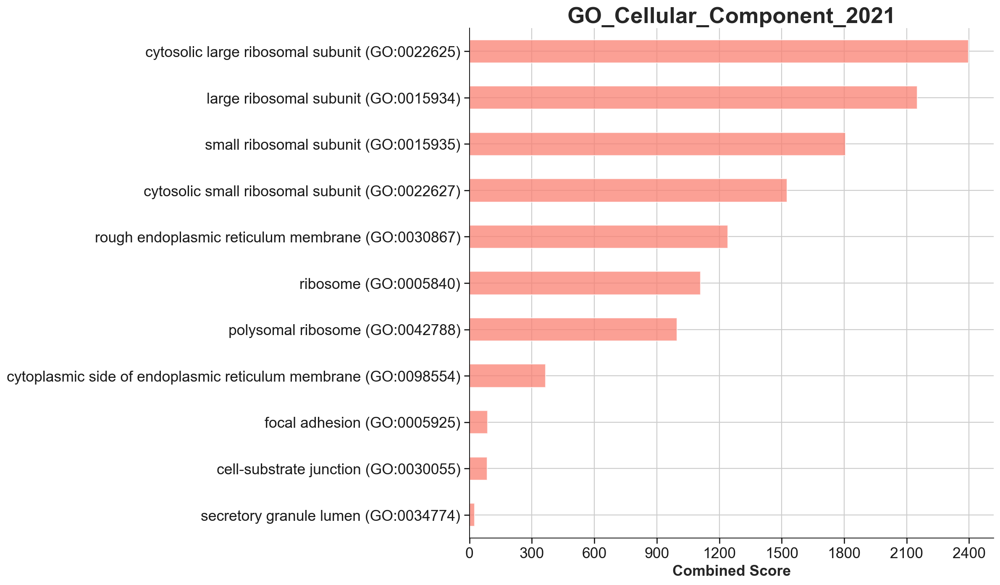

In [77]:
gseapy.barplot(significant_terms, column='Combined Score', top_term=30, title='GO_Cellular_Component_2021', figsize=(10,10), ofname='/store/Projects/pantovski/IL10/GSEA_and_GO_figures/Ambient_RNA_Cleaned/Old IL10ra vs DN Downregulated DGEs GO CC.png')

gseapy.barplot(significant_terms, top_term=30, column='Combined Score', title='GO_Cellular_Component_2021', figsize=(10,10))

In [78]:
enr_res_Old_KEGG = gseapy.enrichr(gene_list=glist_Old, organism='Mouse', gene_sets=['KEGG_2019_Mouse'], description='pathway', cutoff = 0.05)

significant_terms = enr_res_Old_KEGG.res2d[enr_res_Old_KEGG.res2d['Adjusted P-value'] < 0.05]
significant_terms.to_csv("/store/Projects/pantovski/IL10/Combined/write/Ambient_RNA_Cleaned/Old_IL10ra_vs_DN_significantly_downregulated_DGEs_KEGG_005_terms_2_UMI_5_percent_Combat_raw_SingleR.csv")

/home/LULAB/pantovski/.conda/envs/general/lib/python3.8/site-packages/gseapy/enrichr.py:427: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  self.results = self.results.append(res, ignore_index=True)


In [79]:
significant_terms.shape

(13, 10)

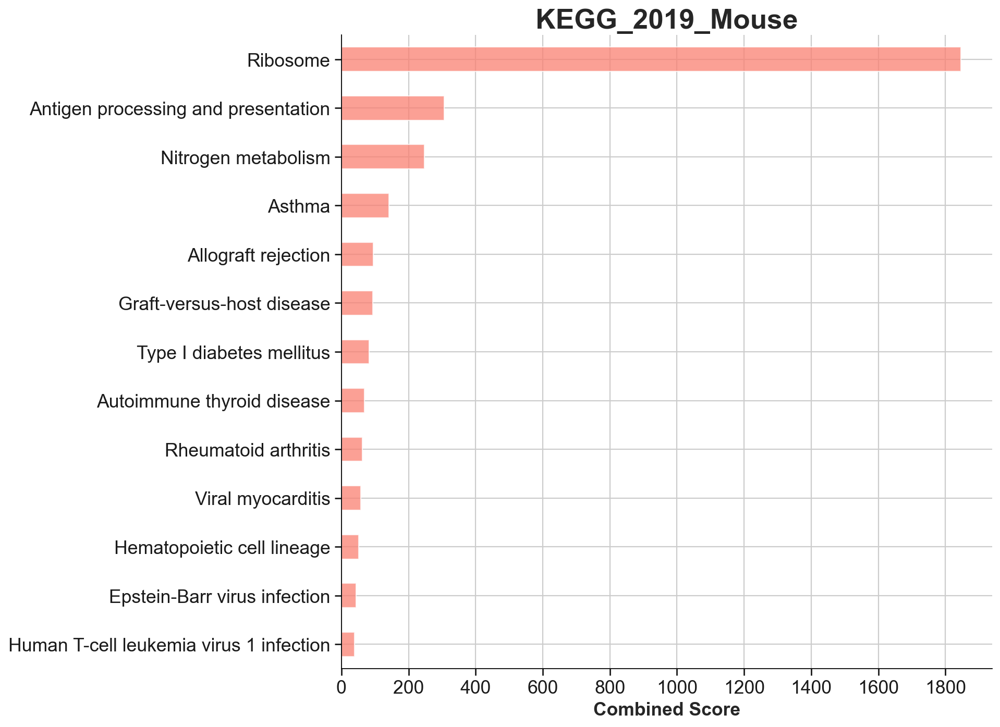

In [80]:
gseapy.barplot(significant_terms, column='Combined Score', top_term=30, title='KEGG_2019_Mouse', figsize=(10,10), ofname='/store/Projects/pantovski/IL10/GSEA_and_GO_figures/Ambient_RNA_Cleaned/Old IL10ra vs DN Downregulated DGEs KEGG.png')

gseapy.barplot(significant_terms, top_term=30, column='Combined Score', title='KEGG_2019_Mouse', figsize=(10,10))

In [81]:
enr_res_Old_WIKI = gseapy.enrichr(gene_list=glist_Old, organism='Mouse', gene_sets=['WikiPathways_2019_Mouse'], description='pathway', cutoff = 0.05)

significant_terms = enr_res_Old_WIKI.res2d[enr_res_Old_WIKI.res2d['Adjusted P-value'] < 0.05]
significant_terms.to_csv("/store/Projects/pantovski/IL10/Combined/write/Ambient_RNA_Cleaned/Old_IL10ra_vs_DN_significantly_downregulated_DGEs_WIKI_005_terms_2_UMI_5_percent_Combat_raw_SingleR.csv")

/home/LULAB/pantovski/.conda/envs/general/lib/python3.8/site-packages/gseapy/enrichr.py:427: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  self.results = self.results.append(res, ignore_index=True)


In [82]:
significant_terms.shape

(2, 10)

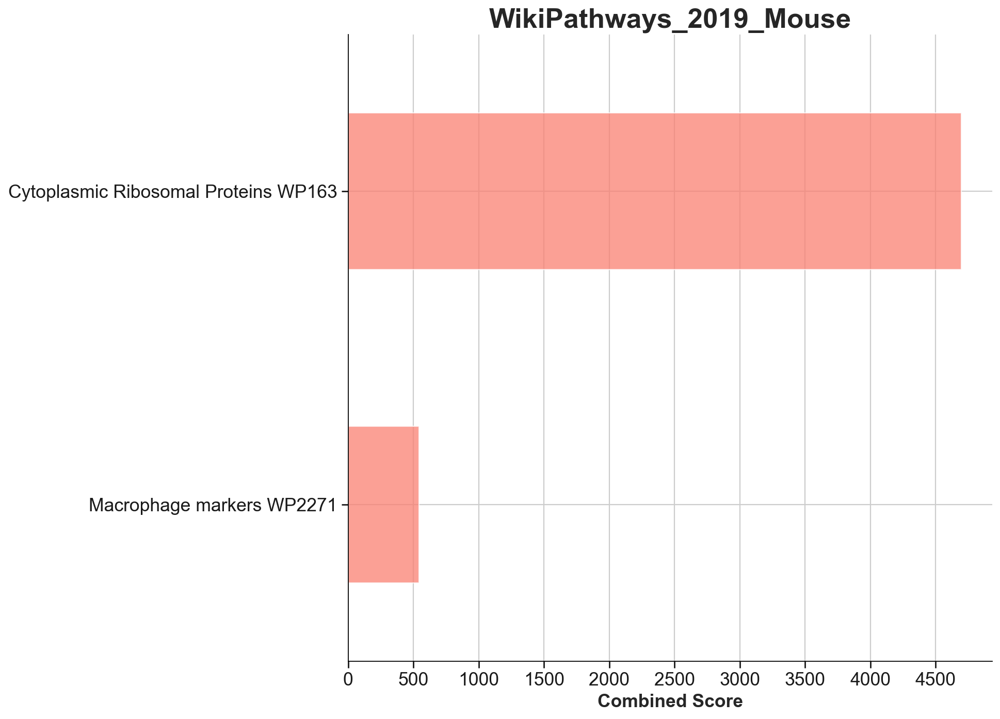

In [83]:
gseapy.barplot(significant_terms, column='Combined Score', top_term=30, title='WikiPathways_2019_Mouse', figsize=(10,10), ofname='/store/Projects/pantovski/IL10/GSEA_and_GO_figures/Ambient_RNA_Cleaned/Old IL10ra vs DN Downregulated DGEs WIKI.png')

gseapy.barplot(significant_terms, top_term=30, column='Combined Score', title='WikiPathways_2019_Mouse', figsize=(10,10))

In [84]:
sc.tl.rank_genes_groups(Old_HSC, 'IL10', groups = ['IL10_Old'], reference = 'DN_Old', method='wilcoxon', corr_method='bonferroni', key_added = 'wilcoxon_bonferroni_Old_IL10_vs_DN_Old')
result = Old_HSC.uns['wilcoxon_bonferroni_Old_IL10_vs_DN_Old']
groups = result['names'].dtype.names
pd.DataFrame(
    {group + '_' + key[:1]: result[key][group]
    for group in groups for key in ['names', 'pvals', 'pvals_adj']}).head(10)

,IL10_Old_n,IL10_Old_p
0,Hbb-bt,0.858296
1,Ptms,1.000000
2,Hba-a1,1.000000
3,Car1,1.000000
4,Hbb-bs,1.000000
5,Selp,1.000000
6,Ocrl,1.000000
7,Stk17b,1.000000
8,Atl3,1.000000
9,Coro2a,1.000000


In [85]:
volcano_Old_HSC = sc.get.rank_genes_groups_df(Old_HSC, group=None, key='wilcoxon_bonferroni_Old_IL10_vs_DN_Old')
volcano_Old_HSC.to_csv("/store/Projects/pantovski/IL10/Combined/write/Ambient_RNA_Cleaned/Old_IL10_vs_DN_DGE_2_UMI_5_percent_Combat_raw_SingleR.csv")

In [86]:
volcano_Old_HSC_filtered = volcano_Old_HSC[volcano_Old_HSC['pvals_adj'] < 0.05]
volcano_Old_HSC_filtered['log_pvals_adj'] = -np.log10(volcano_Old_HSC_filtered['pvals_adj'])
volcano_Old_HSC_filtered.reset_index(inplace=True, drop=True)
volcano_Old_HSC_filtered.to_csv("/store/Projects/pantovski/IL10/Combined/write/Ambient_RNA_Cleaned/Old_IL10_vs_DN_005_DGE_2_UMI_5_percent_Combat_raw_SingleR.csv")
volcano_Old_HSC_filtered

/tmp/ipykernel_1223998/1128928900.py:2: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  volcano_Old_HSC_filtered['log_pvals_adj'] = -np.log10(volcano_Old_HSC_filtered['pvals_adj'])


,names,scores,logfoldchanges,pvals,pvals_adj,log_pvals_adj
0,Cdkn3,-4.376949,1.537063,1.203520e-05,0.043628,1.360239
1,Ftl1,-4.389391,NaN,1.136686e-05,0.041205,1.385051
2,Cenpa,-4.406237,1.409901,1.051817e-05,0.038128,1.418752
3,Nusap1,-4.429343,1.506814,9.452048e-06,0.034264,1.465166
4,Hist1h1a,-4.453879,2.174875,8.433271e-06,0.030571,1.514696
5,1700020L24Rik,-4.462843,1.705763,8.087932e-06,0.029319,1.532854
6,Kif23,-4.485910,1.801249,7.260329e-06,0.026319,1.579736
7,Pnkp,-4.492788,2.308338,7.029677e-06,0.025483,1.593757
8,Trem3,-4.513382,1.612513,6.380185e-06,0.023128,1.635859
9,Tmem97,-4.582159,3.128265,4.601994e-06,0.016682,1.777746


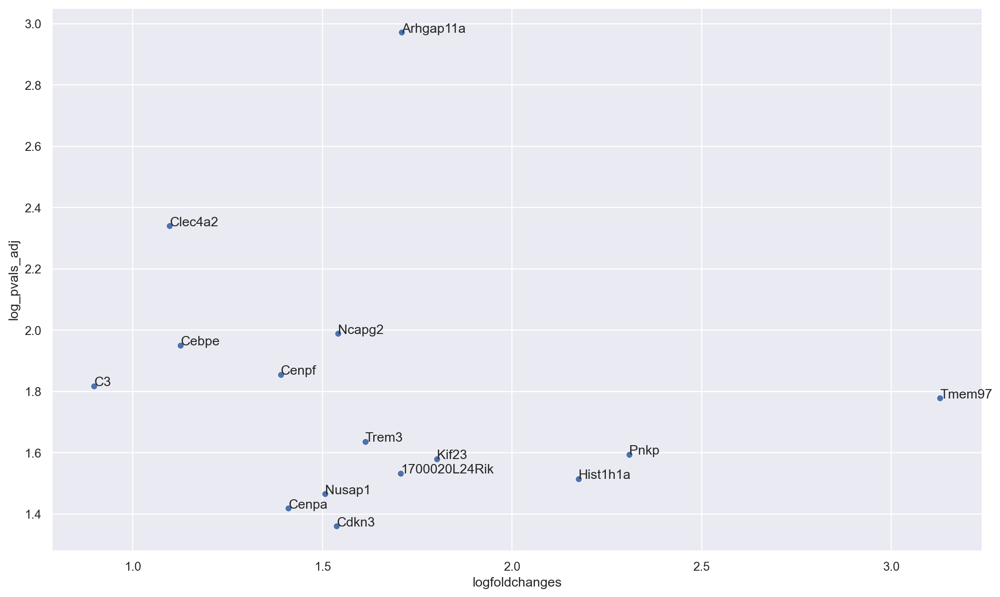

In [87]:
sc.settings.set_figure_params(dpi=80, facecolor='white')

sns.set(rc={"figure.figsize":(15, 9)})

sns.scatterplot(data=volcano_Old_HSC_filtered, x='logfoldchanges', y= 'log_pvals_adj')
for line in range(0,volcano_Old_HSC_filtered.shape[0]):
     plt.text(volcano_Old_HSC_filtered.logfoldchanges[line], volcano_Old_HSC_filtered.log_pvals_adj[line], volcano_Old_HSC_filtered.names[line])
plt.show()

In [88]:
import gseapy
gene_set_names = gseapy.get_library_name(organism='Mouse')

In [89]:
glist_Old = sc.get.rank_genes_groups_df(Old_HSC, group='IL10_Old', key='wilcoxon_bonferroni_Old_IL10_vs_DN_Old', pval_cutoff=0.05, log2fc_min=0.000000000001)['names'].squeeze().str.strip().tolist()

enr_res_Old_process = gseapy.enrichr(gene_list=glist_Old, organism='Mouse', gene_sets=['GO_Biological_Process_2021'], description='pathway', cutoff = 0.05)

significant_terms = enr_res_Old_process.res2d[enr_res_Old_process.res2d['Adjusted P-value'] < 0.05]
significant_terms.to_csv("/store/Projects/pantovski/IL10/Combined/write/Ambient_RNA_Cleaned/Old_IL10_vs_DN_significantly_upregulated_DGEs_GO_BP_005_terms_2_UMI_5_percent_Combat_raw_SingleR.csv")

/home/LULAB/pantovski/.conda/envs/general/lib/python3.8/site-packages/gseapy/enrichr.py:427: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  self.results = self.results.append(res, ignore_index=True)


In [90]:
significant_terms.shape

(31, 10)

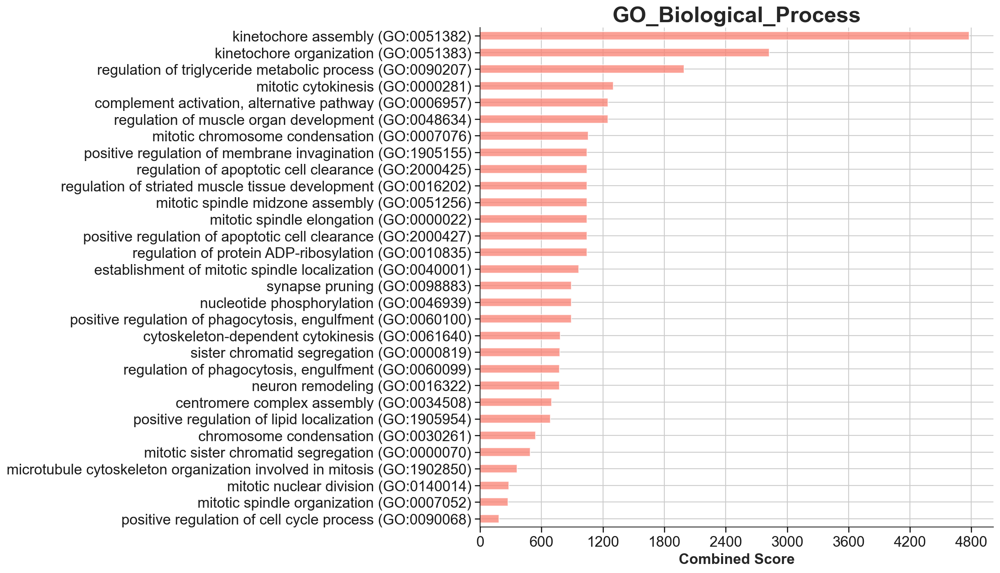

In [91]:
sc.settings.set_figure_params(dpi=80, facecolor='white')

gseapy.barplot(significant_terms, column='Combined Score', top_term=30, title='GO_Biological_Process', figsize=(10,10), ofname='/store/Projects/pantovski/IL10/GSEA_and_GO_figures/Ambient_RNA_Cleaned/Old IL10 vs DN Upregulated DGEs GO BP.png')

gseapy.barplot(significant_terms, column='Combined Score', top_term=30, title='GO_Biological_Process', figsize=(10,10))

In [92]:
enr_res_Old_function = gseapy.enrichr(gene_list=glist_Old, organism='Mouse', gene_sets=['GO_Molecular_Function_2021'], description='pathway', cutoff = 0.05)

significant_terms = enr_res_Old_function.res2d[enr_res_Old_function.res2d['Adjusted P-value'] < 0.05]
significant_terms.to_csv("/store/Projects/pantovski/IL10/Combined/write/Ambient_RNA_Cleaned/Old_IL10_vs_DN_significantly_upregulated_DGEs_GO_MF_005_terms_2_UMI_5_percent_Combat_raw_SingleR.csv")

/home/LULAB/pantovski/.conda/envs/general/lib/python3.8/site-packages/gseapy/enrichr.py:427: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  self.results = self.results.append(res, ignore_index=True)
2022-05-05 13:09:47,176 Warning: No enrich terms using library GO_Molecular_Function_2021 when cutoff = 0.05


In [93]:
significant_terms.shape

(0, 10)

In [94]:
gseapy.barplot(significant_terms, column='Combined Score', top_term=30, title='GO_Molecular_Function', figsize=(10,10), ofname='/store/Projects/pantovski/IL10/GSEA_and_GO_figures/Ambient_RNA_Cleaned/Old IL10 vs DN Upregulated DGEs GO MF.png')

gseapy.barplot(significant_terms, top_term=30, column='Combined Score', title='GO_Molecular_Function', figsize=(10,10))

IndexError: index 0 is out of bounds for axis 0 with size 0

In [95]:
enr_res_Old_cell_component = gseapy.enrichr(gene_list=glist_Old, organism='Mouse', gene_sets=['GO_Cellular_Component_2021'], description='pathway', cutoff = 0.05)

significant_terms = enr_res_Old_cell_component.res2d[enr_res_Old_cell_component.res2d['Adjusted P-value'] < 0.05]
significant_terms.to_csv("/store/Projects/pantovski/IL10/Combined/write/Ambient_RNA_Cleaned/Old_IL10_vs_DN_significantly_upregulated_DGEs_GO_CC_005_terms_2_UMI_5_percent_Combat_raw_SingleR.csv")

/home/LULAB/pantovski/.conda/envs/general/lib/python3.8/site-packages/gseapy/enrichr.py:427: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  self.results = self.results.append(res, ignore_index=True)


In [96]:
significant_terms.shape

(2, 10)

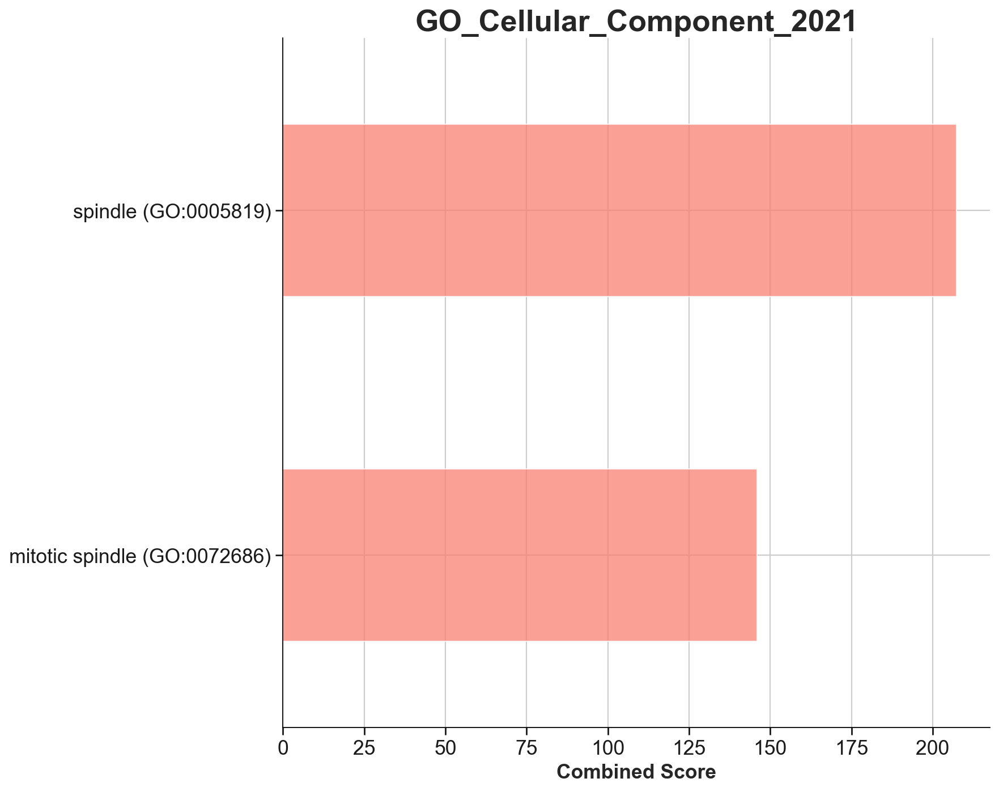

In [97]:
gseapy.barplot(significant_terms, column='Combined Score', top_term=30, title='GO_Cellular_Component_2021', figsize=(10,10), ofname='/store/Projects/pantovski/IL10/GSEA_and_GO_figures/Ambient_RNA_Cleaned/Old IL10 vs DN Upregulated DGEs GO CC.png')

gseapy.barplot(significant_terms, top_term=30, column='Combined Score', title='GO_Cellular_Component_2021', figsize=(10,10))

In [98]:
enr_res_Old_KEGG = gseapy.enrichr(gene_list=glist_Old, organism='Mouse', gene_sets=['KEGG_2019_Mouse'], description='pathway', cutoff = 0.05)

significant_terms = enr_res_Old_KEGG.res2d[enr_res_Old_KEGG.res2d['Adjusted P-value'] < 0.05]
significant_terms.to_csv("/store/Projects/pantovski/IL10/Combined/write/Ambient_RNA_Cleaned/Old_IL10_vs_DN_significantly_upregulated_DGEs_KEGG_005_terms_2_UMI_5_percent_Combat_raw_SingleR.csv")

/home/LULAB/pantovski/.conda/envs/general/lib/python3.8/site-packages/gseapy/enrichr.py:427: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  self.results = self.results.append(res, ignore_index=True)
2022-05-05 13:11:10,154 Warning: No enrich terms using library KEGG_2019_Mouse when cutoff = 0.05


In [99]:
significant_terms.shape

(0, 10)

In [100]:
gseapy.barplot(significant_terms, column='Combined Score', top_term=30, title='KEGG_2019_Mouse', figsize=(10,10), ofname='/store/Projects/pantovski/IL10/GSEA_and_GO_figures/Ambient_RNA_Cleaned/Old IL10 vs DN Upregulated DGEs KEGG.png')

gseapy.barplot(significant_terms, top_term=30, column='Combined Score', title='KEGG_2019_Mouse', figsize=(10,10))

IndexError: index 0 is out of bounds for axis 0 with size 0

In [101]:
enr_res_Old_WIKI = gseapy.enrichr(gene_list=glist_Old, organism='Mouse', gene_sets=['WikiPathways_2019_Mouse'], description='pathway', cutoff = 0.05)

significant_terms = enr_res_Old_WIKI.res2d[enr_res_Old_WIKI.res2d['Adjusted P-value'] < 0.05]
significant_terms.to_csv("/store/Projects/pantovski/IL10/Combined/write/Ambient_RNA_Cleaned/Old_IL10_vs_DN_significantly_upregulated_DGEs_WIKI_005_terms_2_UMI_5_percent_Combat_raw_SingleR.csv")

/home/LULAB/pantovski/.conda/envs/general/lib/python3.8/site-packages/gseapy/enrichr.py:427: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  self.results = self.results.append(res, ignore_index=True)


In [102]:
significant_terms.shape

(4, 10)

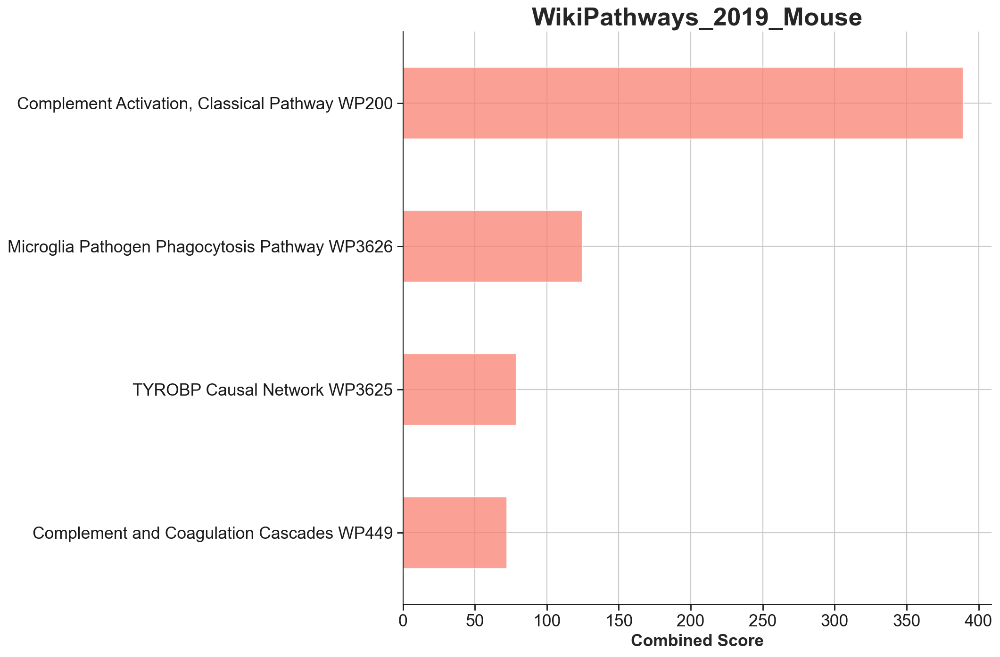

In [103]:
gseapy.barplot(significant_terms, column='Combined Score', top_term=30, title='WikiPathways_2019_Mouse', figsize=(10,10), ofname='/store/Projects/pantovski/IL10/GSEA_and_GO_figures/Ambient_RNA_Cleaned/Old IL10 vs DN Upregulated DGEs WIKI.png')

gseapy.barplot(significant_terms, top_term=30, column='Combined Score', title='WikiPathways_2019_Mouse', figsize=(10,10))

In [104]:
glist_Old = sc.get.rank_genes_groups_df(Old_HSC, group='IL10_Old', key='wilcoxon_bonferroni_Old_IL10_vs_DN_Old', pval_cutoff=0.05, log2fc_max=-0.000000000001)['names'].squeeze().str.strip().tolist()

enr_res_Old_process = gseapy.enrichr(gene_list=glist_Old, organism='Mouse', gene_sets=['GO_Biological_Process_2021'], description='pathway', cutoff = 0.05)

significant_terms = enr_res_Old_process.res2d[enr_res_Old_process.res2d['Adjusted P-value'] < 0.05]
significant_terms.to_csv("/store/Projects/pantovski/IL10/Combined/write/Ambient_RNA_Cleaned/Old_IL10_vs_DN_significantly_downregulated_DGEs_GO_BP_005_terms_2_UMI_5_percent_Combat_raw_SingleR.csv")

Exception: Error analyzing gene list

In [ ]:
significant_terms.shape

In [ ]:
sc.settings.set_figure_params(dpi=80, facecolor='white')

gseapy.barplot(significant_terms, column='Combined Score', top_term=30, title='GO_Biological_Process', figsize=(10,10), ofname='/store/Projects/pantovski/IL10/GSEA_and_GO_figures/Ambient_RNA_Cleaned/Old IL10 vs DN Downregulated DGEs GO BP.png')

gseapy.barplot(significant_terms, column='Combined Score', top_term=30, title='GO_Biological_Process', figsize=(10,10))

In [ ]:
enr_res_Old_function = gseapy.enrichr(gene_list=glist_Old, organism='Mouse', gene_sets=['GO_Molecular_Function_2021'], description='pathway', cutoff = 0.05)

significant_terms = enr_res_Old_function.res2d[enr_res_Old_function.res2d['Adjusted P-value'] < 0.05]
significant_terms.to_csv("/store/Projects/pantovski/IL10/Combined/write/Ambient_RNA_Cleaned/Old_IL10_vs_DN_significantly_downregulated_DGEs_GO_MF_005_terms_2_UMI_5_percent_Combat_raw_SingleR.csv")

In [ ]:
significant_terms.shape

In [ ]:
gseapy.barplot(significant_terms, column='Combined Score', top_term=30, title='GO_Molecular_Function', figsize=(10,10), ofname='/store/Projects/pantovski/IL10/GSEA_and_GO_figures/Ambient_RNA_Cleaned/Old IL10 vs DN Downregulated DGEs GO MF.png')

gseapy.barplot(significant_terms, top_term=30, column='Combined Score', title='GO_Molecular_Function', figsize=(10,10))

In [ ]:
enr_res_Old_cell_component = gseapy.enrichr(gene_list=glist_Old, organism='Mouse', gene_sets=['GO_Cellular_Component_2021'], description='pathway', cutoff = 0.05)

significant_terms = enr_res_Old_cell_component.res2d[enr_res_Old_cell_component.res2d['Adjusted P-value'] < 0.05]
significant_terms.to_csv("/store/Projects/pantovski/IL10/Combined/write/Ambient_RNA_Cleaned/Old_IL10_vs_DN_significantly_downregulated_DGEs_GO_CC_005_terms_2_UMI_5_percent_Combat_raw_SingleR.csv")

In [ ]:
significant_terms.shape

In [ ]:
gseapy.barplot(significant_terms, column='Combined Score', top_term=30, title='GO_Cellular_Component_2021', figsize=(10,10), ofname='/store/Projects/pantovski/IL10/GSEA_and_GO_figures/Ambient_RNA_Cleaned/Old IL10 vs DN Downregulated DGEs GO CC.png')

gseapy.barplot(significant_terms, top_term=30, column='Combined Score', title='GO_Cellular_Component_2021', figsize=(10,10))

In [ ]:
enr_res_Old_KEGG = gseapy.enrichr(gene_list=glist_Old, organism='Mouse', gene_sets=['KEGG_2019_Mouse'], description='pathway', cutoff = 0.05)

significant_terms = enr_res_Old_KEGG.res2d[enr_res_Old_KEGG.res2d['Adjusted P-value'] < 0.05]
significant_terms.to_csv("/store/Projects/pantovski/IL10/Combined/write/Ambient_RNA_Cleaned/Old_IL10_vs_DN_significantly_downregulated_DGEs_KEGG_005_terms_2_UMI_5_percent_Combat_raw_SingleR.csv")

In [ ]:
significant_terms.shape

In [ ]:
gseapy.barplot(significant_terms, column='Combined Score', top_term=30, title='KEGG_2019_Mouse', figsize=(10,10), ofname='/store/Projects/pantovski/IL10/GSEA_and_GO_figures/Ambient_RNA_Cleaned/Old IL10 vs DN Downregulated DGEs KEGG.png')

gseapy.barplot(significant_terms, top_term=30, column='Combined Score', title='KEGG_2019_Mouse', figsize=(10,10))

In [ ]:
enr_res_Old_WIKI = gseapy.enrichr(gene_list=glist_Old, organism='Mouse', gene_sets=['WikiPathways_2019_Mouse'], description='pathway', cutoff = 0.05)

significant_terms = enr_res_Old_WIKI.res2d[enr_res_Old_WIKI.res2d['Adjusted P-value'] < 0.05]
significant_terms.to_csv("/store/Projects/pantovski/IL10/Combined/write/Ambient_RNA_Cleaned/Old_IL10_vs_DN_significantly_downregulated_DGEs_WIKI_005_terms_2_UMI_5_percent_Combat_raw_SingleR.csv")

In [ ]:
significant_terms.shape

In [ ]:
gseapy.barplot(significant_terms, column='Combined Score', top_term=30, title='WikiPathways_2019_Mouse', figsize=(10,10), ofname='/store/Projects/pantovski/IL10/GSEA_and_GO_figures/Ambient_RNA_Cleaned/Old IL10 vs DN Downregulated DGEs WIKI.png')

gseapy.barplot(significant_terms, top_term=30, column='Combined Score', title='WikiPathways_2019_Mouse', figsize=(10,10))

In [105]:
sc.tl.rank_genes_groups(Old_HSC, 'IL10', groups = ['IL10_Old'], reference = 'IL10ra_Old', method='wilcoxon', corr_method='bonferroni', key_added = 'wilcoxon_bonferroni_Old_IL10_vs_IL10ra_Old')
result = Old_HSC.uns['wilcoxon_bonferroni_Old_IL10_vs_IL10ra_Old']
groups = result['names'].dtype.names
pd.DataFrame(
    {group + '_' + key[:1]: result[key][group]
    for group in groups for key in ['names', 'pvals', 'pvals_adj']}).head(10)

,IL10_Old_n,IL10_Old_p
0,Car2,1.0
1,Ptms,1.0
2,Pf4,1.0
3,Hbb-bt,1.0
4,Rxylt1,1.0
5,Ocrl,1.0
6,Atl3,1.0
7,Itga2b,1.0
8,Clic4,1.0
9,Btg2,1.0


In [106]:
volcano_Old_HSC = sc.get.rank_genes_groups_df(Old_HSC, group=None, key='wilcoxon_bonferroni_Old_IL10_vs_IL10ra_Old')
volcano_Old_HSC.to_csv("/store/Projects/pantovski/IL10/Combined/write/Ambient_RNA_Cleaned/Old_IL10_vs_IL10ra_DGE_2_UMI_5_percent_Combat_raw_SingleR.csv")

In [107]:
volcano_Old_HSC_filtered = volcano_Old_HSC[volcano_Old_HSC['pvals_adj'] < 0.05]
volcano_Old_HSC_filtered['log_pvals_adj'] = -np.log10(volcano_Old_HSC_filtered['pvals_adj'])
volcano_Old_HSC_filtered.reset_index(inplace=True, drop=True)
volcano_Old_HSC_filtered.to_csv("/store/Projects/pantovski/IL10/Combined/write/Ambient_RNA_Cleaned/Old_IL10_vs_IL10ra_005_DGE_2_UMI_5_percent_Combat_raw_SingleR.csv")
volcano_Old_HSC_filtered

/tmp/ipykernel_1223998/485323594.py:2: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  volcano_Old_HSC_filtered['log_pvals_adj'] = -np.log10(volcano_Old_HSC_filtered['pvals_adj'])


,names,scores,logfoldchanges,pvals,pvals_adj,log_pvals_adj
0,Sell,-4.443947,1.202170,8.832338e-06,0.032017,1.494616
1,H2-D1,-4.490927,NaN,7.091394e-06,0.025706,1.589960
2,Arhgap11a,-4.702094,1.474076,2.575075e-06,0.009335,2.029902
3,Prtn3,-5.614082,NaN,1.976082e-08,0.000072,4.144887


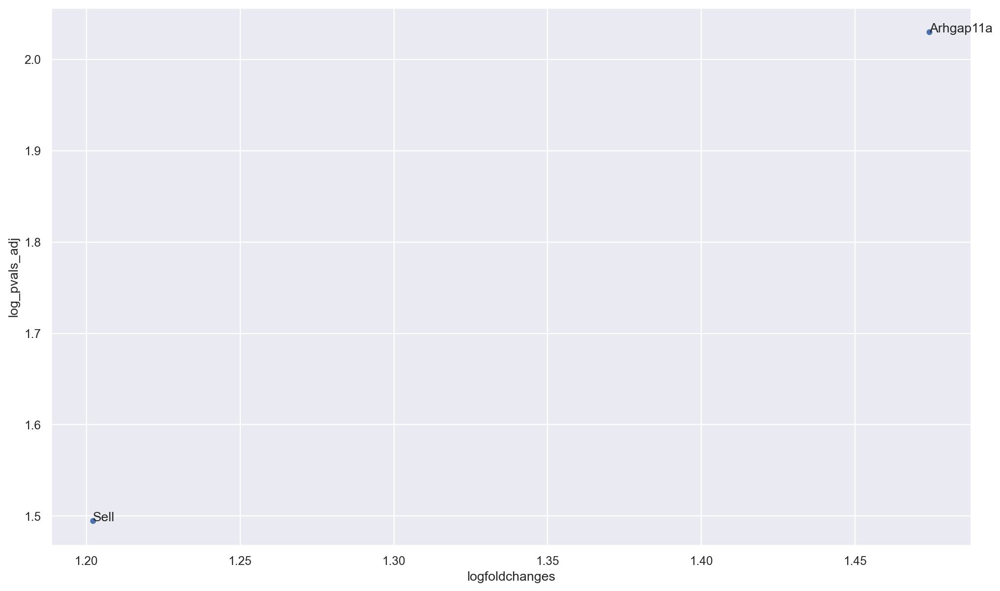

In [108]:
sc.settings.set_figure_params(dpi=80, facecolor='white')

sns.set(rc={"figure.figsize":(15, 9)})

sns.scatterplot(data=volcano_Old_HSC_filtered, x='logfoldchanges', y= 'log_pvals_adj')
for line in range(0,volcano_Old_HSC_filtered.shape[0]):
     plt.text(volcano_Old_HSC_filtered.logfoldchanges[line], volcano_Old_HSC_filtered.log_pvals_adj[line], volcano_Old_HSC_filtered.names[line])
plt.show()

In [109]:
import gseapy
gene_set_names = gseapy.get_library_name(organism='Mouse')

In [110]:
glist_Old = sc.get.rank_genes_groups_df(Old_HSC, group='IL10_Old', key='wilcoxon_bonferroni_Old_IL10_vs_IL10ra_Old', pval_cutoff=0.05, log2fc_min=0.000000000001)['names'].squeeze().str.strip().tolist()

enr_res_Old_process = gseapy.enrichr(gene_list=glist_Old, organism='Mouse', gene_sets=['GO_Biological_Process_2021'], description='pathway', cutoff = 0.05)

significant_terms = enr_res_Old_process.res2d[enr_res_Old_process.res2d['Adjusted P-value'] < 0.05]
significant_terms.to_csv("/store/Projects/pantovski/IL10/Combined/write/Ambient_RNA_Cleaned/Old_IL10_vs_IL10ra_significantly_upregulated_DGEs_GO_BP_005_terms_2_UMI_5_percent_Combat_raw_SingleR.csv")

/home/LULAB/pantovski/.conda/envs/general/lib/python3.8/site-packages/gseapy/enrichr.py:427: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  self.results = self.results.append(res, ignore_index=True)


In [111]:
significant_terms.shape

(13, 10)

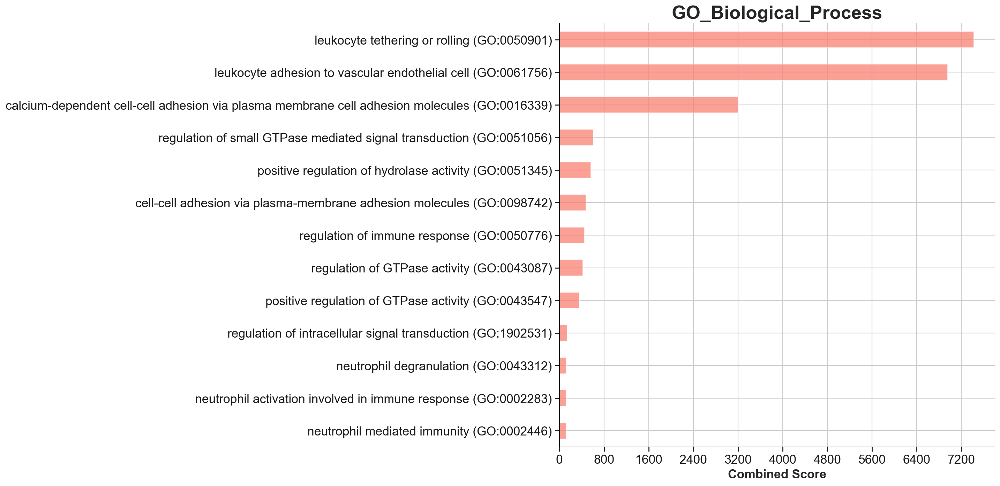

In [112]:
sc.settings.set_figure_params(dpi=80, facecolor='white')

gseapy.barplot(significant_terms, column='Combined Score', top_term=30, title='GO_Biological_Process', figsize=(10,10), ofname='/store/Projects/pantovski/IL10/GSEA_and_GO_figures/Ambient_RNA_Cleaned/Old IL10 vs IL10ra Upregulated DGEs GO BP.png')

gseapy.barplot(significant_terms, column='Combined Score', top_term=30, title='GO_Biological_Process', figsize=(10,10))

In [113]:
enr_res_Old_function = gseapy.enrichr(gene_list=glist_Old, organism='Mouse', gene_sets=['GO_Molecular_Function_2021'], description='pathway', cutoff = 0.05)

significant_terms = enr_res_Old_function.res2d[enr_res_Old_function.res2d['Adjusted P-value'] < 0.05]
significant_terms.to_csv("/store/Projects/pantovski/IL10/Combined/write/Ambient_RNA_Cleaned/Old_IL10_vs_IL10ra_significantly_upregulated_DGEs_GO_MF_005_terms_2_UMI_5_percent_Combat_raw_SingleR.csv")

/home/LULAB/pantovski/.conda/envs/general/lib/python3.8/site-packages/gseapy/enrichr.py:427: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  self.results = self.results.append(res, ignore_index=True)


In [114]:
significant_terms.shape

(4, 10)

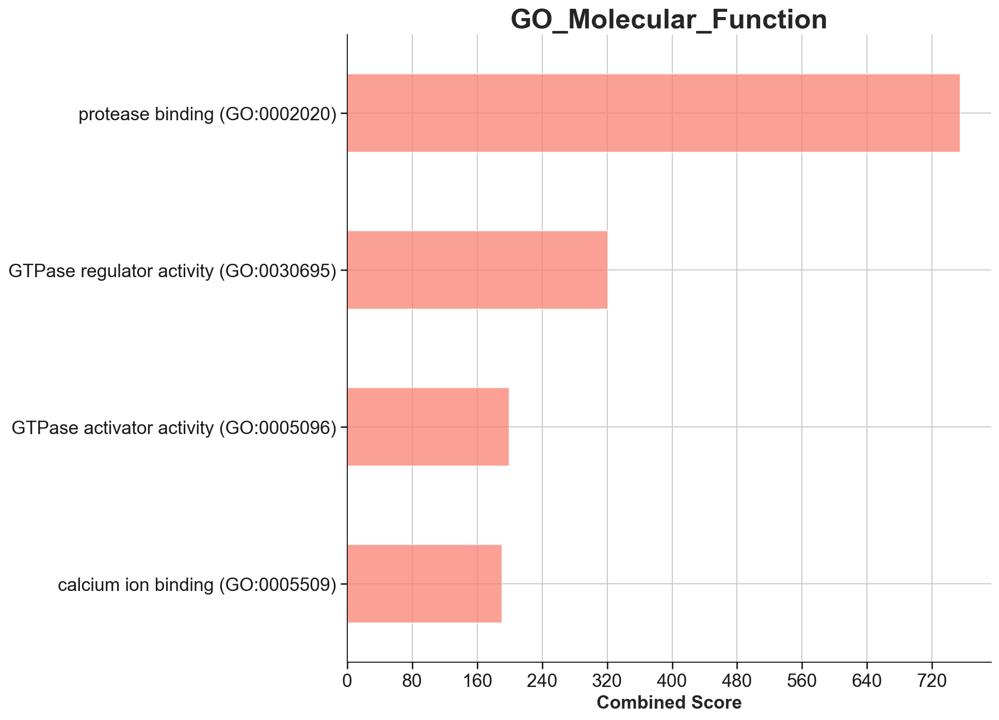

In [115]:
gseapy.barplot(significant_terms, column='Combined Score', top_term=30, title='GO_Molecular_Function', figsize=(10,10), ofname='/store/Projects/pantovski/IL10/GSEA_and_GO_figures/Ambient_RNA_Cleaned/Old IL10 vs IL10ra Upregulated DGEs GO MF.png')

gseapy.barplot(significant_terms, top_term=30, column='Combined Score', title='GO_Molecular_Function', figsize=(10,10))

In [116]:
enr_res_Old_cell_component = gseapy.enrichr(gene_list=glist_Old, organism='Mouse', gene_sets=['GO_Cellular_Component_2021'], description='pathway', cutoff = 0.05)

significant_terms = enr_res_Old_cell_component.res2d[enr_res_Old_cell_component.res2d['Adjusted P-value'] < 0.05]
significant_terms.to_csv("/store/Projects/pantovski/IL10/Combined/write/Ambient_RNA_Cleaned/Old_IL10_vs_IL10ra_significantly_upregulated_DGEs_GO_CC_005_terms_2_UMI_5_percent_Combat_raw_SingleR.csv")

/home/LULAB/pantovski/.conda/envs/general/lib/python3.8/site-packages/gseapy/enrichr.py:427: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  self.results = self.results.append(res, ignore_index=True)
2022-05-05 13:11:38,308 Warning: No enrich terms using library GO_Cellular_Component_2021 when cutoff = 0.05


In [117]:
significant_terms.shape

(0, 10)

In [118]:
gseapy.barplot(significant_terms, column='Combined Score', top_term=30, title='GO_Cellular_Component_2021', figsize=(10,10), ofname='/store/Projects/pantovski/IL10/GSEA_and_GO_figures/Ambient_RNA_Cleaned/Old IL10 vs IL10ra Upregulated DGEs GO CC.png')

gseapy.barplot(significant_terms, top_term=30, column='Combined Score', title='GO_Cellular_Component_2021', figsize=(10,10))

IndexError: index 0 is out of bounds for axis 0 with size 0

In [119]:
enr_res_Old_KEGG = gseapy.enrichr(gene_list=glist_Old, organism='Mouse', gene_sets=['KEGG_2019_Mouse'], description='pathway', cutoff = 0.05)

significant_terms = enr_res_Old_KEGG.res2d[enr_res_Old_KEGG.res2d['Adjusted P-value'] < 0.05]
significant_terms.to_csv("/store/Projects/pantovski/IL10/Combined/write/Ambient_RNA_Cleaned/Old_IL10_vs_IL10ra_significantly_upregulated_DGEs_KEGG_005_terms_2_UMI_5_percent_Combat_raw_SingleR.csv")

/home/LULAB/pantovski/.conda/envs/general/lib/python3.8/site-packages/gseapy/enrichr.py:427: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  self.results = self.results.append(res, ignore_index=True)


In [120]:
significant_terms.shape

(1, 10)

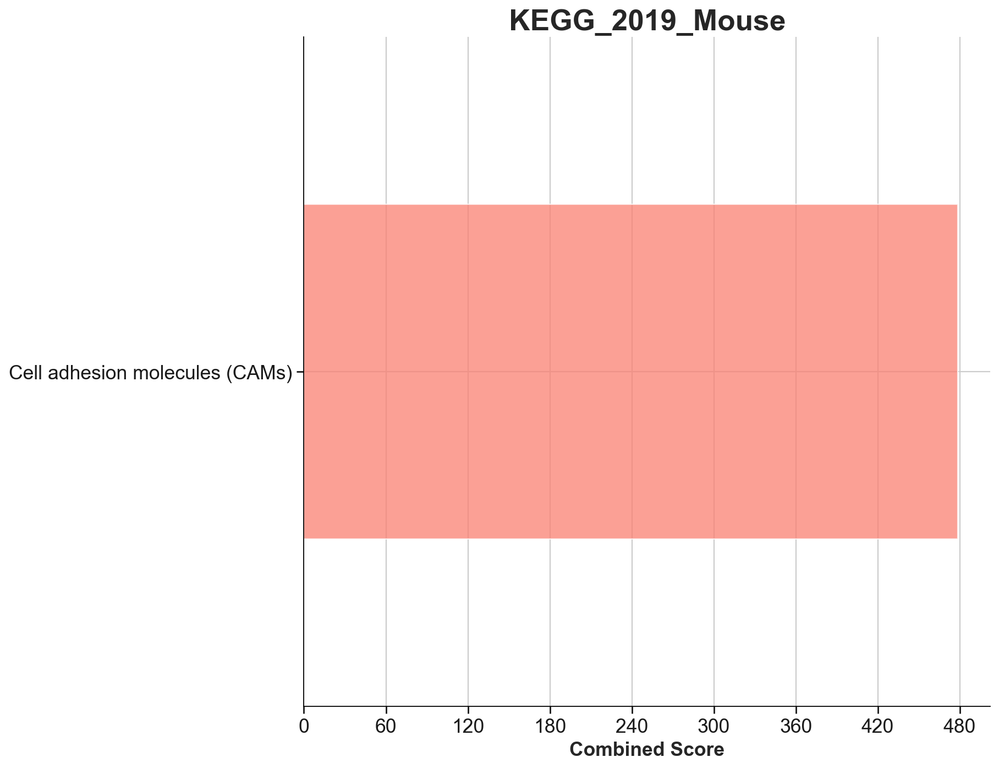

In [121]:
gseapy.barplot(significant_terms, column='Combined Score', top_term=30, title='KEGG_2019_Mouse', figsize=(10,10), ofname='/store/Projects/pantovski/IL10/GSEA_and_GO_figures/Ambient_RNA_Cleaned/Old IL10 vs IL10ra Upregulated DGEs KEGG.png')

gseapy.barplot(significant_terms, top_term=30, column='Combined Score', title='KEGG_2019_Mouse', figsize=(10,10))

In [122]:
enr_res_Old_WIKI = gseapy.enrichr(gene_list=glist_Old, organism='Mouse', gene_sets=['WikiPathways_2019_Mouse'], description='pathway', cutoff = 0.05)

significant_terms = enr_res_Old_WIKI.res2d[enr_res_Old_WIKI.res2d['Adjusted P-value'] < 0.05]
significant_terms.to_csv("/store/Projects/pantovski/IL10/Combined/write/Ambient_RNA_Cleaned/Old_IL10_vs_IL10ra_significantly_upregulated_DGEs_WIKI_005_terms_2_UMI_5_percent_Combat_raw_SingleR.csv")

/home/LULAB/pantovski/.conda/envs/general/lib/python3.8/site-packages/gseapy/enrichr.py:427: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  self.results = self.results.append(res, ignore_index=True)
2022-05-05 13:11:59,273 Warning: No enrich terms using library WikiPathways_2019_Mouse when cutoff = 0.05


In [123]:
significant_terms.shape

(0, 10)

In [124]:
gseapy.barplot(significant_terms, column='Combined Score', top_term=30, title='WikiPathways_2019_Mouse', figsize=(10,10), ofname='/store/Projects/pantovski/IL10/GSEA_and_GO_figures/Ambient_RNA_Cleaned/Old IL10 vs IL10ra Upregulated DGEs WIKI.png')

gseapy.barplot(significant_terms, top_term=30, column='Combined Score', title='WikiPathways_2019_Mouse', figsize=(10,10))

TypeError: no numeric data to plot

In [125]:
glist_Old = sc.get.rank_genes_groups_df(Old_HSC, group='IL10_Old', key='wilcoxon_bonferroni_Old_IL10_vs_IL10ra_Old', pval_cutoff=0.05, log2fc_max=-0.000000000001)['names'].squeeze().str.strip().tolist()

enr_res_Old_process = gseapy.enrichr(gene_list=glist_Old, organism='Mouse', gene_sets=['GO_Biological_Process_2021'], description='pathway', cutoff = 0.05)

significant_terms = enr_res_Old_process.res2d[enr_res_Old_process.res2d['Adjusted P-value'] < 0.05]
significant_terms.to_csv("/store/Projects/pantovski/IL10/Combined/write/Ambient_RNA_Cleaned/Old_IL10_vs_IL10ra_significantly_downregulated_DGEs_GO_BP_005_terms_2_UMI_5_percent_Combat_raw_SingleR.csv")

Exception: Error analyzing gene list

In [ ]:
significant_terms.shape

In [126]:
sc.settings.set_figure_params(dpi=80, facecolor='white')

gseapy.barplot(significant_terms, column='Combined Score', top_term=30, title='GO_Biological_Process', figsize=(10,10), ofname='/store/Projects/pantovski/IL10/GSEA_and_GO_figures/Ambient_RNA_Cleaned/Old IL10 vs IL10ra Downregulated DGEs GO BP.png')

gseapy.barplot(significant_terms, column='Combined Score', top_term=30, title='GO_Biological_Process', figsize=(10,10))

TypeError: no numeric data to plot

In [ ]:
enr_res_Old_function = gseapy.enrichr(gene_list=glist_Old, organism='Mouse', gene_sets=['GO_Molecular_Function_2021'], description='pathway', cutoff = 0.05)

significant_terms = enr_res_Old_function.res2d[enr_res_Old_function.res2d['Adjusted P-value'] < 0.05]
significant_terms.to_csv("/store/Projects/pantovski/IL10/Combined/write/Ambient_RNA_Cleaned/Old_IL10_vs_IL10ra_significantly_downregulated_DGEs_GO_MF_005_terms_2_UMI_5_percent_Combat_raw_SingleR.csv")

In [ ]:
significant_terms.shape

In [ ]:
gseapy.barplot(significant_terms, column='Combined Score', top_term=30, title='GO_Molecular_Function', figsize=(10,10), ofname='/store/Projects/pantovski/IL10/GSEA_and_GO_figures/Ambient_RNA_Cleaned/Old IL10 vs IL10ra Downregulated DGEs GO MF.png')

gseapy.barplot(significant_terms, top_term=30, column='Combined Score', title='GO_Molecular_Function', figsize=(10,10))

In [ ]:
enr_res_Old_cell_component = gseapy.enrichr(gene_list=glist_Old, organism='Mouse', gene_sets=['GO_Cellular_Component_2021'], description='pathway', cutoff = 0.05)

significant_terms = enr_res_Old_cell_component.res2d[enr_res_Old_cell_component.res2d['Adjusted P-value'] < 0.05]
significant_terms.to_csv("/store/Projects/pantovski/IL10/Combined/write/Ambient_RNA_Cleaned/Old_IL10_vs_IL10ra_significantly_downregulated_DGEs_GO_CC_005_terms_2_UMI_5_percent_Combat_raw_SingleR.csv")

In [ ]:
significant_terms.shape

In [ ]:
gseapy.barplot(significant_terms, column='Combined Score', top_term=30, title='GO_Cellular_Component_2021', figsize=(10,10), ofname='/store/Projects/pantovski/IL10/GSEA_and_GO_figures/Ambient_RNA_Cleaned/Old IL10 vs IL10ra Downregulated DGEs GO CC.png')

gseapy.barplot(significant_terms, top_term=30, column='Combined Score', title='GO_Cellular_Component_2021', figsize=(10,10))

In [ ]:
enr_res_Old_KEGG = gseapy.enrichr(gene_list=glist_Old, organism='Mouse', gene_sets=['KEGG_2019_Mouse'], description='pathway', cutoff = 0.05)

significant_terms = enr_res_Old_KEGG.res2d[enr_res_Old_KEGG.res2d['Adjusted P-value'] < 0.05]
significant_terms.to_csv("/store/Projects/pantovski/IL10/Combined/write/Ambient_RNA_Cleaned/Old_IL10_vs_IL10ra_significantly_downregulated_DGEs_KEGG_005_terms_2_UMI_5_percent_Combat_raw_SingleR.csv")

In [ ]:
significant_terms.shape

In [ ]:
gseapy.barplot(significant_terms, column='Combined Score', top_term=30, title='KEGG_2019_Mouse', figsize=(10,10), ofname='/store/Projects/pantovski/IL10/GSEA_and_GO_figures/Ambient_RNA_Cleaned/Old IL10 vs IL10ra Downregulated DGEs KEGG.png')

gseapy.barplot(significant_terms, top_term=30, column='Combined Score', title='KEGG_2019_Mouse', figsize=(10,10))

In [ ]:
enr_res_Old_WIKI = gseapy.enrichr(gene_list=glist_Old, organism='Mouse', gene_sets=['WikiPathways_2019_Mouse'], description='pathway', cutoff = 0.05)

significant_terms = enr_res_Old_WIKI.res2d[enr_res_Old_WIKI.res2d['Adjusted P-value'] < 0.05]
significant_terms.to_csv("/store/Projects/pantovski/IL10/Combined/write/Ambient_RNA_Cleaned/Old_IL10_vs_IL10ra_significantly_downregulated_DGEs_WIKI_005_terms_2_UMI_5_percent_Combat_raw_SingleR.csv")

In [ ]:
significant_terms.shape

In [ ]:
gseapy.barplot(significant_terms, column='Combined Score', top_term=30, title='WikiPathways_2019_Mouse', figsize=(10,10), ofname='/store/Projects/pantovski/IL10/GSEA_and_GO_figures/Ambient_RNA_Cleaned/Old IL10 vs IL10ra Downregulated DGEs WIKI.png')

gseapy.barplot(significant_terms, top_term=30, column='Combined Score', title='WikiPathways_2019_Mouse', figsize=(10,10))